# Mask R-CNN Demo

A quick intro to using the pre-trained model to detect and segment objects.

In [1]:
import os
import sys
import scipy
import random
import math
import numpy as np
import skimage.io
import matplotlib
import matplotlib.pyplot as plt
import datetime



import cv2
%matplotlib inline

# Root directory of the project
ROOT_DIR = os.path.abspath("../")

# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library
from mrcnn.config import Config
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize
# Import COCO config
#sys.path.append(os.path.join(ROOT_DIR, "samples/balloon/"))  # To find local version
BLISTER_DIR = os.path.join(ROOT_DIR, "datasets/blister")

import coco

from samples.blister import blister_mul_class

%matplotlib inline 

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Local path to trained weights file
COCO_MODEL_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")
BLISTER_MODEL_PATH = "../mask_rcnn_blister_real_0050.h5"

# Download COCO trained weights from Releases if needed
if not os.path.exists(COCO_MODEL_PATH):
    utils.download_trained_weights(COCO_MODEL_PATH)

# Directory of images to run detection on
IMAGE_DIR = os.path.join(ROOT_DIR, "images")

# ROS packages
import rospy
import geometry_msgs.msg
import time
import roslib; roslib.load_manifest('ur_driver')
import actionlib
from std_msgs.msg import String
# ROS Image message
from sensor_msgs.msg import Image
from thin_obj_bin_picking.msg import blister_pose
# ROS Image message -> OpenCV2 image converter
from cv_bridge import CvBridge, CvBridgeError
#import tf

Using TensorFlow backend.


## Configurations

We'll be using a model trained on the MS-COCO dataset. The configurations of this model are in the ```CocoConfig``` class in ```coco.py```.

For inferencing, modify the configurations a bit to fit the task. To do so, sub-class the ```CocoConfig``` class and override the attributes you need to change.

In [2]:
class InferenceConfig(blister_mul_class.BlisterConfig):
    # Set batch size to 1 since we'll be running inference on
    # one image at a time. Batch size = GPU_COUNT * IMAGES_PER_GPU
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

config = InferenceConfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.9
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                15
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE         

## Create Model and Load Trained Weights

In [3]:
# Create model object in inference mode.
model = modellib.MaskRCNN(mode="inference", model_dir=MODEL_DIR, config=config)

# Load weights trained on MS-COCO
model.load_weights(BLISTER_MODEL_PATH, by_name=True)

In [4]:
# Load dataset
# Get the dataset from the releases page
# https://github.com/matterport/Mask_RCNN/releases
dataset = blister_mul_class.BlisterDataset()
dataset.load_blister(BLISTER_DIR, "train")

# Must call before using the dataset
dataset.prepare()

print("Image Count: {}".format(len(dataset.image_ids)))
print("Class Count: {}".format(dataset.num_classes))
for i, info in enumerate(dataset.class_info):
    print("{:3}. {:50}".format(i, info['name']))
    
#image_ids = np.random.choice(dataset.image_ids, 4)
#for image_id in image_ids:
#    mask, class_ids = dataset.load_mask(image_id)
    
#print(dataset.class_names)
#print(dataset.image_ids)

Image Count: 249
Class Count: 3
  0. BG                                                
  1. head                                              
  2. tail                                              


## Class Names

The model classifies objects and returns class IDs, which are integer value that identify each class. Some datasets assign integer values to their classes and some don't. For example, in the MS-COCO dataset, the 'person' class is 1 and 'teddy bear' is 88. The IDs are often sequential, but not always. The COCO dataset, for example, has classes associated with class IDs 70 and 72, but not 71.

To improve consistency, and to support training on data from multiple sources at the same time, our ```Dataset``` class assigns it's own sequential integer IDs to each class. For example, if you load the COCO dataset using our ```Dataset``` class, the 'person' class would get class ID = 1 (just like COCO) and the 'teddy bear' class is 78 (different from COCO). Keep that in mind when mapping class IDs to class names.

To get the list of class names, you'd load the dataset and then use the ```class_names``` property like this.
```
# Load COCO dataset
dataset = coco.CocoDataset()
dataset.load_coco(COCO_DIR, "train")
dataset.prepare()

# Print class names
print(dataset.class_names)
```

We don't want to require you to download the COCO dataset just to run this demo, so we're including the list of class names below. The index of the class name in the list represent its ID (first class is 0, second is 1, third is 2, ...etc.)

In [5]:
class_names = dataset.class_names

## Run Object Detection

In [6]:
# Rank the mask areas, output the maximum area
def max_area(area):
    area_max = 0
    index = 0
    for i, a in enumerate(area):
        if(a > area_max):
            area_max = a
            index = i
    return area_max, index

In [7]:
# Select the maximum area mask, output the mask and its corners
def mask_rank(img, mask):
    mask_int = mask.astype(np.uint8)
    area = np.zeros([mask_int.shape[2]], dtype=np.int)
    boxx = np.zeros([4, 2, mask_int.shape[2]], dtype = np.float)
    img_copy = img.copy()
    for i in range(mask_int.shape[2]):        
        mask_copy = mask_int[:,:,i].copy()
        plt.imshow(mask_copy)
        plt.show()
        area[i] = mask_copy.sum()
        print(area[i])
    
    mmax, index = max_area(area)
    im2,contours,hierarchy = cv2.findContours(mask_int[:,:,index].copy(), 1, 2)
    cnt = contours[0]     
    for j in range(len(contours)):
        if(len(contours[j]) > len(cnt)):
            cnt = contours[j]
    hull = cv2.convexHull(cnt,returnPoints = True)
    rect = cv2.minAreaRect(hull)
    box = cv2.boxPoints(rect)
    box = np.int0(box)
    cv2.drawContours(img_copy,[box],0,(0,0,255),2)
    plt.imshow(img_copy)
    plt.show()
    print(box)
    return mask_int[:,:,index].copy(), box

In [8]:
# Compute position of mask center and rotation of mask
def get_mask_pose(max_boxx):
    position = (max_boxx[0] + max_boxx[2]) / 2
    # Counterclockwise is positive direction
    if(np.linalg.norm(max_boxx[0]-max_boxx[1]) > np.linalg.norm(max_boxx[1]-max_boxx[2])):
        rotation = math.atan2((max_boxx[2]-max_boxx[1])[1], (max_boxx[2]-max_boxx[1])[0])
        print("rotation 111")
    else:
        rotation = math.atan2((max_boxx[1]-max_boxx[0])[1], (max_boxx[1]-max_boxx[0])[0])
        print("rotation 222")
    pose={
        'x':position[0],
        'y':position[1],
        'rz':rotation
    }
    return pose

In [9]:
is_detect = 0
img_index = 0
def img_index_callback(data):
    global img_index
    global is_detect
    
    print(data.data)
    img_index = data.data
    is_detect = 1


In [10]:
rospy.init_node('img_segmentation')
rospy.Subscriber('/blister_img_index', String, img_index_callback)

0
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8


/home/qxuaj/anaconda3/envs/tf_gpu/lib/python3.6/site-packages/ipykernel_launcher.py:11: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  # This is added back by InteractiveShellApp.init_path()


molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


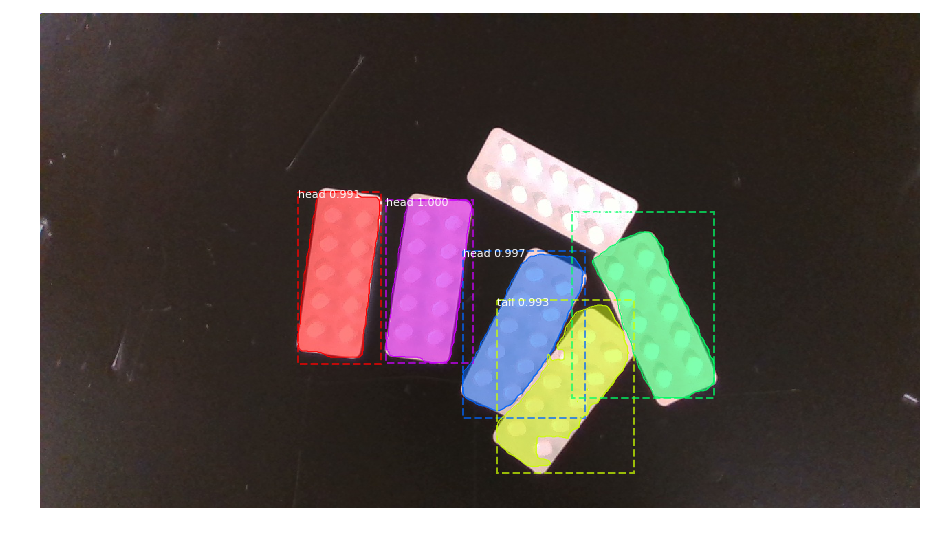

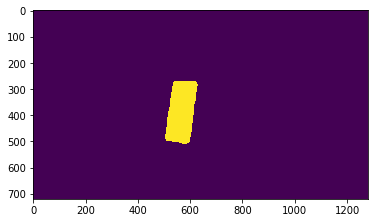

22279


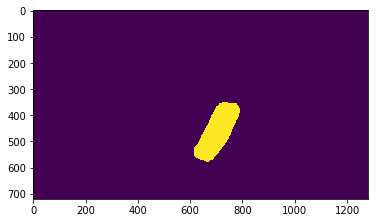

21567


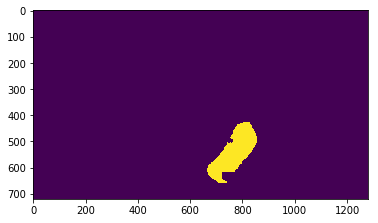

20678


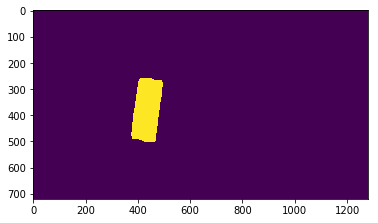

22379


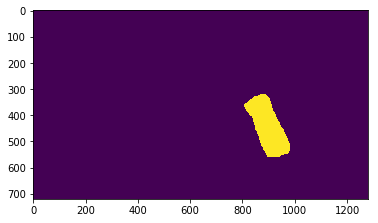

22938


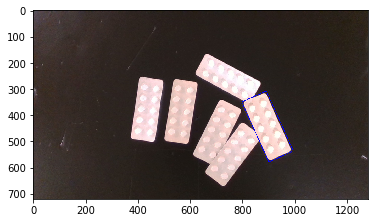

[[901 579]
 [797 350]
 [891 308]
 [994 536]]


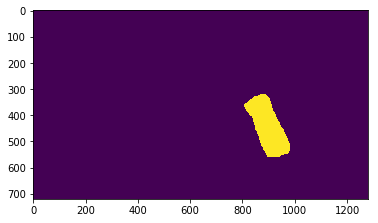

rotation 111
pose_xy: 896.0 443.5
-24.075498255078838
0.06650879999999999   -0.16380389999999997
0
Processing 1 images
image                    shape: (720, 1280, 3)        min:    3.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


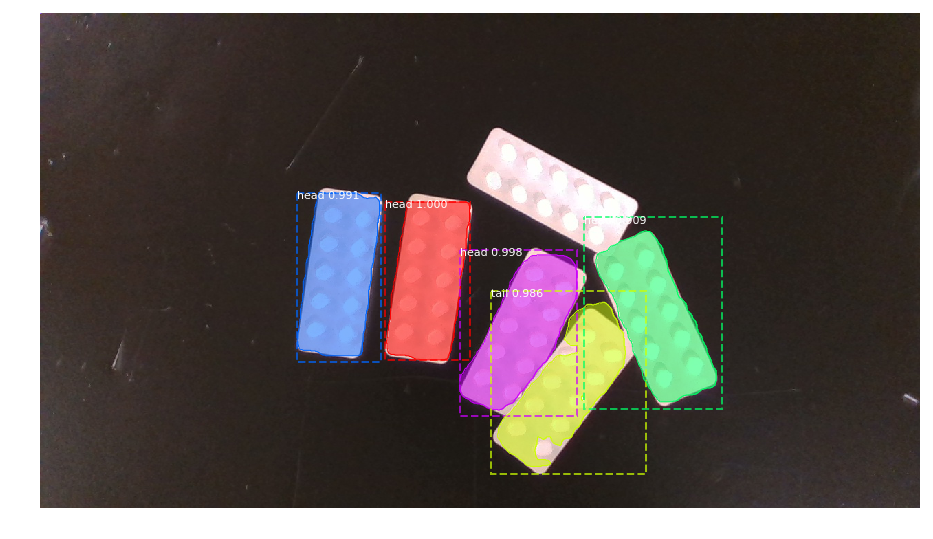

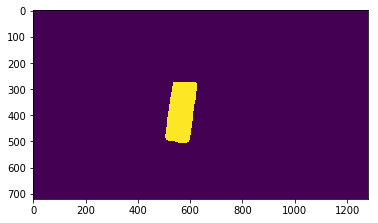

21603


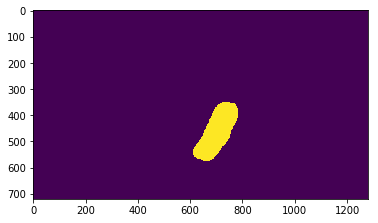

21204


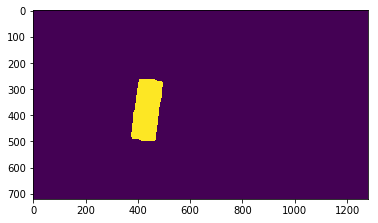

22082


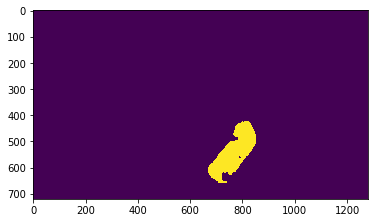

20311


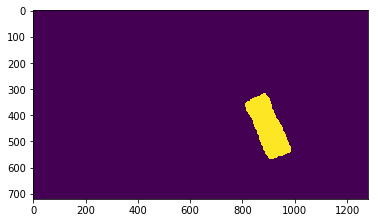

23006


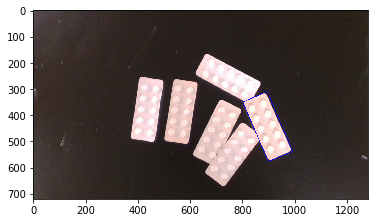

[[899 577]
 [801 350]
 [894 310]
 [992 537]]


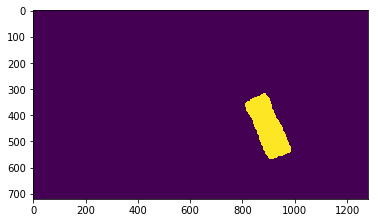

rotation 111
pose_xy: 896.5 443.5
-23.27290406408198
0.0666387   -0.16380389999999997
1
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


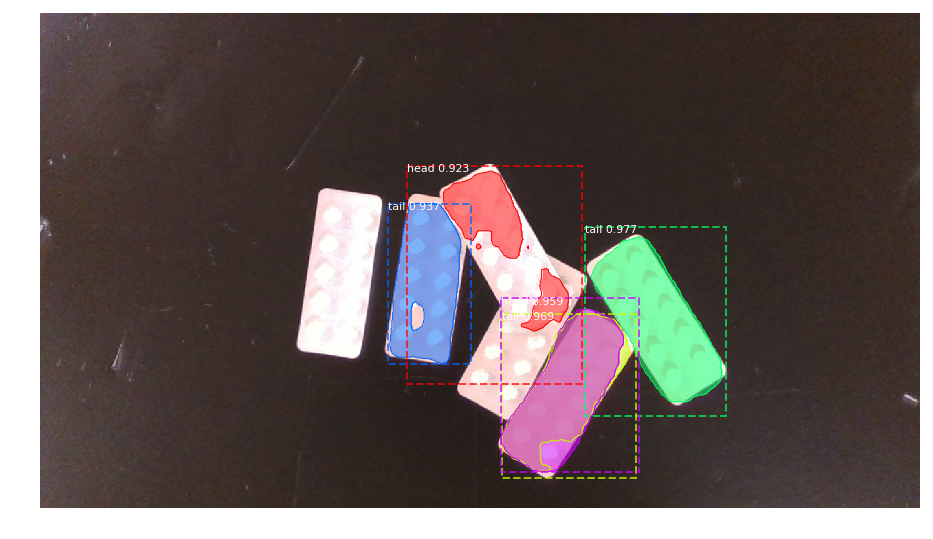

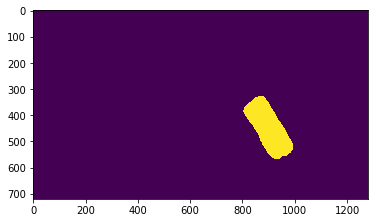

23777


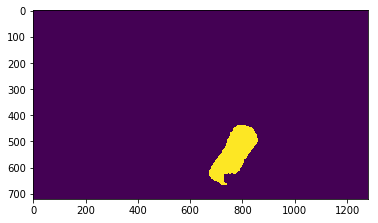

21151


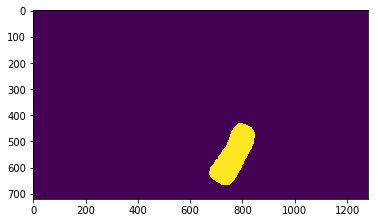

22466


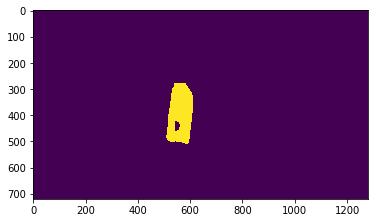

18129


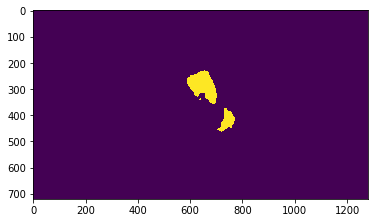

11950


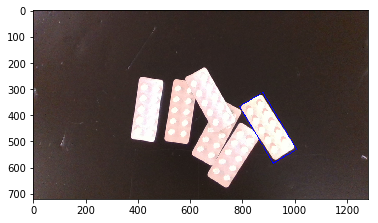

[[ 918  583]
 [ 789  367]
 [ 878  313]
 [1007  530]]


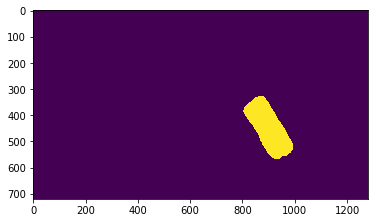

rotation 111
pose_xy: 898.0 448.0
-31.246929413476952
0.06702839999999999   -0.1626348
2
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


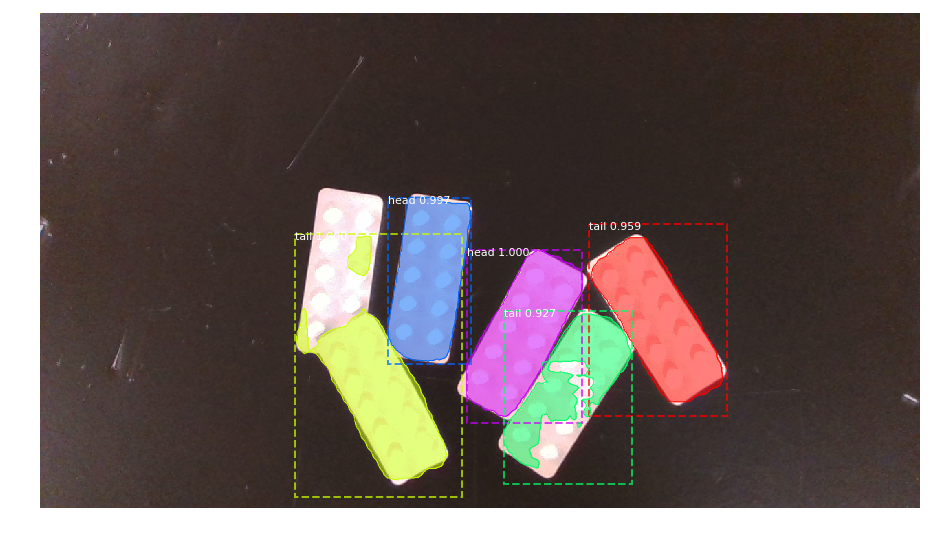

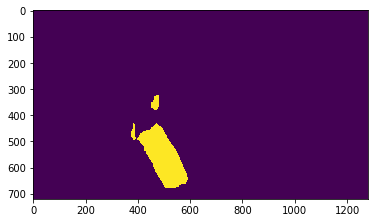

26555


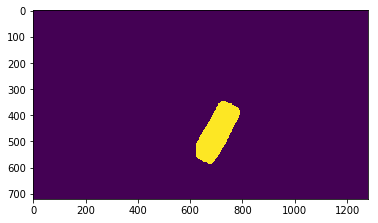

22053


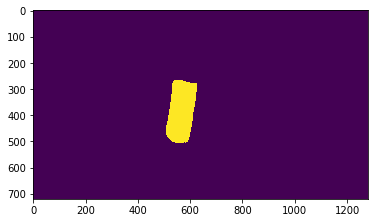

21339


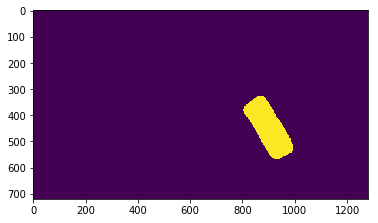

23628


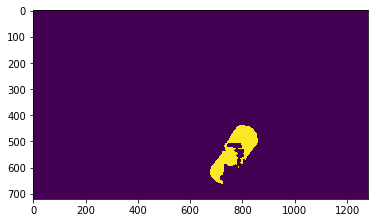

15737


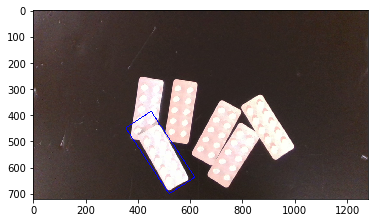

[[520 700]
 [354 449]
 [451 385]
 [618 636]]


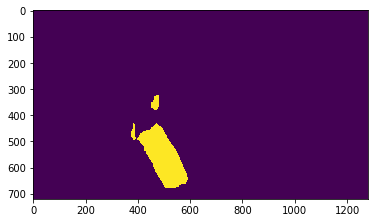

rotation 111
pose_xy: 485.5 542.5
-33.41658139531293
-0.0401391   -0.1380837
3
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


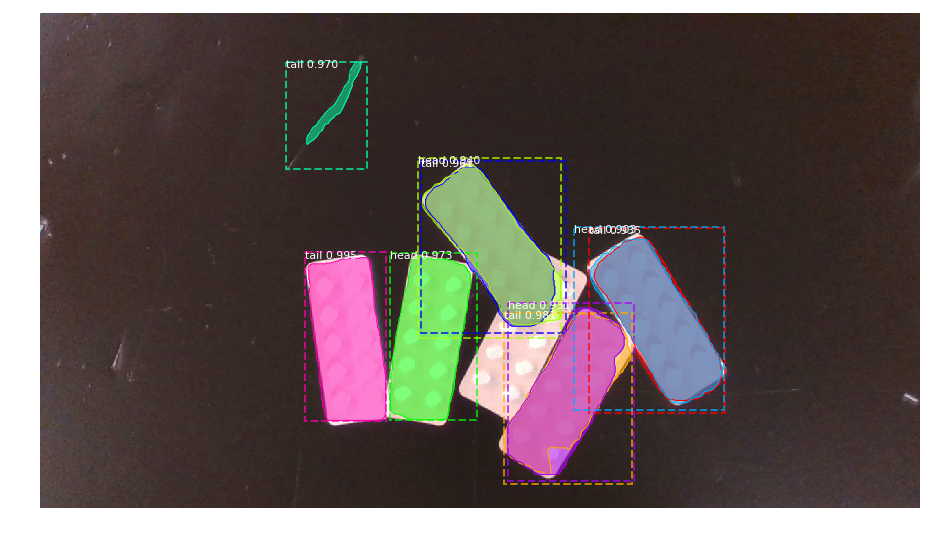

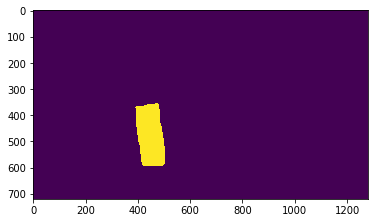

21708


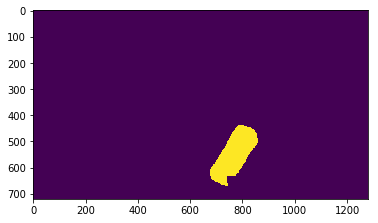

21812


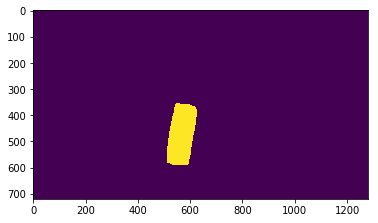

21002


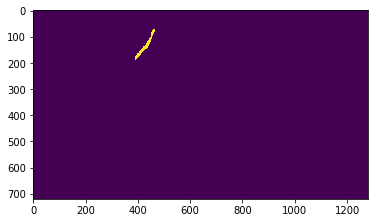

1520


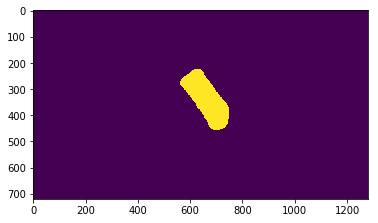

22407


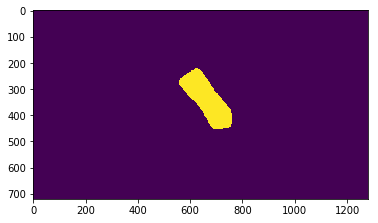

22683


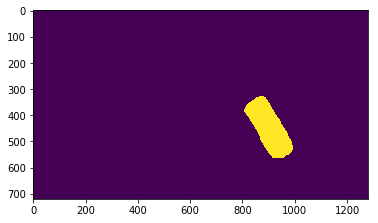

23280


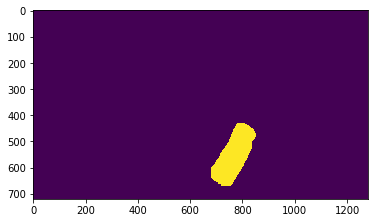

22512


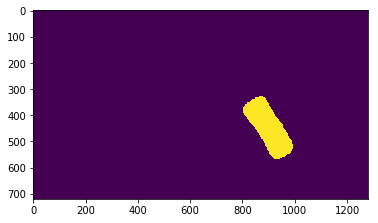

23055


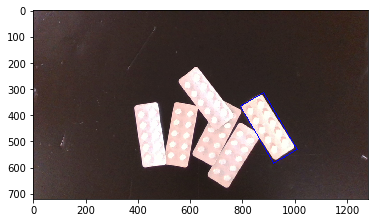

[[ 919  583]
 [ 792  366]
 [ 881  314]
 [1009  531]]


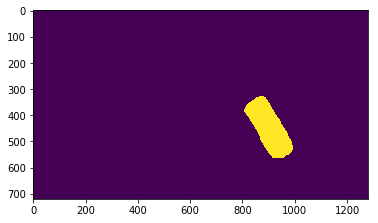

rotation 111
pose_xy: 900.0 448.5
-30.29644817623844
0.06754799999999998   -0.1625049
4
Processing 1 images
image                    shape: (720, 1280, 3)        min:    7.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


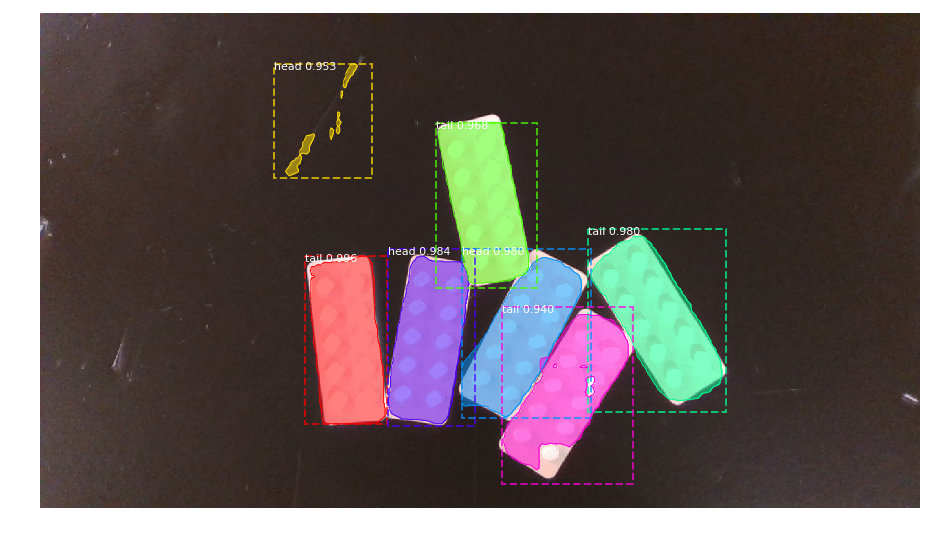

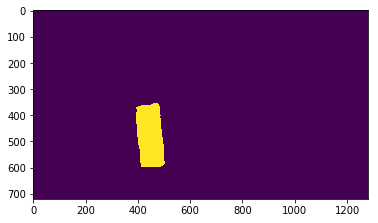

21915


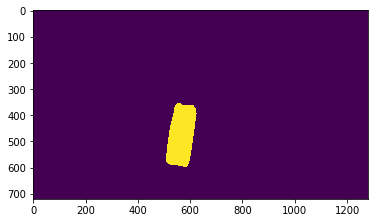

21126


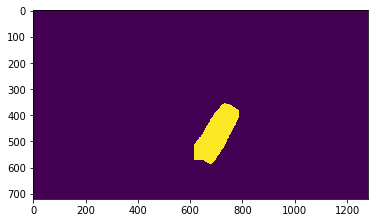

21481


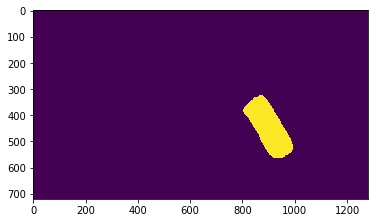

23798


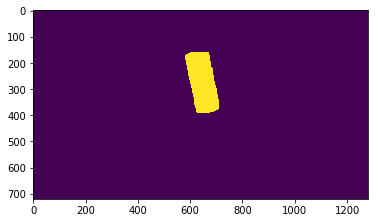

21595


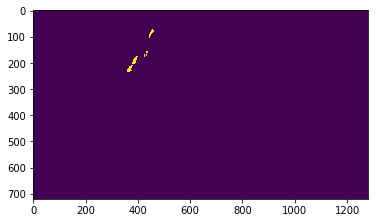

1098


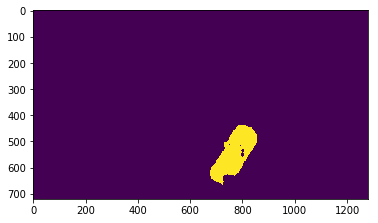

20474


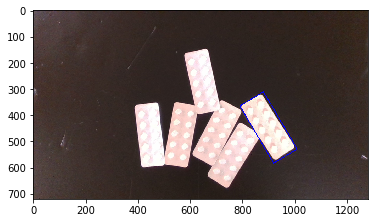

[[ 919  583]
 [ 790  365]
 [ 880  311]
 [1009  529]]


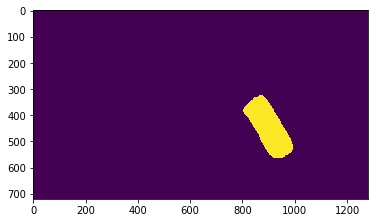

rotation 111
pose_xy: 899.5 447.0
-30.96375653207352
0.0674181   -0.1628946
5
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


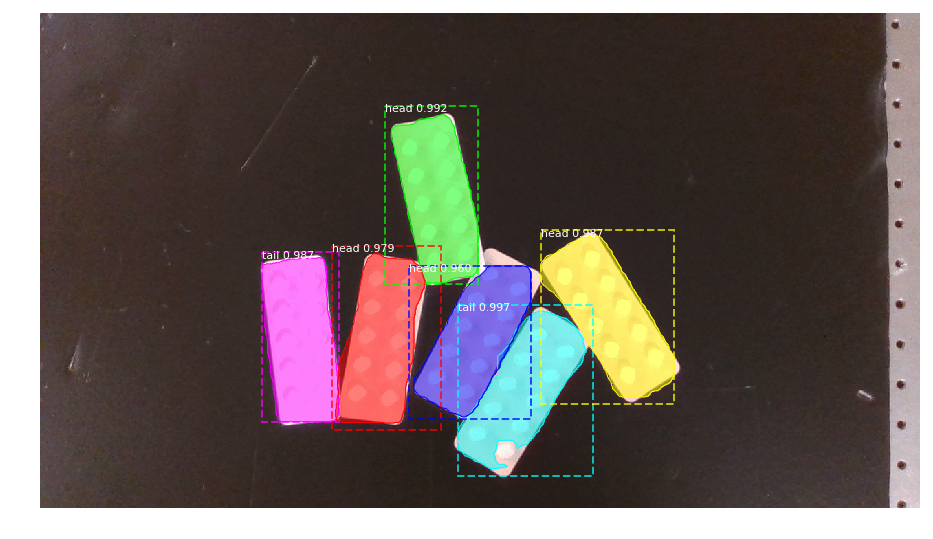

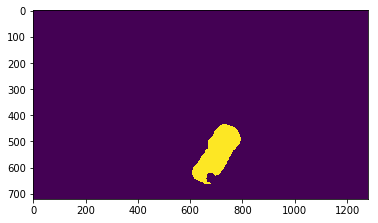

21441


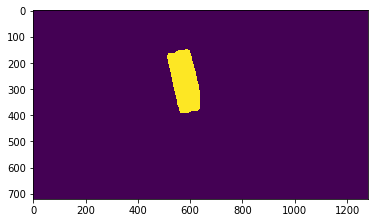

21456


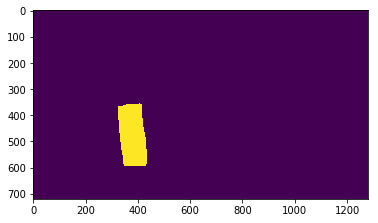

22054


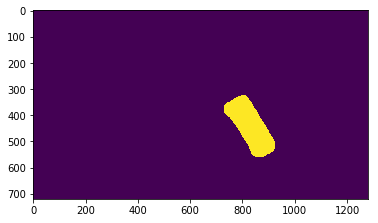

23765


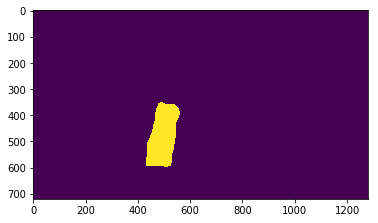

22507


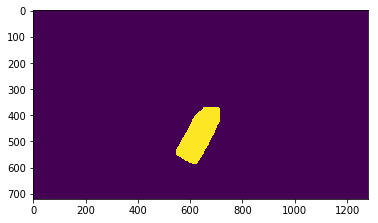

20937


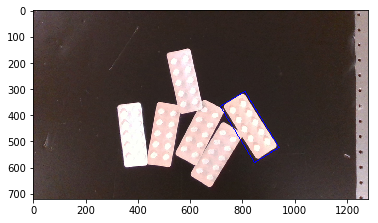

[[846 581]
 [715 367]
 [809 309]
 [940 523]]


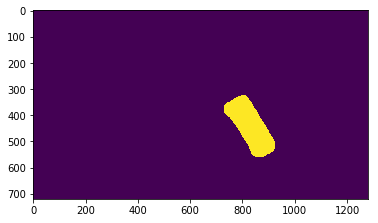

rotation 111
pose_xy: 827.5 445.0
-31.675468738109217
0.0487125   -0.1634142
6
Processing 1 images
image                    shape: (720, 1280, 3)        min:    3.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


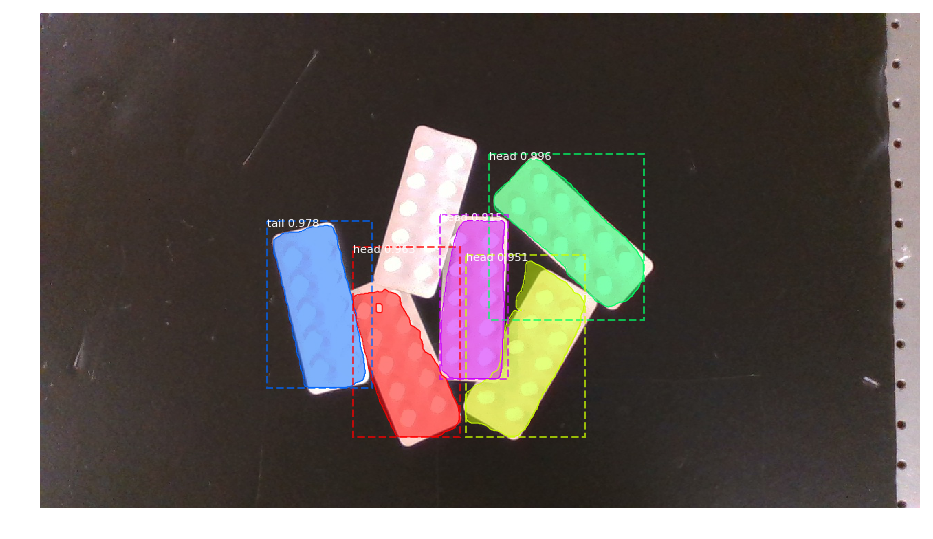

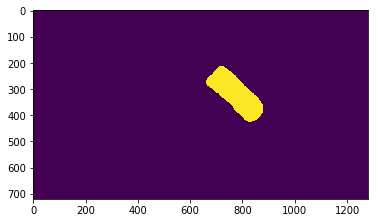

22101


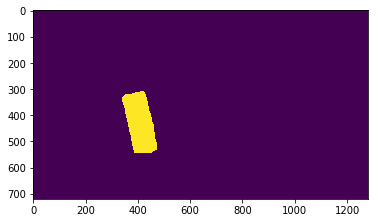

21409


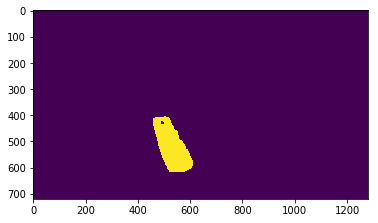

19068


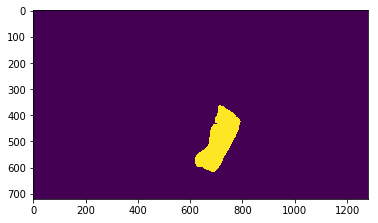

21751


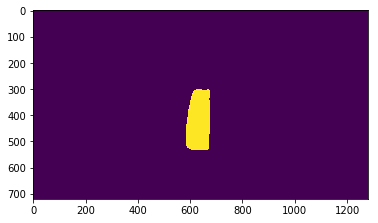

18833


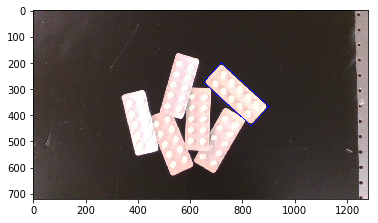

[[834 441]
 [651 275]
 [719 200]
 [902 366]]


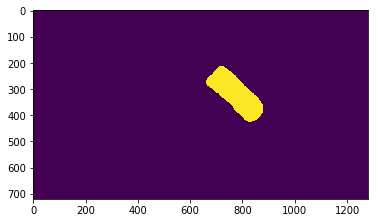

rotation 111
pose_xy: 776.5 320.5
-47.802451519866786
0.0354627   -0.19575929999999997
7
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


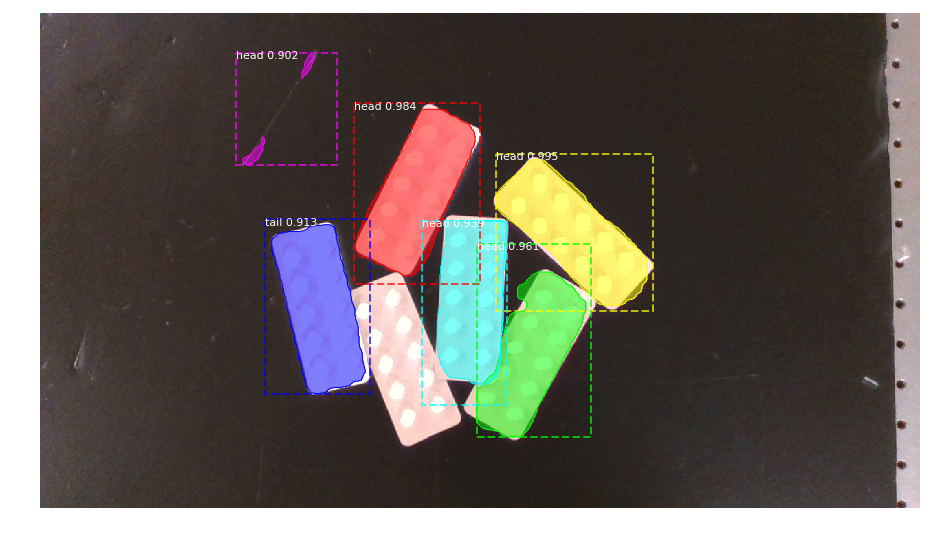

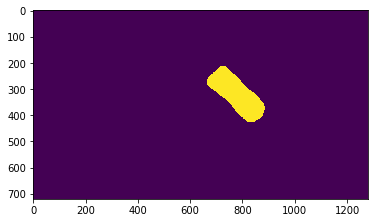

22743


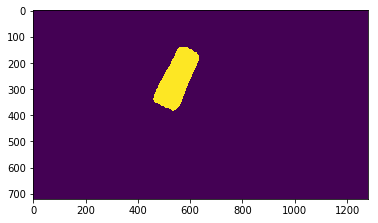

23168


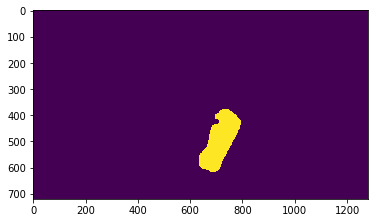

20975


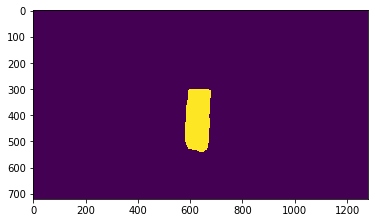

20815


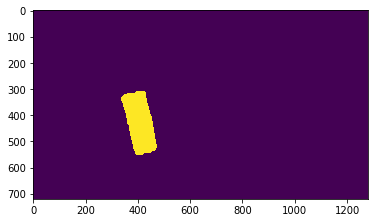

21673


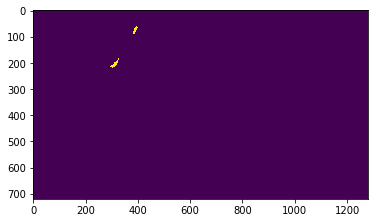

700


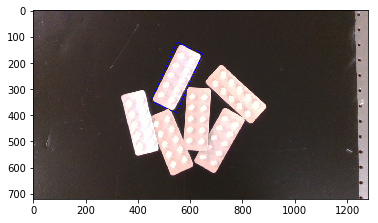

[[548 391]
 [450 347]
 [550 122]
 [648 166]]


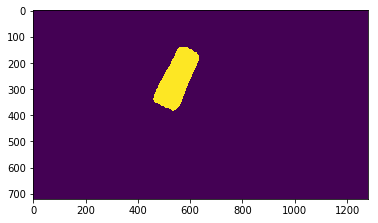

rotation 222
pose_xy: 549.0 256.5
-155.82089285331082
-0.023641799999999998   -0.21238649999999998
8
Processing 1 images
image                    shape: (720, 1280, 3)        min:    6.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


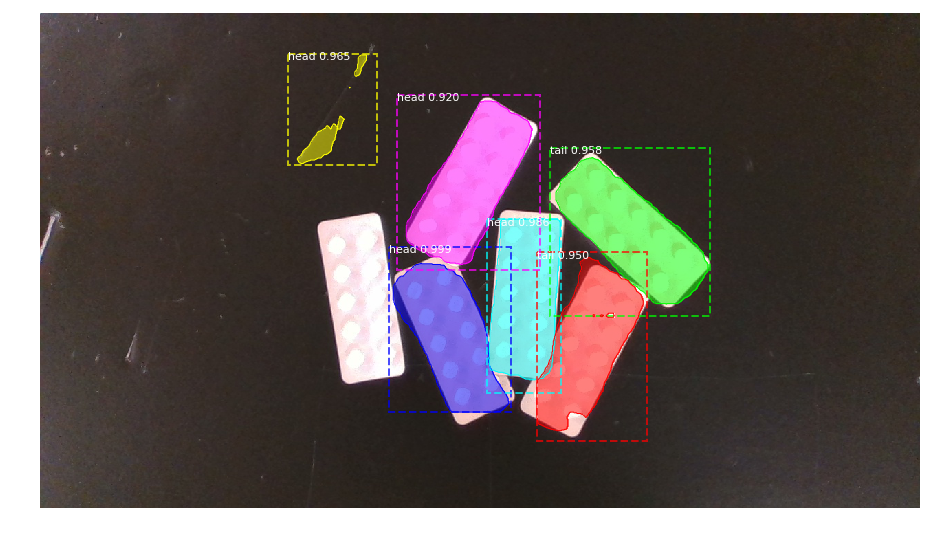

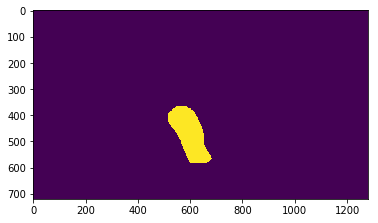

20661


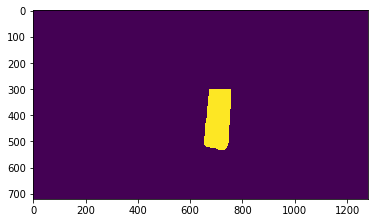

20471


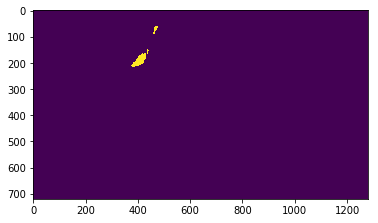

1935


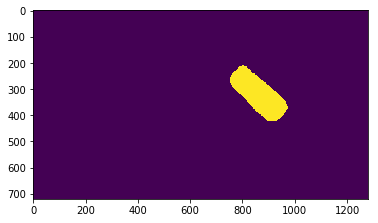

23542


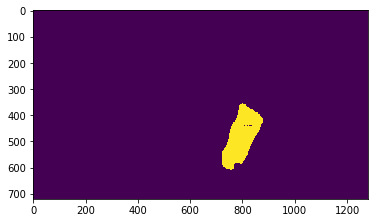

21170


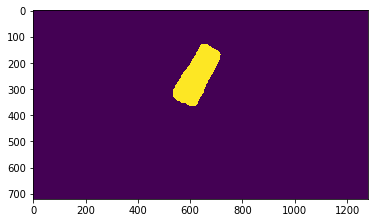

22857


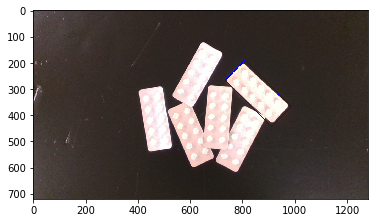

[[911 444]
 [734 267]
 [810 191]
 [987 368]]


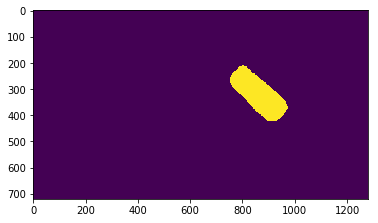

rotation 111
pose_xy: 860.5 317.5
-45.0
0.0572859   -0.19653869999999998
9
Processing 1 images
image                    shape: (720, 1280, 3)        min:    4.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


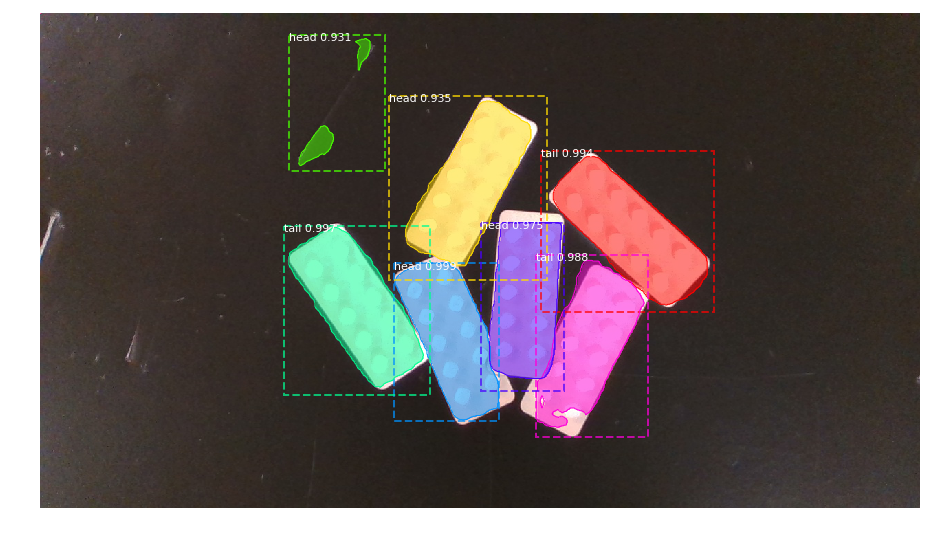

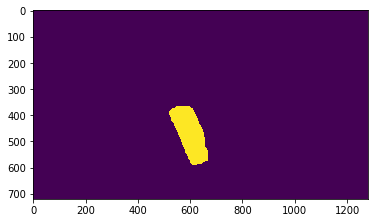

19772


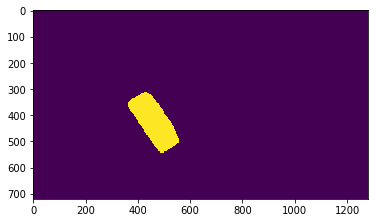

23145


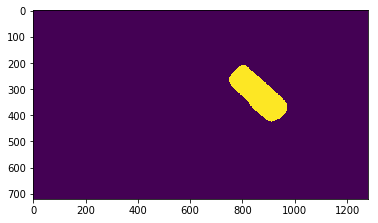

23991


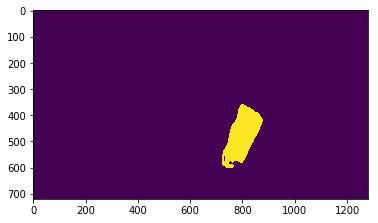

20773


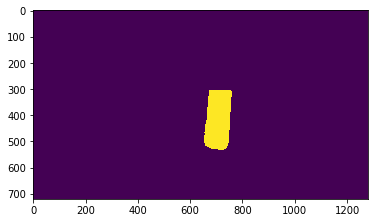

20273


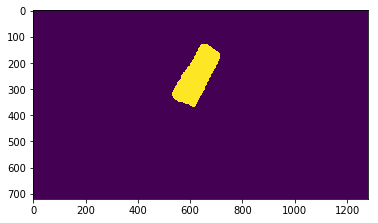

22460


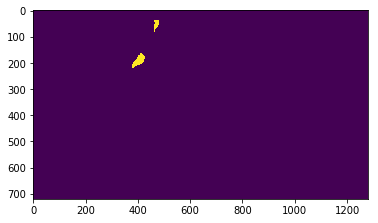

1931


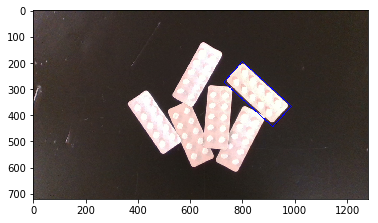

[[916 444]
 [729 274]
 [800 196]
 [987 366]]


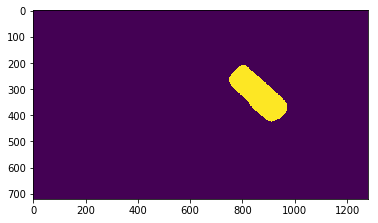

rotation 111
pose_xy: 858.0 320.0
-47.68977032315047
0.056636399999999996   -0.19588919999999999
10
Processing 1 images
image                    shape: (720, 1280, 3)        min:    7.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


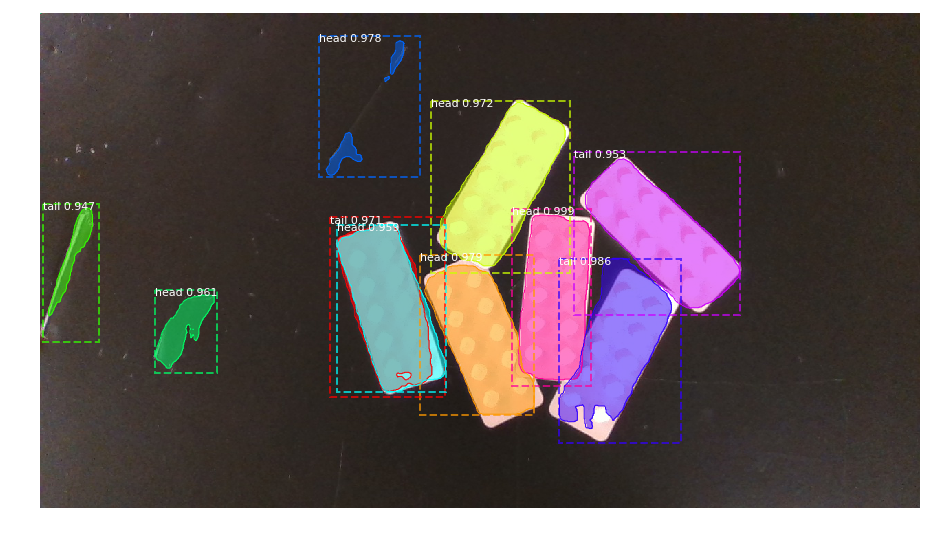

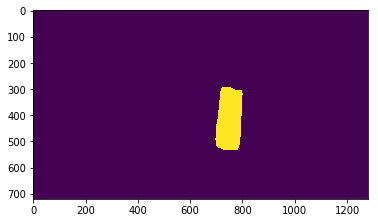

20827


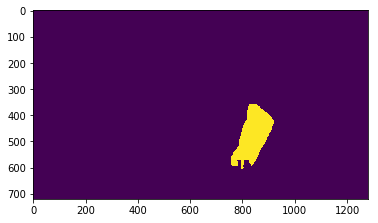

21336


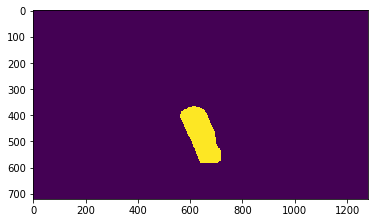

20550


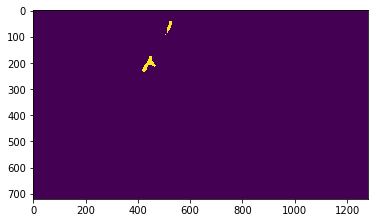

1702


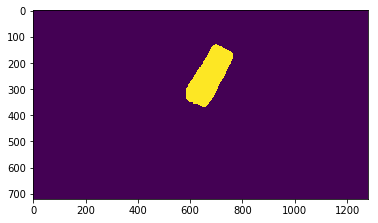

23079


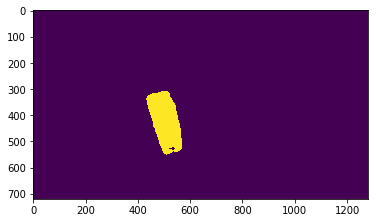

21729


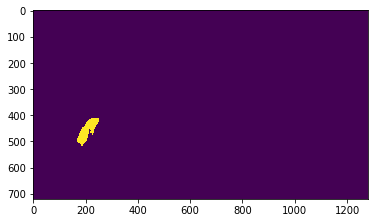

4078


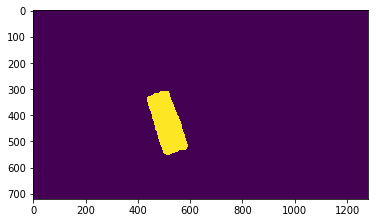

22475


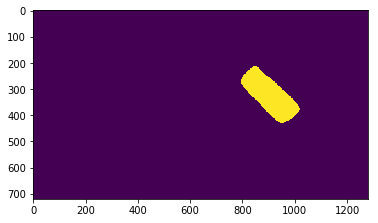

23630


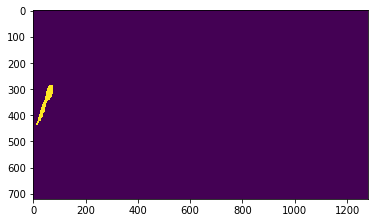

2538


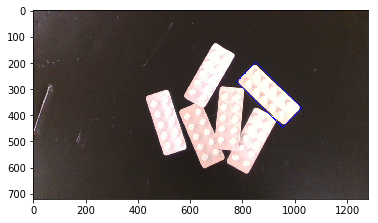

[[ 954  447]
 [ 778  272]
 [ 852  198]
 [1028  373]]


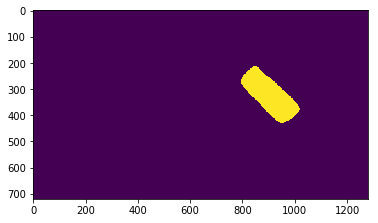

rotation 111
pose_xy: 903.0 322.5
-45.0
0.0683274   -0.1952397
11
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


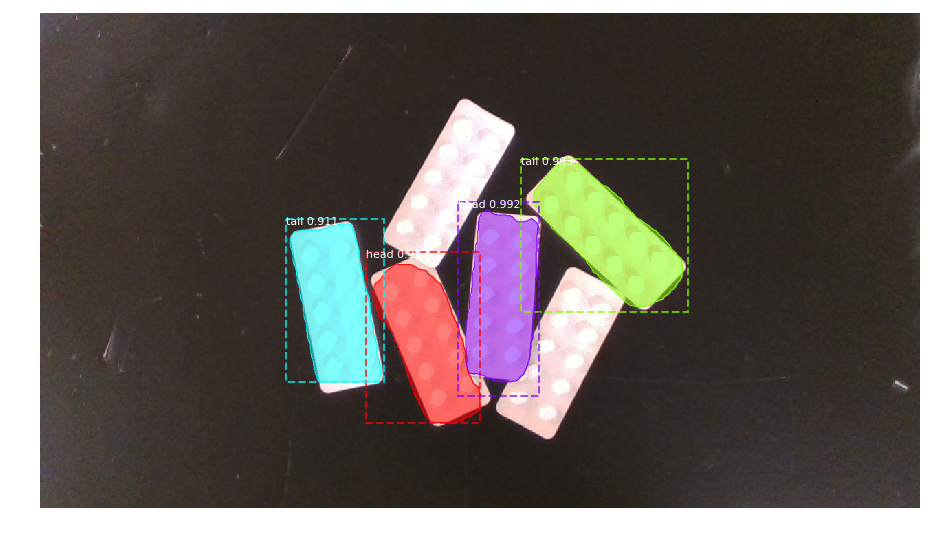

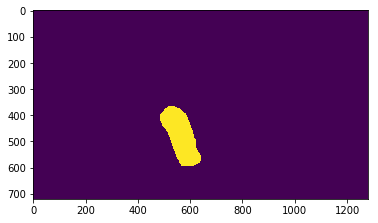

20757


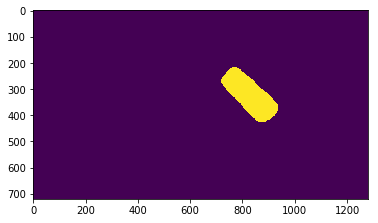

23085


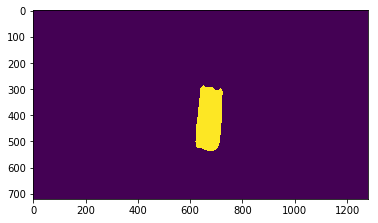

21450


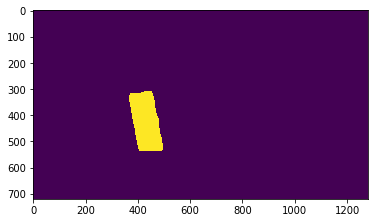

21463


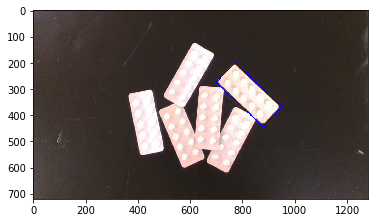

[[880 445]
 [699 276]
 [772 199]
 [952 368]]


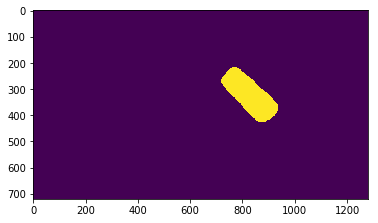

rotation 111
pose_xy: 826.0 322.0
-46.52752544221293
0.04832279999999999   -0.1953696
12
Processing 1 images
image                    shape: (720, 1280, 3)        min:    7.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


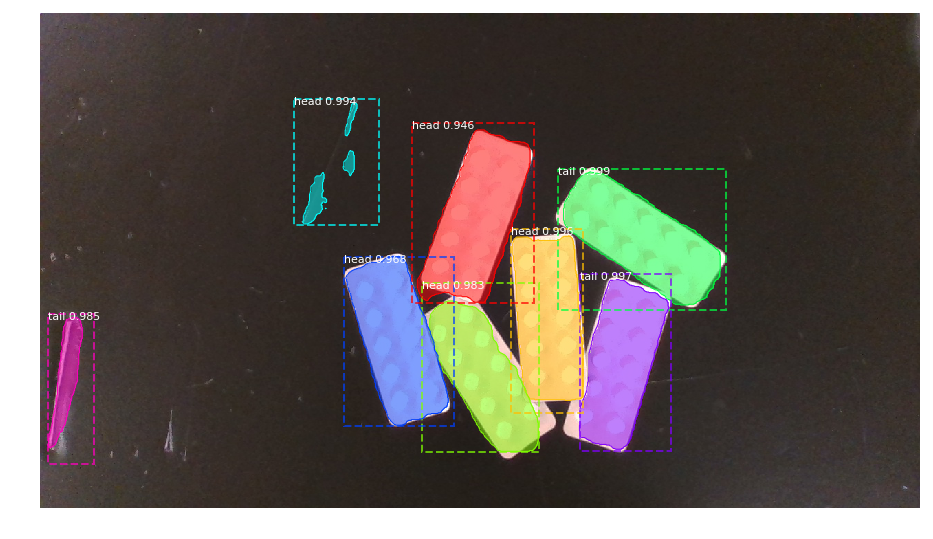

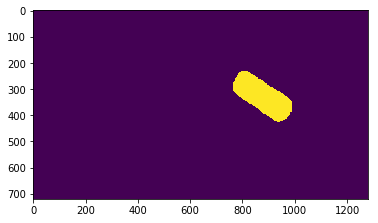

23541


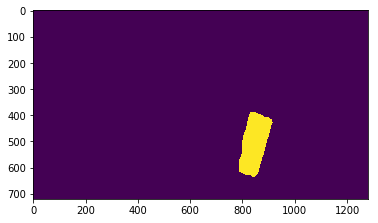

20148


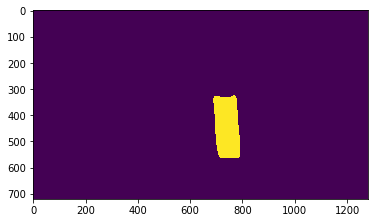

20801


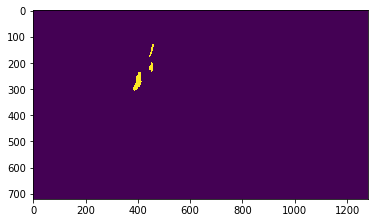

1933


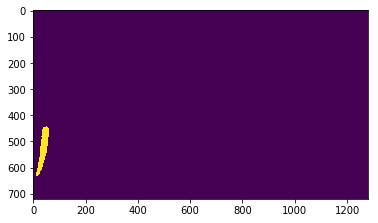

4258


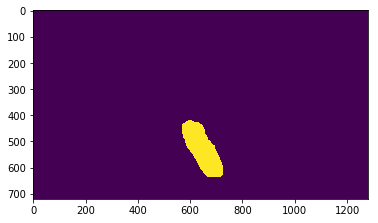

19027


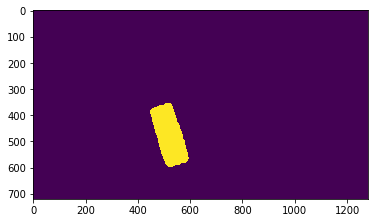

21969


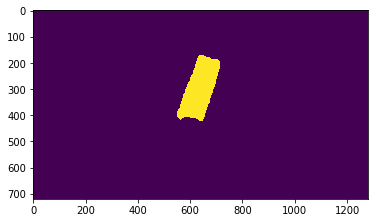

23946


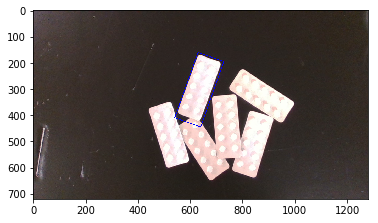

[[640 445]
 [541 410]
 [630 161]
 [729 196]]


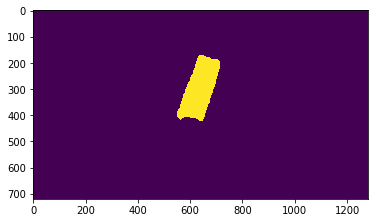

rotation 222
pose_xy: 635.0 303.0
-160.52969799053304
-0.001299   -0.20030579999999998
13
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


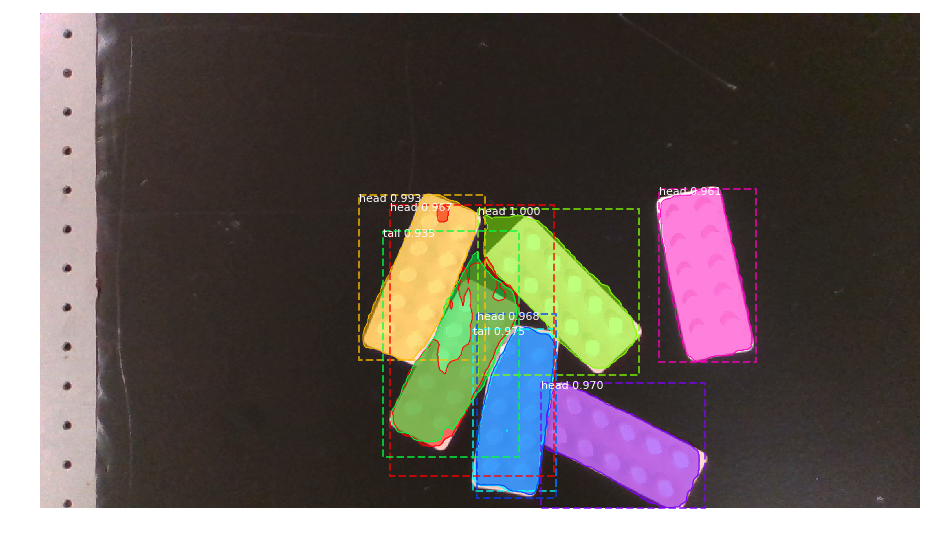

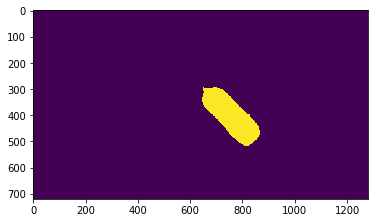

24771


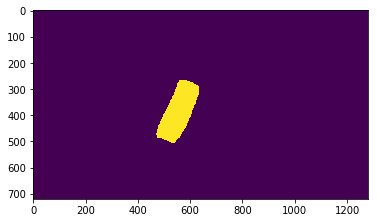

21838


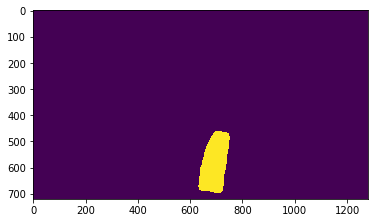

20120


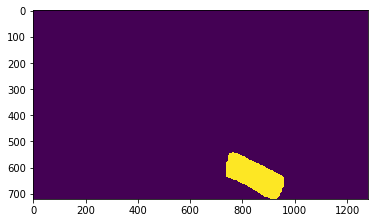

22313


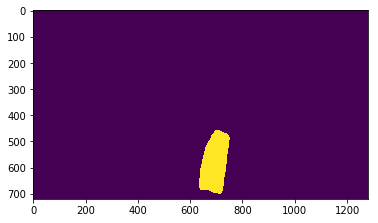

20198


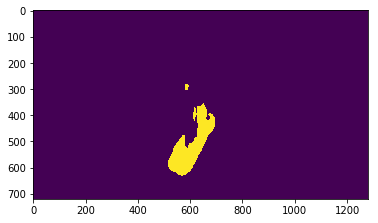

20416


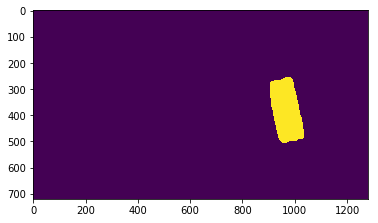

23705


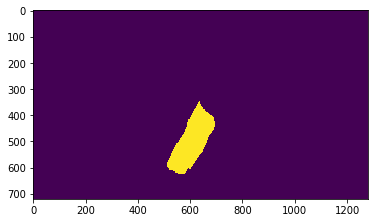

24281


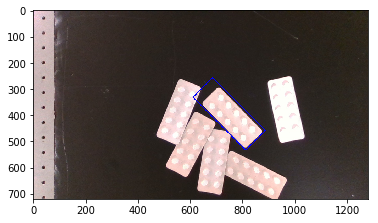

[[812 533]
 [611 332]
 [686 257]
 [887 458]]


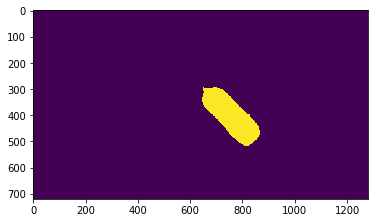

rotation 111
pose_xy: 749.0 395.0
-45.0
0.028318199999999998   -0.17640419999999998
14
Processing 1 images
image                    shape: (720, 1280, 3)        min:    7.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


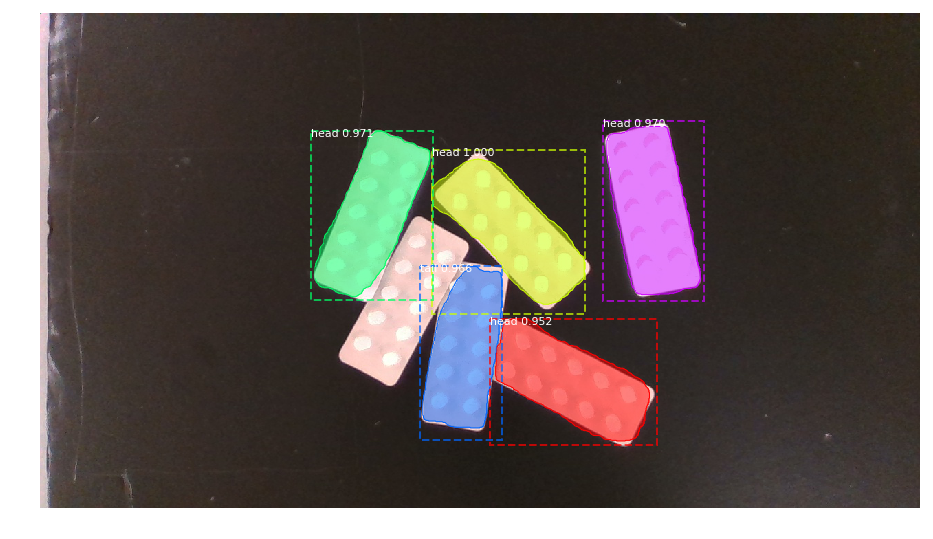

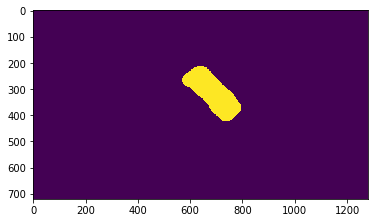

23222


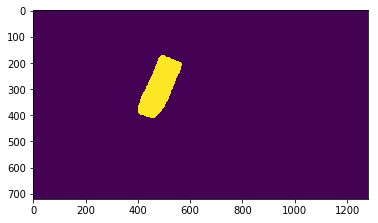

21816


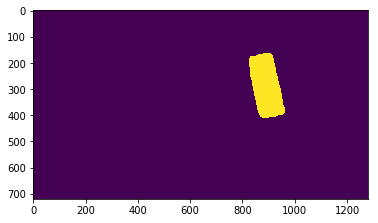

23964


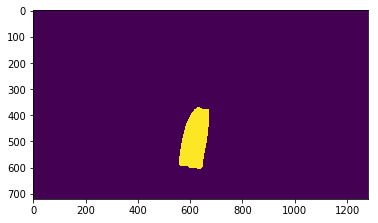

19659


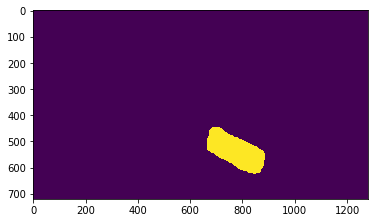

22733


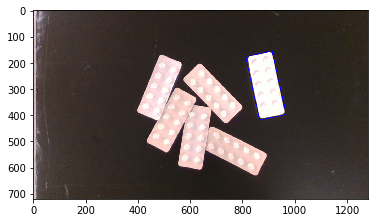

[[865 419]
 [812 177]
 [913 155]
 [967 397]]


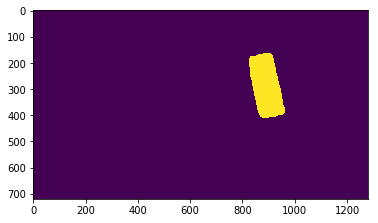

rotation 111
pose_xy: 889.0 287.0
-12.28832316327534
0.06469019999999999   -0.2044626
15
Processing 1 images
image                    shape: (720, 1280, 3)        min:    4.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


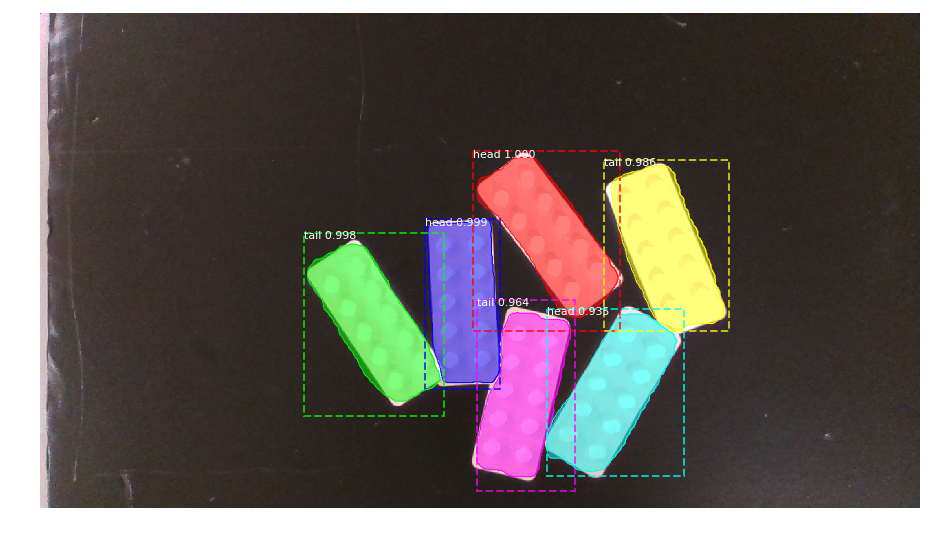

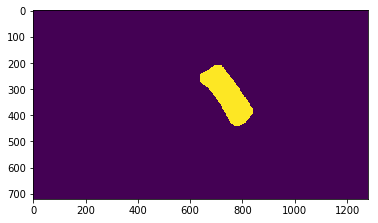

23091


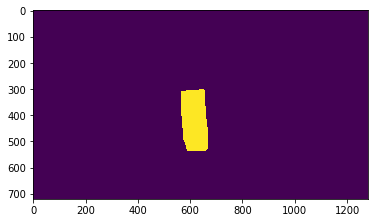

21590


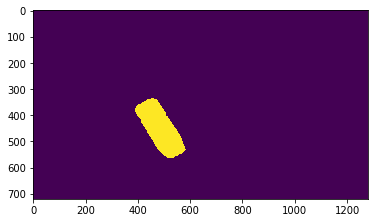

22683


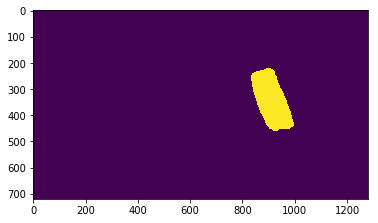

24176


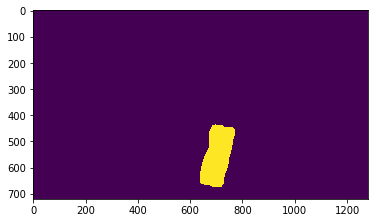

21556


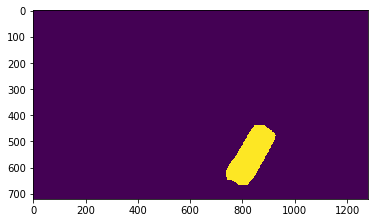

23453


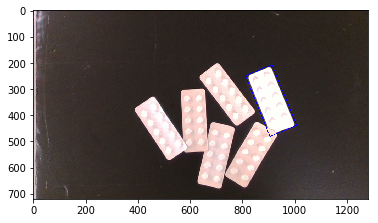

[[ 905  481]
 [ 811  250]
 [ 913  208]
 [1007  439]]


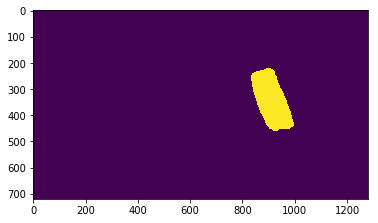

rotation 111
pose_xy: 909.0 344.5
-22.380135051959574
0.0698862   -0.18952409999999997
16
Processing 1 images
image                    shape: (720, 1280, 3)        min:    3.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


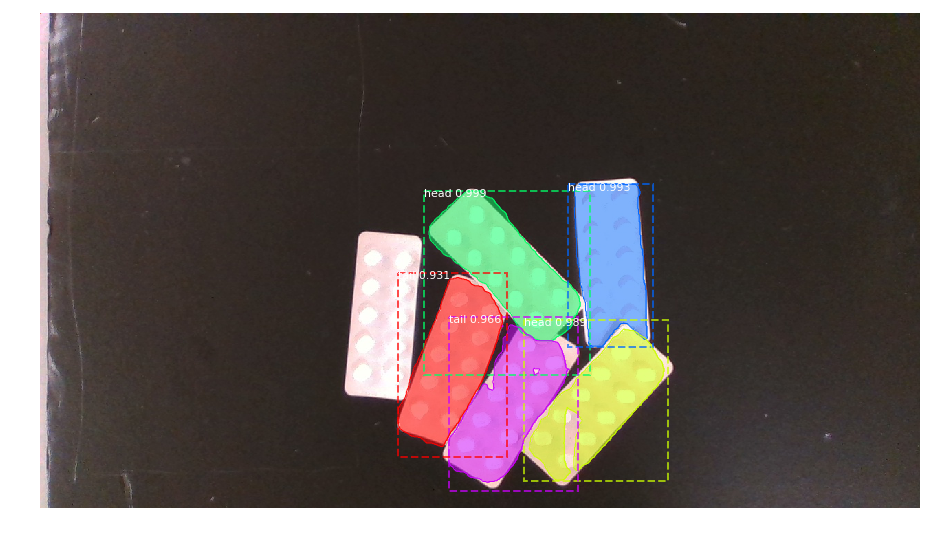

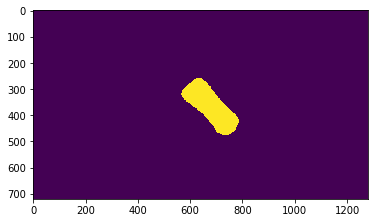

22492


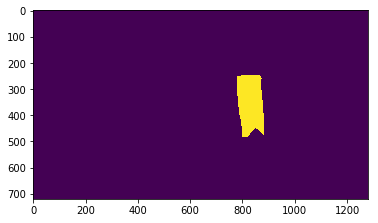

20162


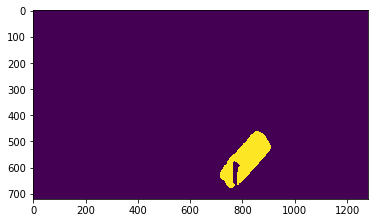

19269


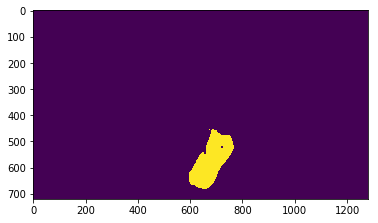

20852


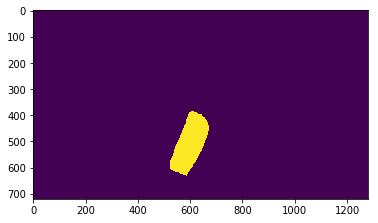

21093


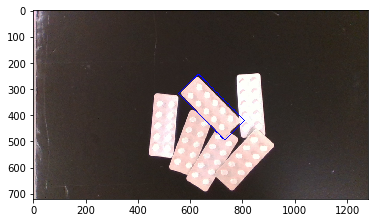

[[732 495]
 [556 318]
 [632 243]
 [808 420]]


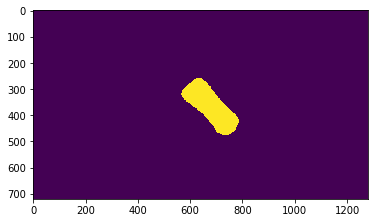

rotation 111
pose_xy: 682.0 369.0
-44.620563298581025
0.010911599999999999   -0.183159
17
Processing 1 images
image                    shape: (720, 1280, 3)        min:    5.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


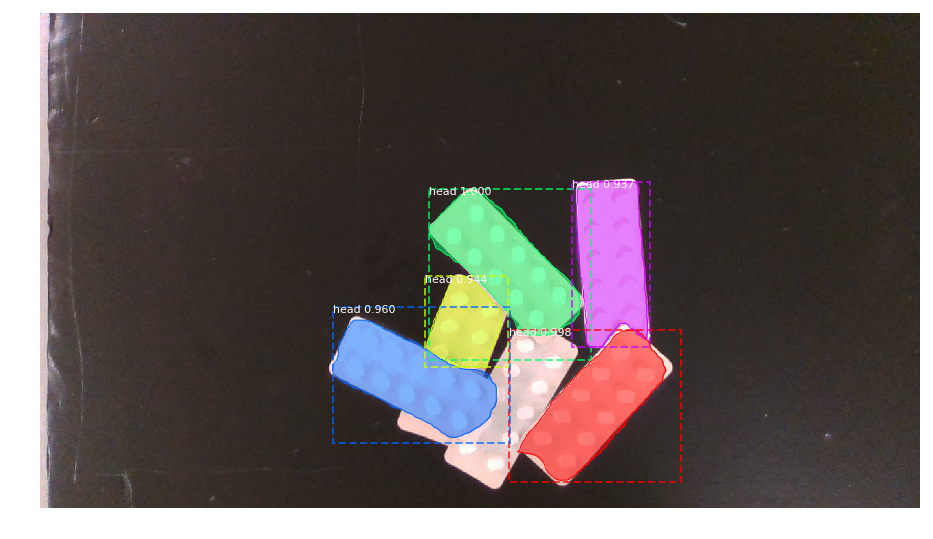

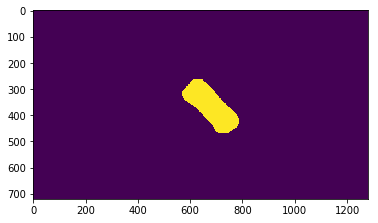

22512


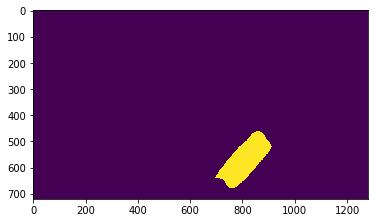

21988


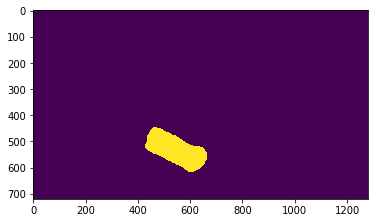

22150


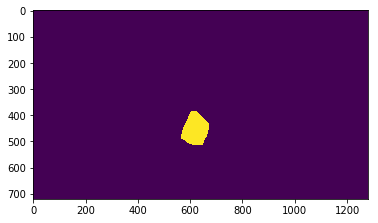

10026


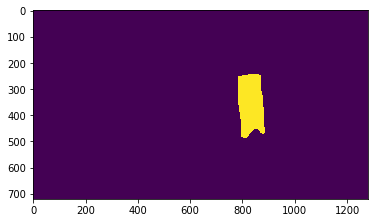

20331


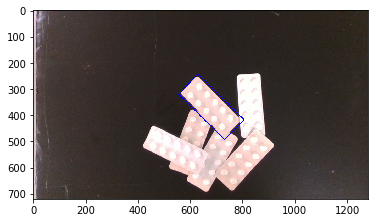

[[731 493]
 [556 320]
 [630 244]
 [806 417]]


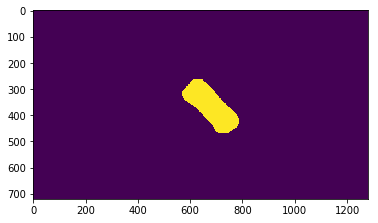

rotation 111
pose_xy: 680.5 368.5
-45.763898460929994
0.010521899999999999   -0.18328889999999998
18
Processing 1 images
image                    shape: (720, 1280, 3)        min:    9.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


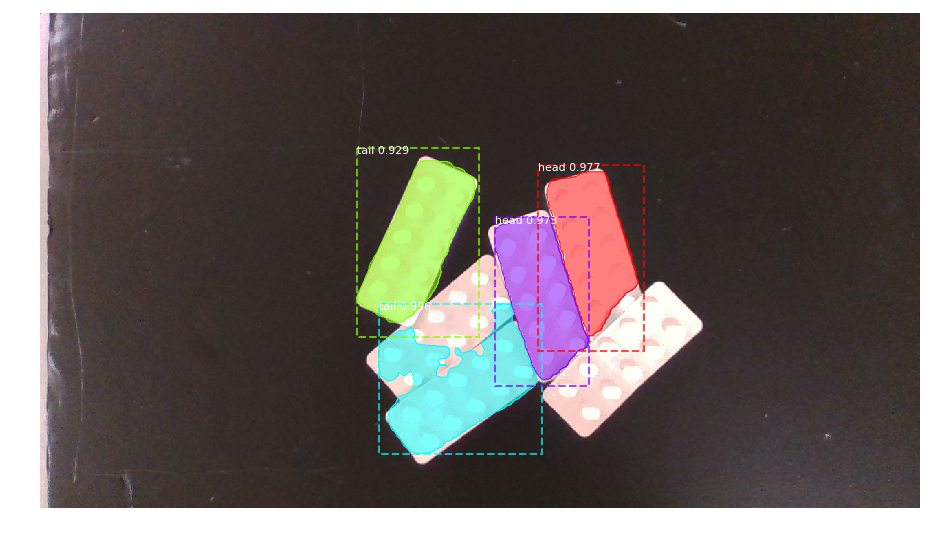

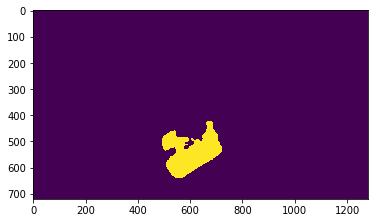

26253


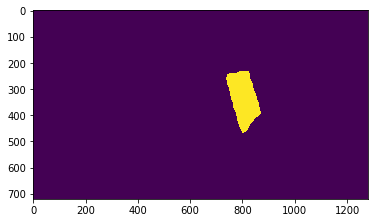

18958


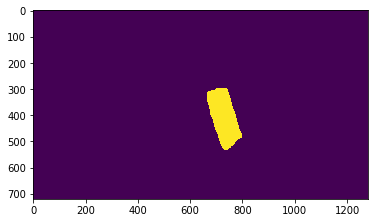

19277


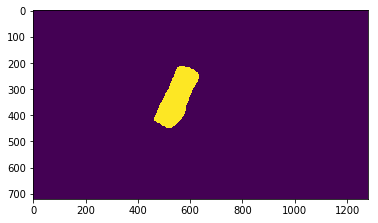

21539


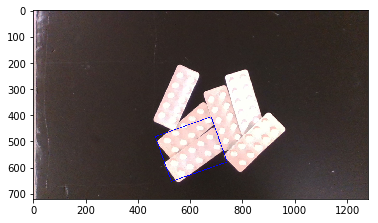

[[528 653]
 [467 482]
 [680 406]
 [741 578]]


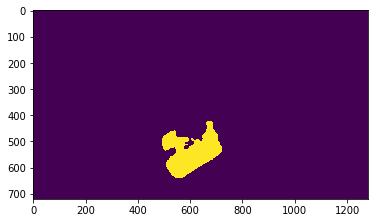

rotation 222
pose_xy: 604.0 529.5
-109.63259553753042
-0.009352799999999998   -0.14146109999999998
19
Processing 1 images
image                    shape: (720, 1280, 3)        min:    7.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


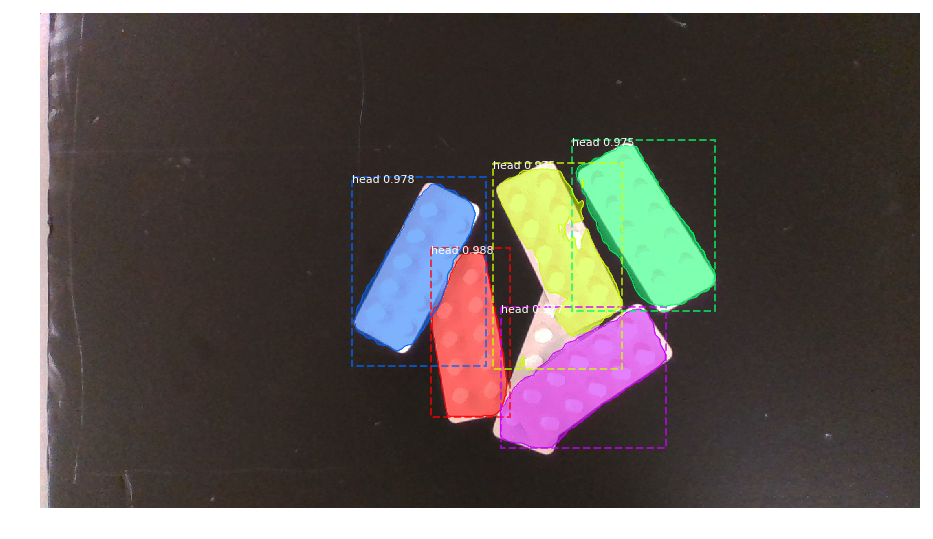

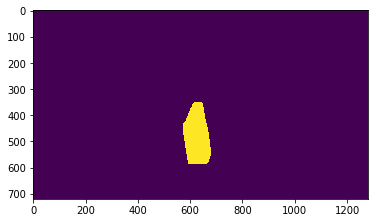

19158


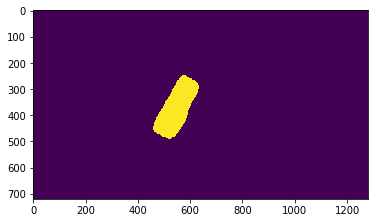

22416


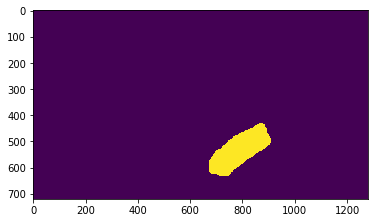

24630


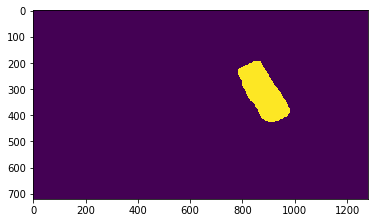

25497


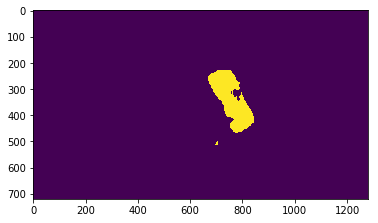

21142


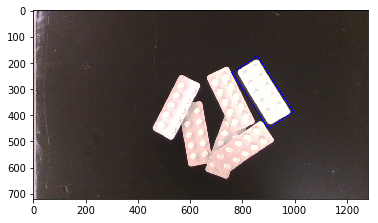

[[898 451]
 [759 239]
 [856 175]
 [995 388]]


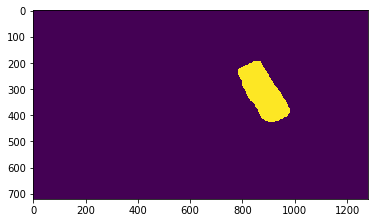

rotation 111
pose_xy: 877.0 313.0
-33.41658139531293
0.0615726   -0.1977078
20
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


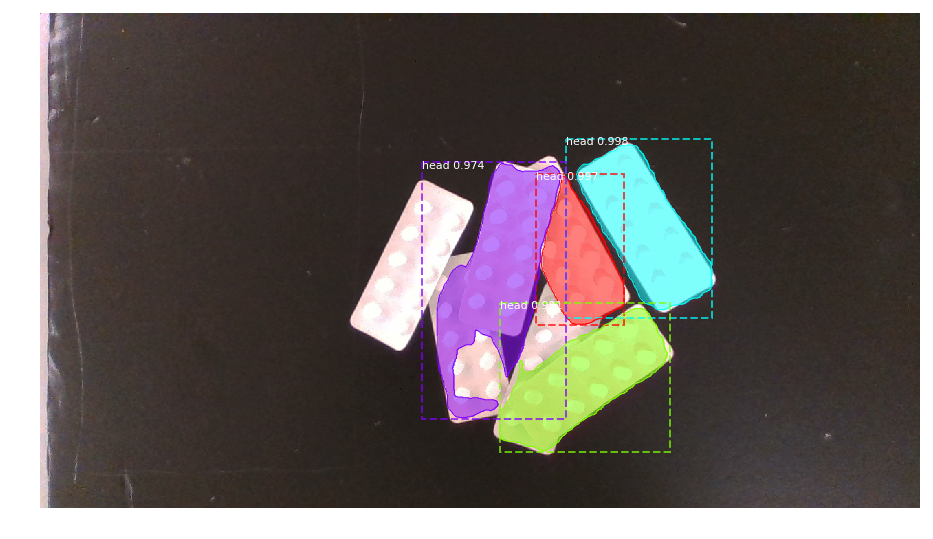

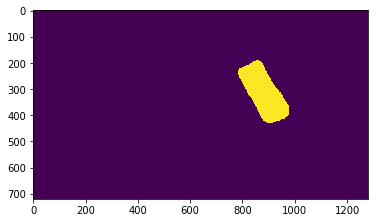

25124


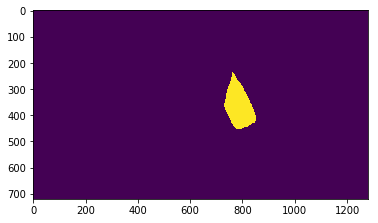

15475


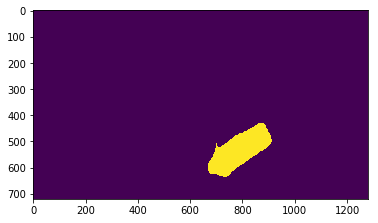

25615


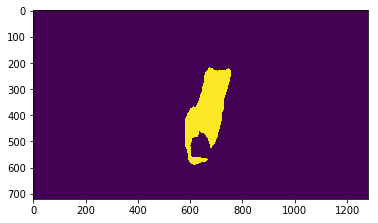

32902


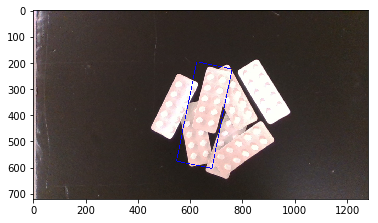

[[683 603]
 [548 575]
 [625 197]
 [760 224]]


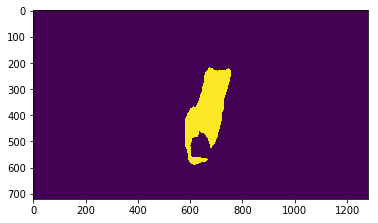

rotation 222
pose_xy: 654.0 400.0
-168.2825652967966
0.0036371999999999997   -0.1751052
0
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


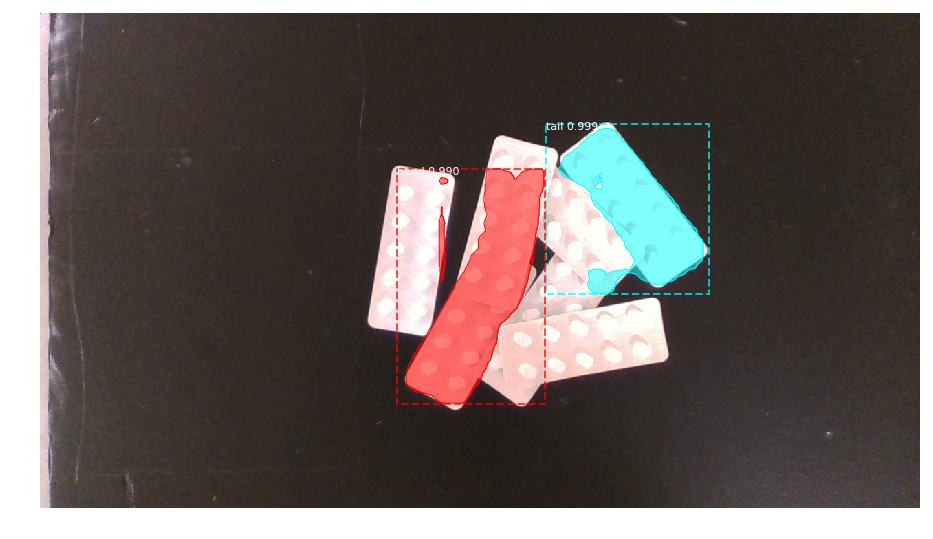

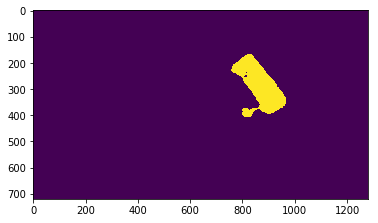

23732


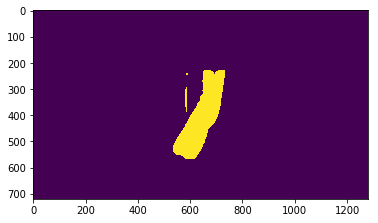

32137


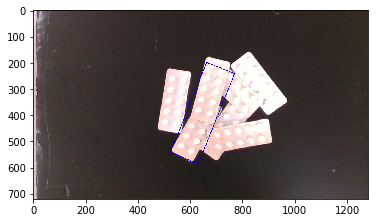

[[631 585]
 [525 542]
 [663 199]
 [770 242]]


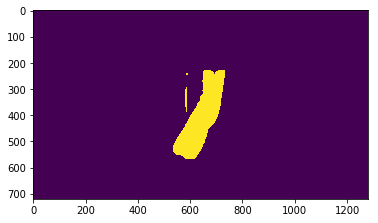

rotation 222
pose_xy: 647.0 392.0
-157.91955483246664
0.0018185999999999999   -0.1771836
1
Processing 1 images
image                    shape: (720, 1280, 3)        min:    5.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


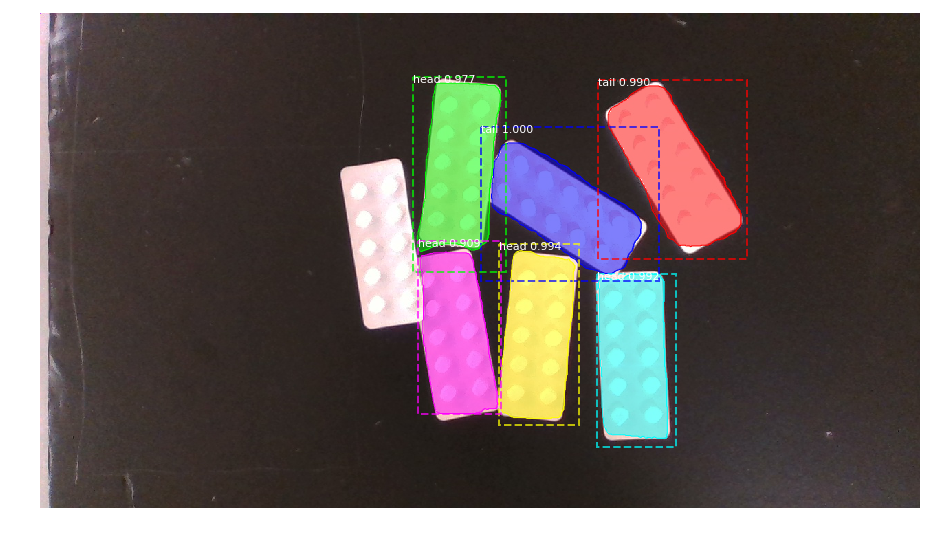

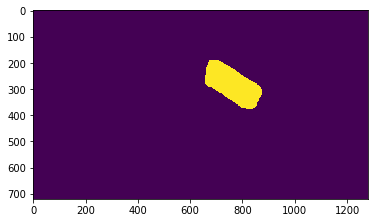

23344


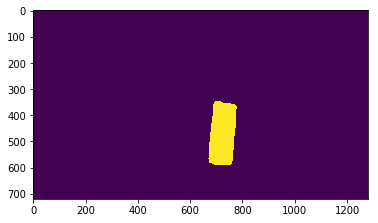

21662


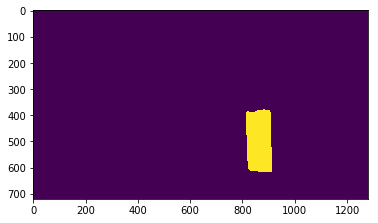

21741


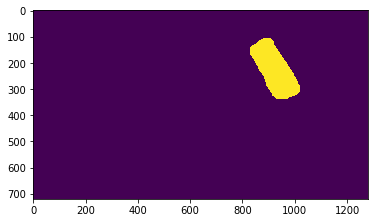

24686


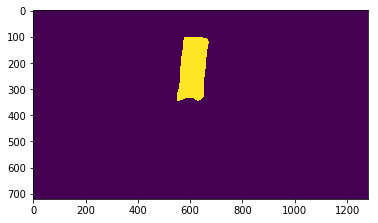

22811


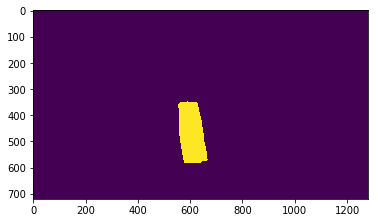

20270


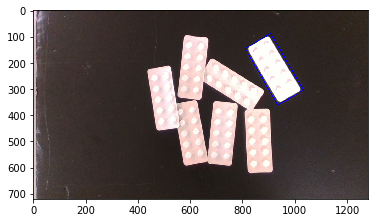

[[ 935  362]
 [ 810  146]
 [ 908   89]
 [1033  305]]


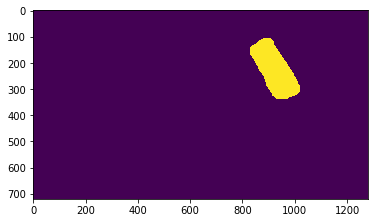

rotation 111
pose_xy: 921.5 225.5
-30.18368065722236
0.0731337   -0.22044029999999998
2
Processing 1 images
image                    shape: (720, 1280, 3)        min:   10.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


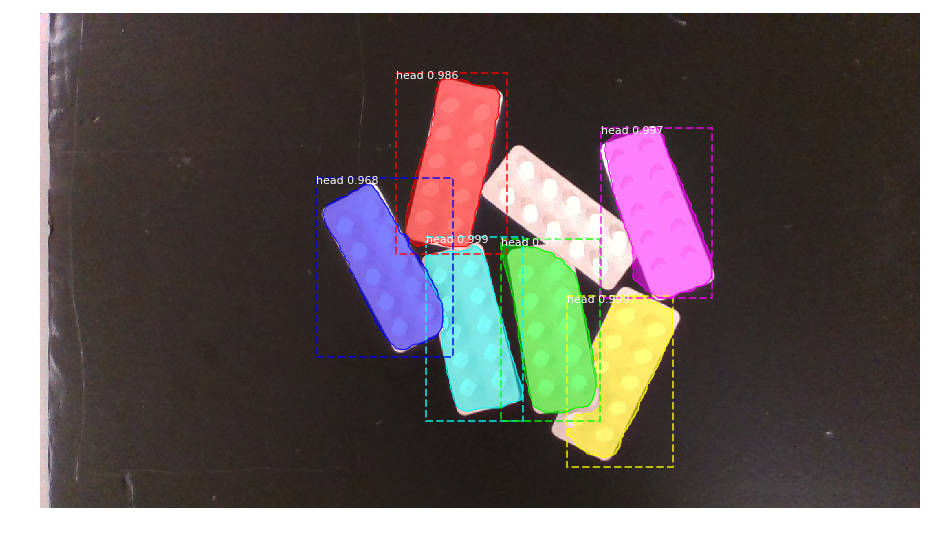

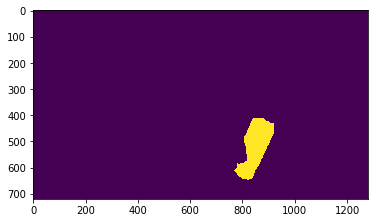

18550


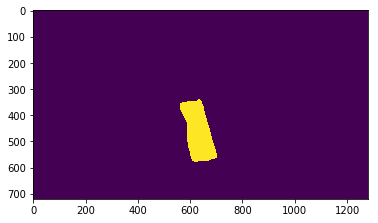

20768


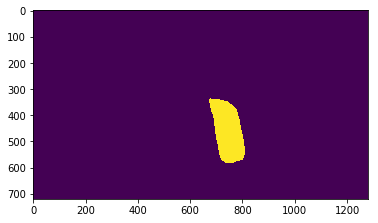

22895


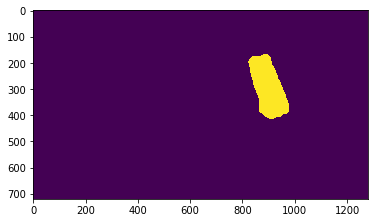

23761


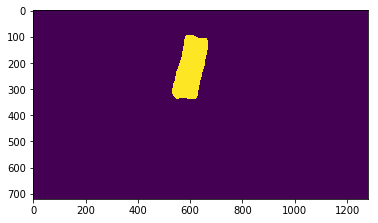

22694


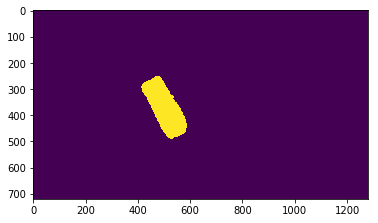

21845


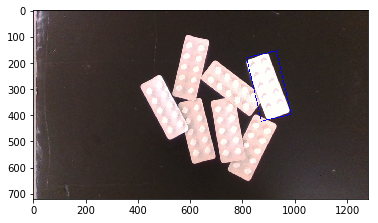

[[872 423]
 [816 181]
 [930 155]
 [986 397]]


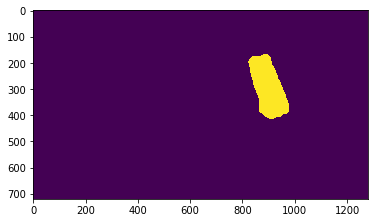

rotation 111
pose_xy: 901.0 289.0
-12.847704858717666
0.0678078   -0.20394299999999999
3
Processing 1 images
image                    shape: (720, 1280, 3)        min:    4.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


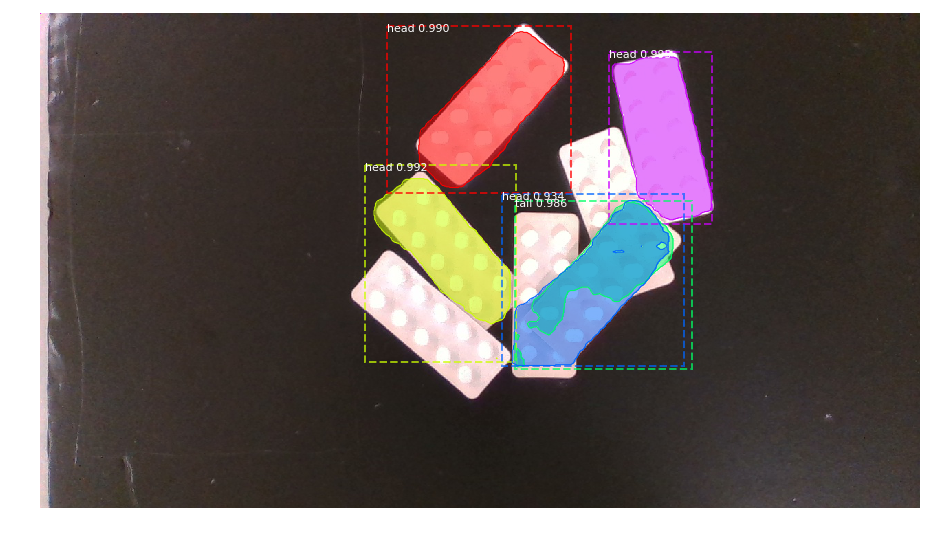

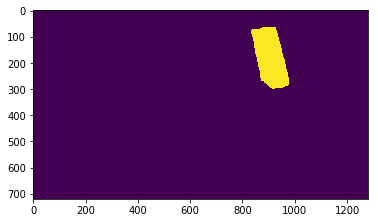

22939


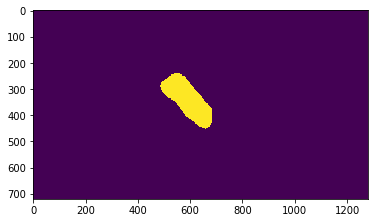

20956


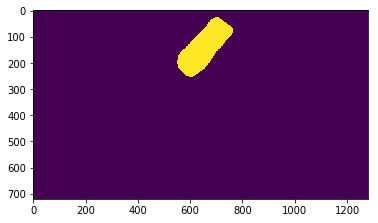

24128


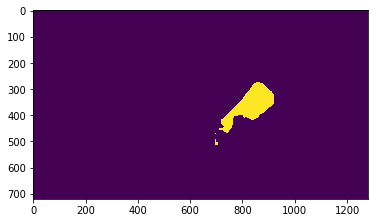

16700


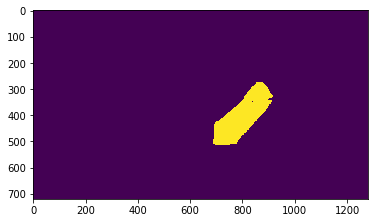

26393


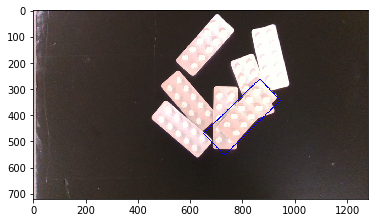

[[731 552]
 [651 470]
 [866 262]
 [945 344]]


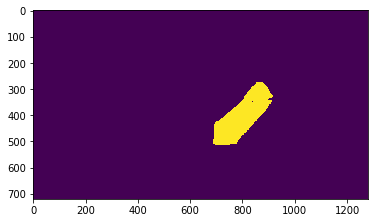

rotation 222
pose_xy: 798.5 407.0
-134.29268063145574
0.041178299999999994   -0.17328659999999999
4
Processing 1 images
image                    shape: (720, 1280, 3)        min:    1.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


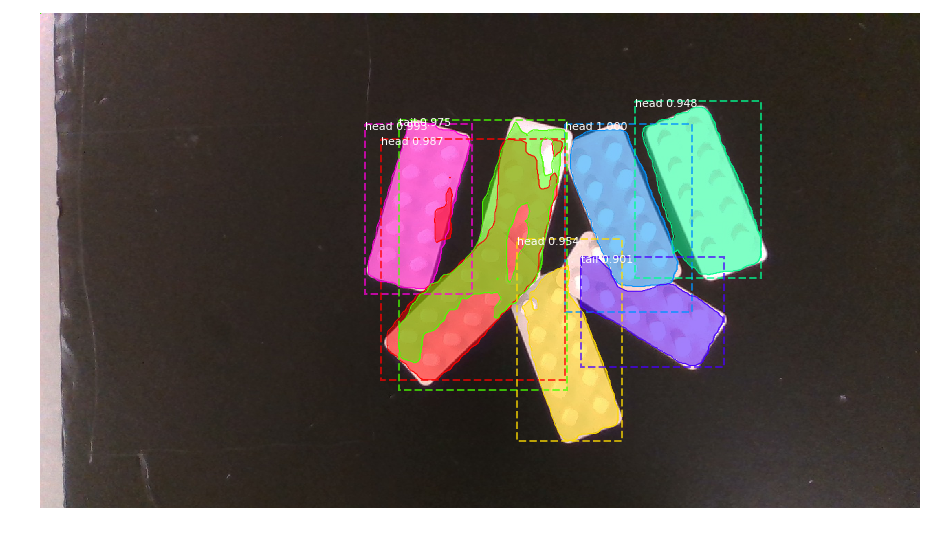

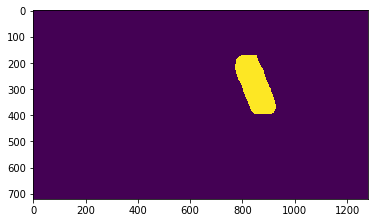

22336


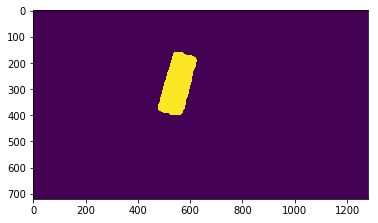

22648


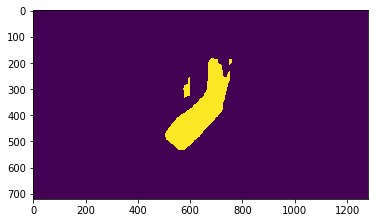

35411


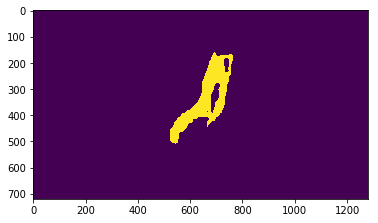

26735


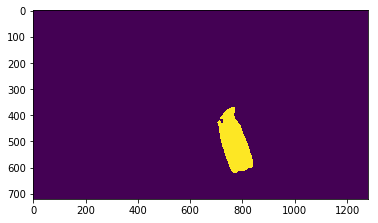

19914


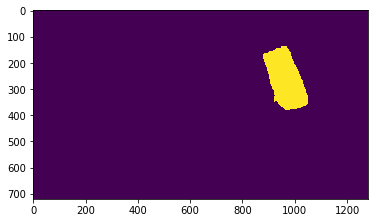

26305


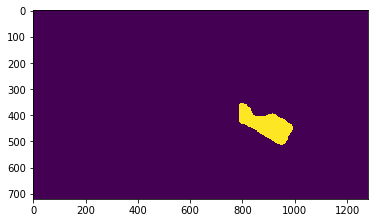

15911


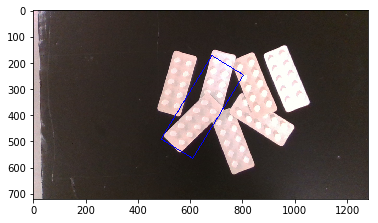

[[610 565]
 [489 491]
 [683 173]
 [804 247]]


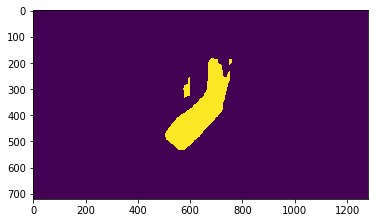

rotation 222
pose_xy: 646.5 369.0
-148.55128472694636
0.0016887   -0.183159
5
Processing 1 images
image                    shape: (720, 1280, 3)        min:    2.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


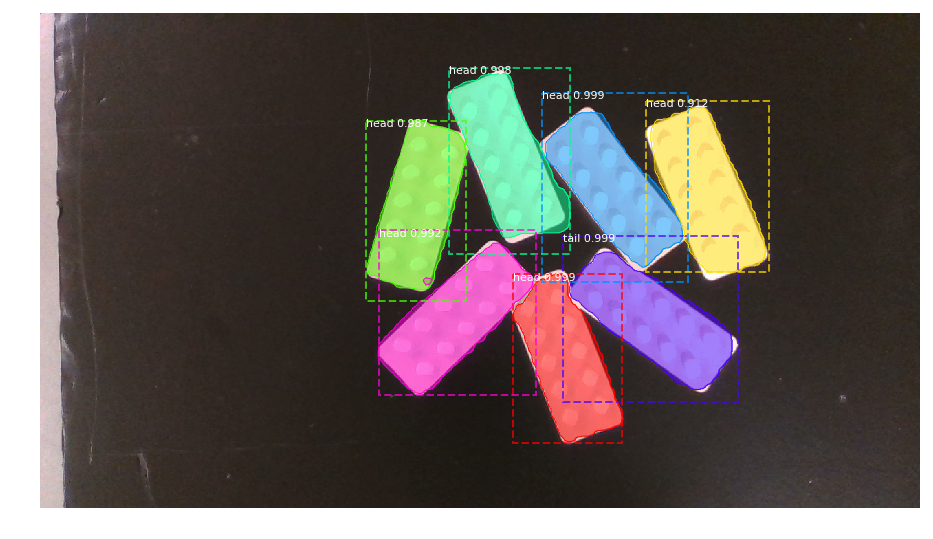

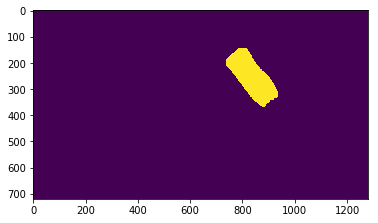

22220


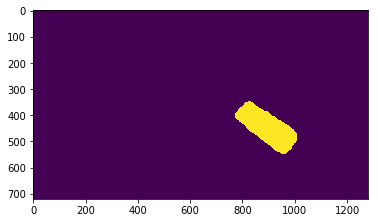

23585


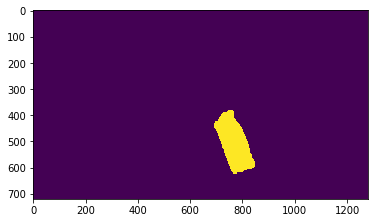

21102


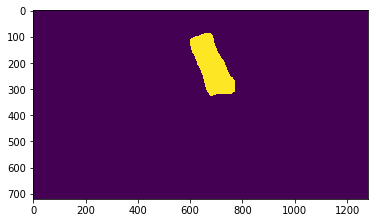

23271


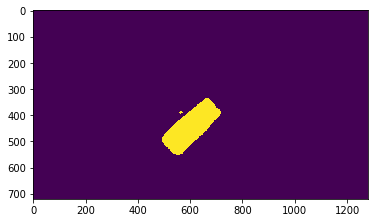

23152


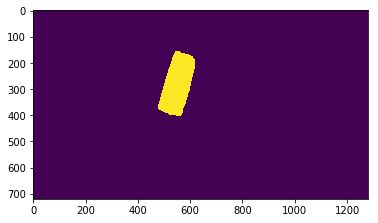

22513


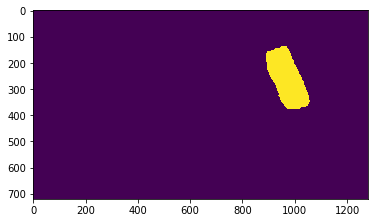

24286


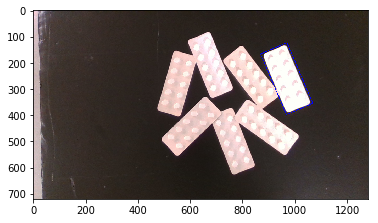

[[ 968  398]
 [ 869  167]
 [ 970  124]
 [1069  355]]


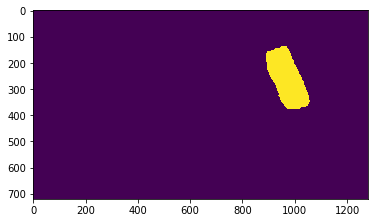

rotation 111
pose_xy: 969.0 261.0
-23.06151953229353
0.0854742   -0.21121739999999997
6
Processing 1 images
image                    shape: (720, 1280, 3)        min:    4.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


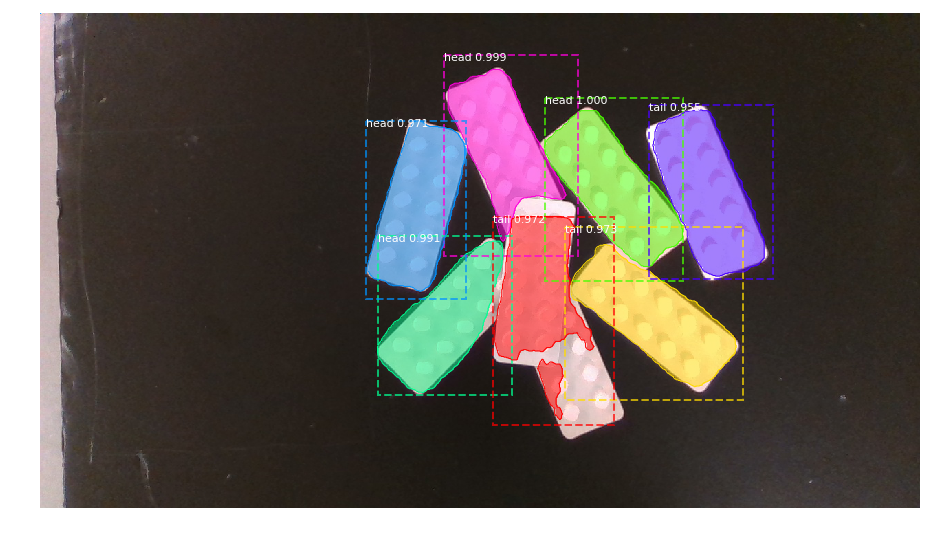

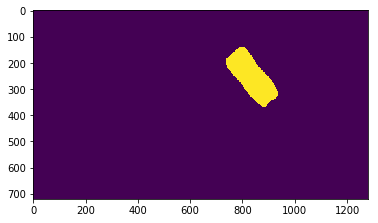

22361


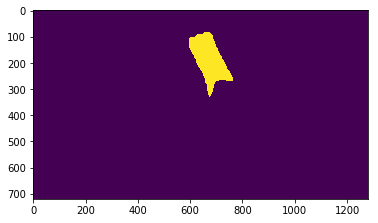

19785


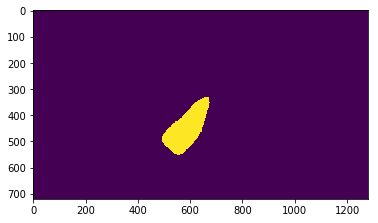

20162


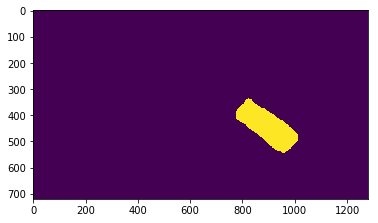

23656


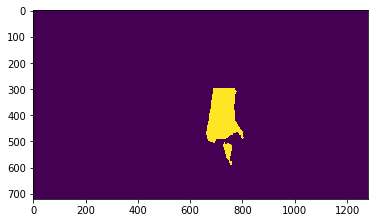

21446


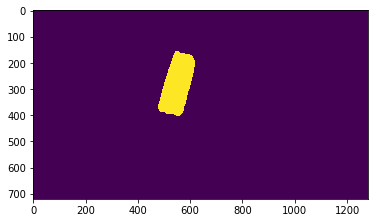

22355


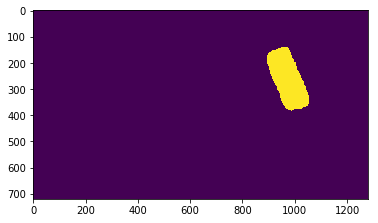

23719


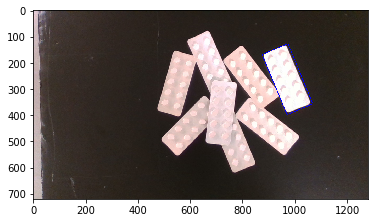

[[ 970  398]
 [ 875  169]
 [ 974  128]
 [1069  357]]


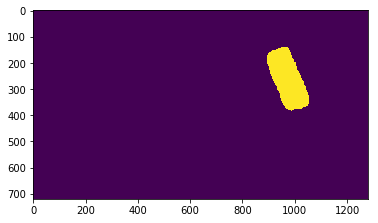

rotation 111
pose_xy: 972.0 263.0
-22.496471500232584
0.0862536   -0.2106978
7
Processing 1 images
image                    shape: (720, 1280, 3)        min:    9.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


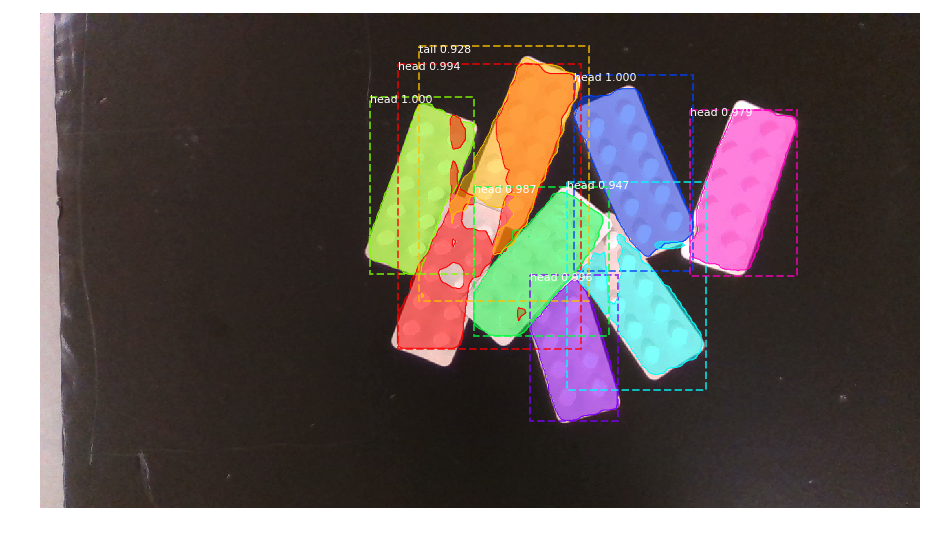

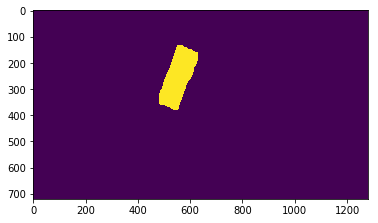

20901


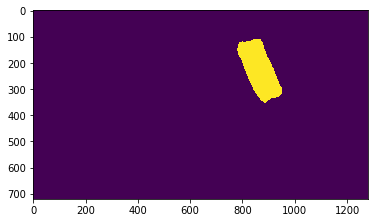

23407


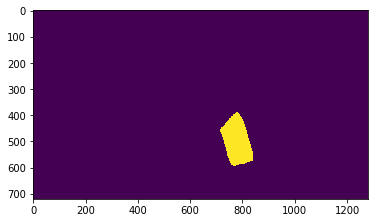

16516


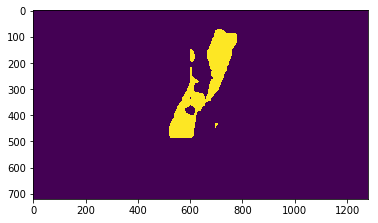

34961


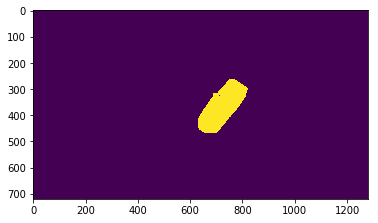

21280


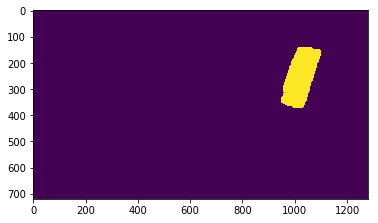

22449


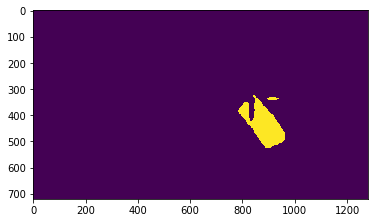

17062


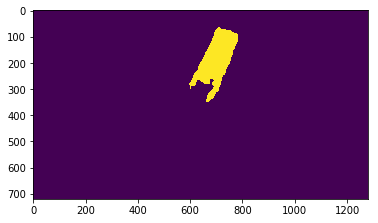

23320


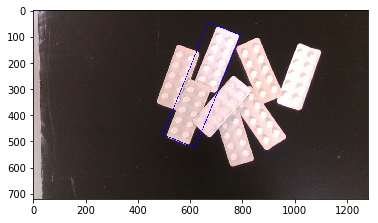

[[619 524]
 [496 474]
 [670  46]
 [793  96]]


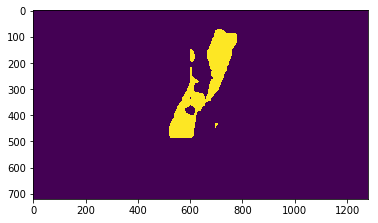

rotation 222
pose_xy: 644.5 285.0
-157.87805802811815
0.0011690999999999997   -0.20498219999999998
8
Processing 1 images
image                    shape: (720, 1280, 3)        min:    5.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


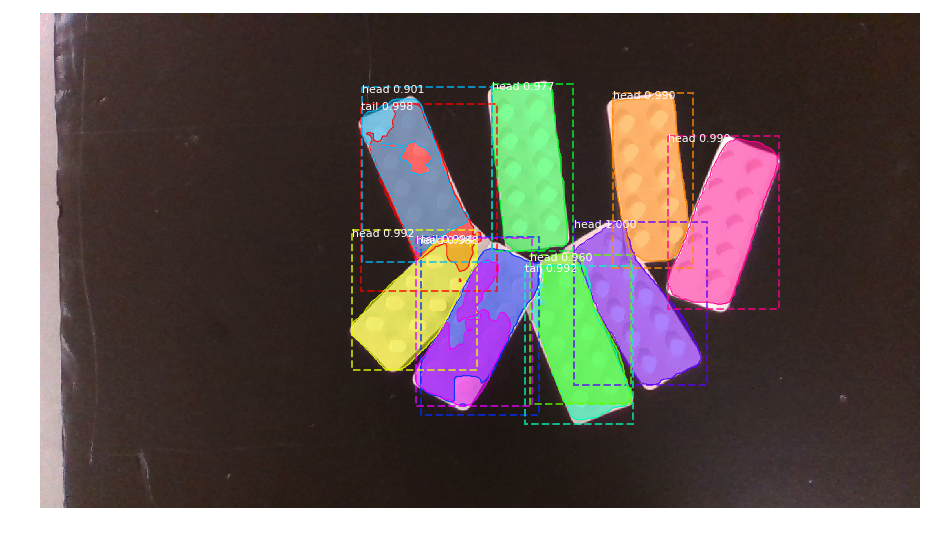

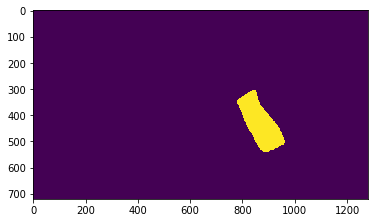

21454


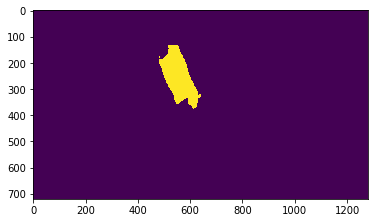

19716


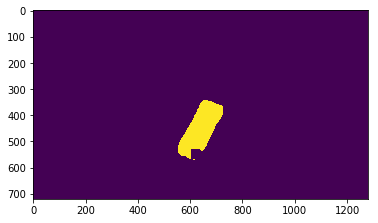

19797


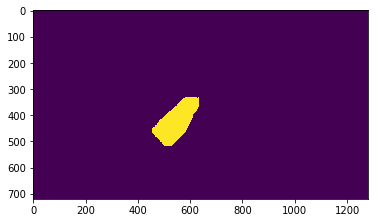

18057


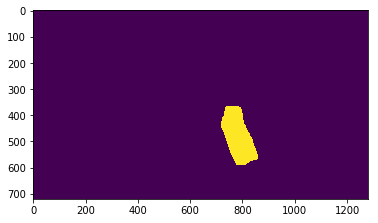

19498


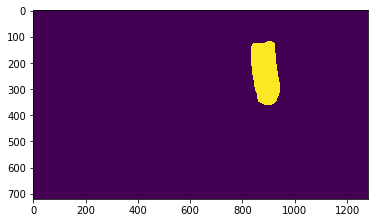

21555


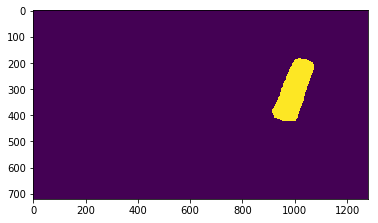

21814


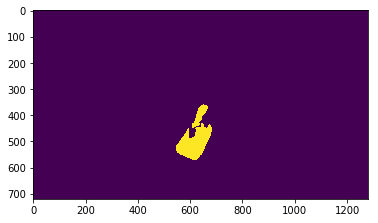

13421


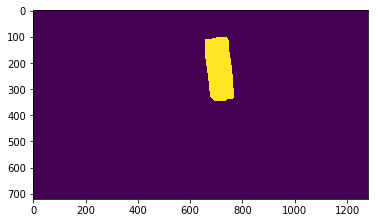

21911


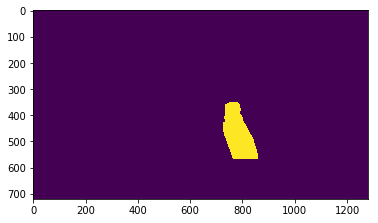

18701


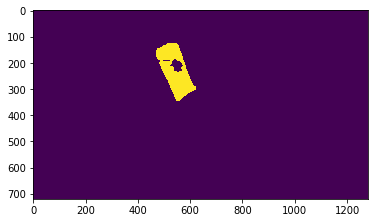

16695


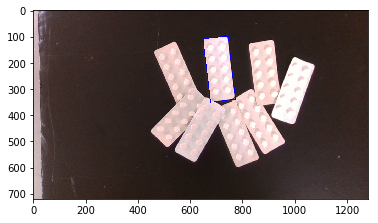

[[678 351]
 [649 109]
 [745  98]
 [773 339]]


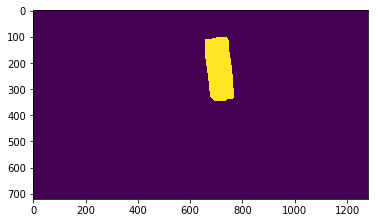

rotation 111
pose_xy: 711.5 224.5
-6.536633648797067
0.018575699999999997   -0.2207001
9
Processing 1 images
image                    shape: (720, 1280, 3)        min:    1.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


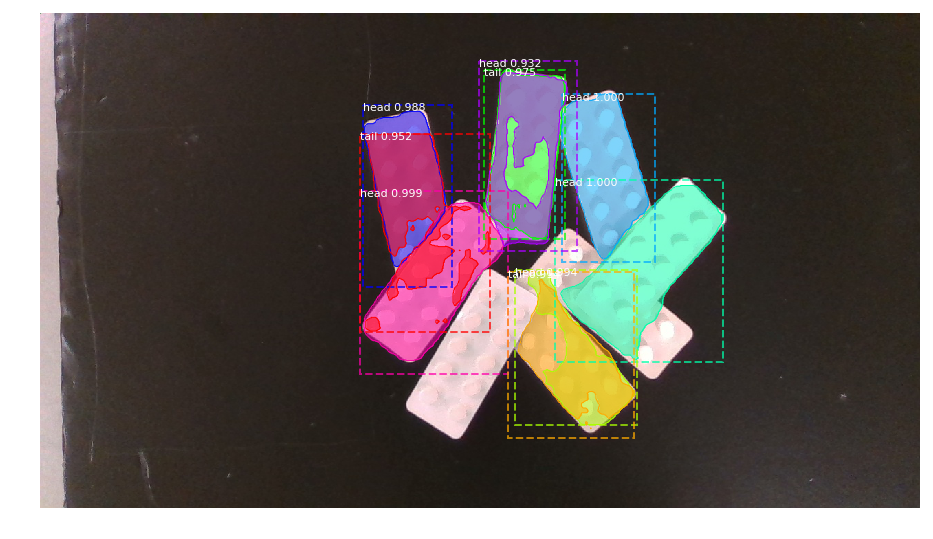

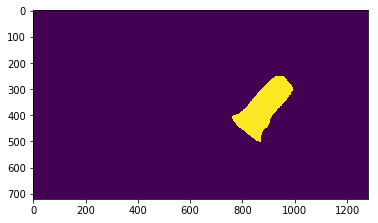

26131


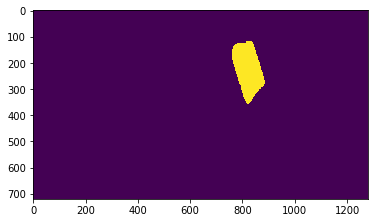

18898


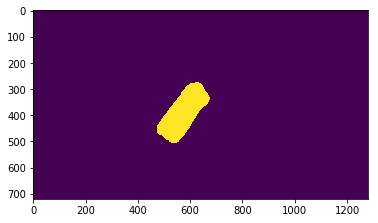

24014


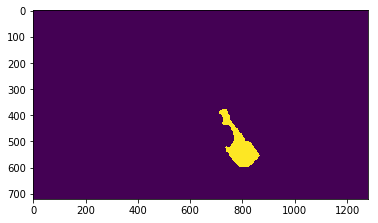

12755


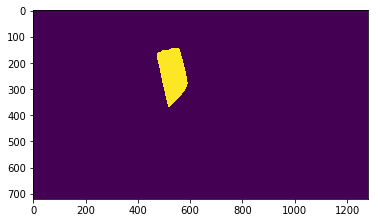

17438


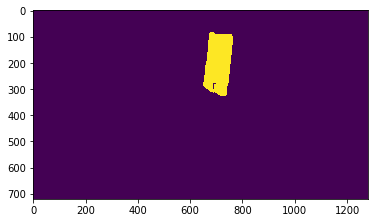

20956


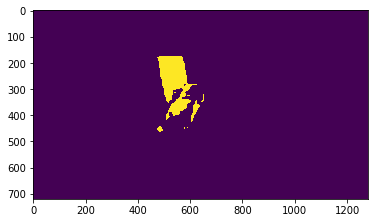

19709


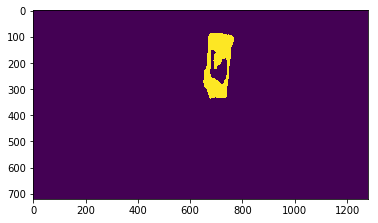

17288


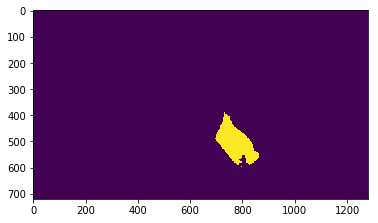

16128


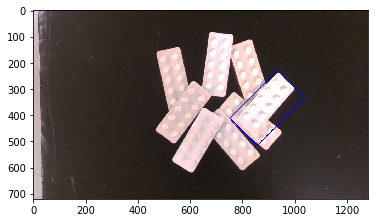

[[ 856  516]
 [ 752  412]
 [ 934  230]
 [1038  334]]


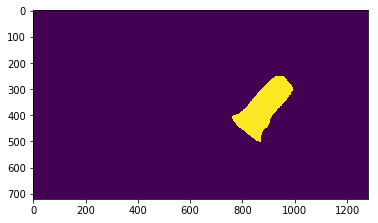

rotation 222
pose_xy: 895.0 373.0
-135.0
0.066249   -0.18211979999999997
10
Processing 1 images
image                    shape: (720, 1280, 3)        min:    7.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


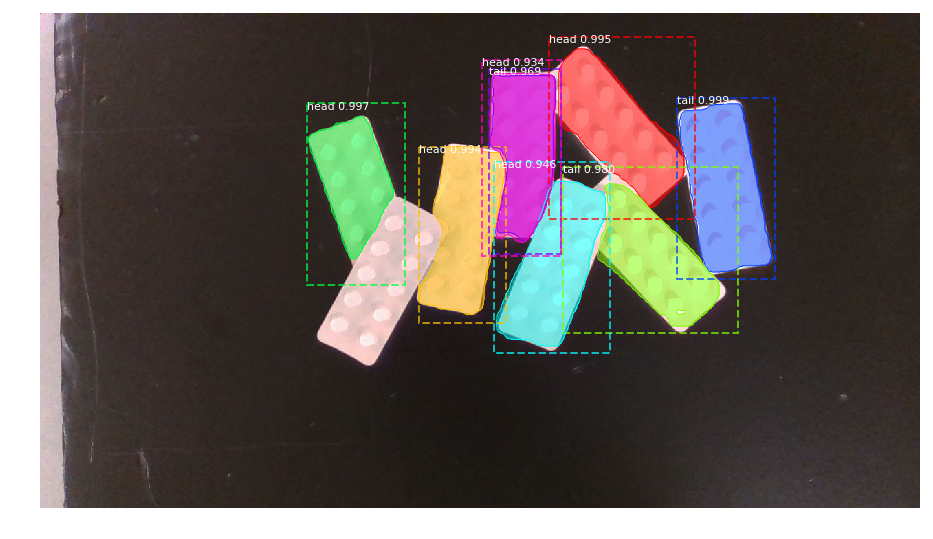

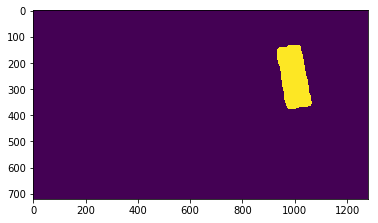

23022


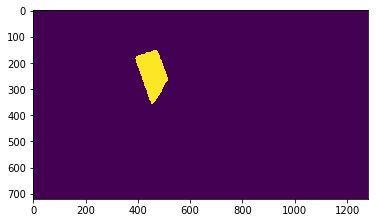

14889


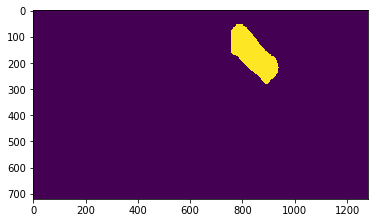

21611


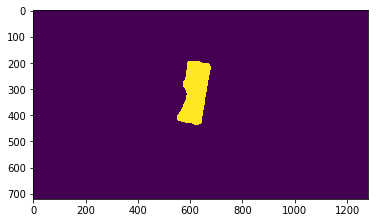

20361


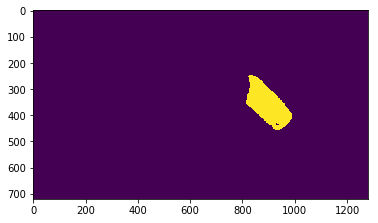

19471


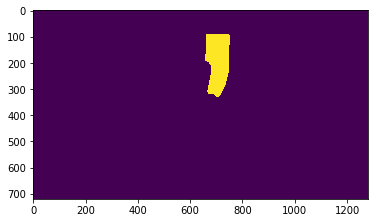

17692


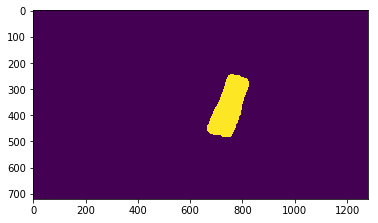

22304


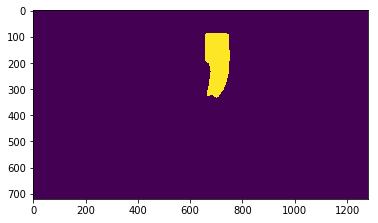

18835


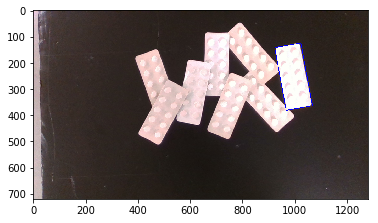

[[ 967  382]
 [ 923  143]
 [1023  125]
 [1067  364]]


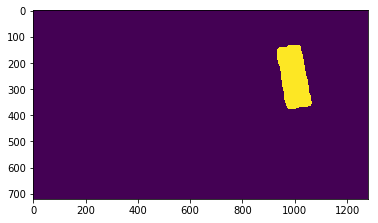

rotation 111
pose_xy: 995.0 253.5
-10.203973721731684
0.09222899999999999   -0.2131659
11
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


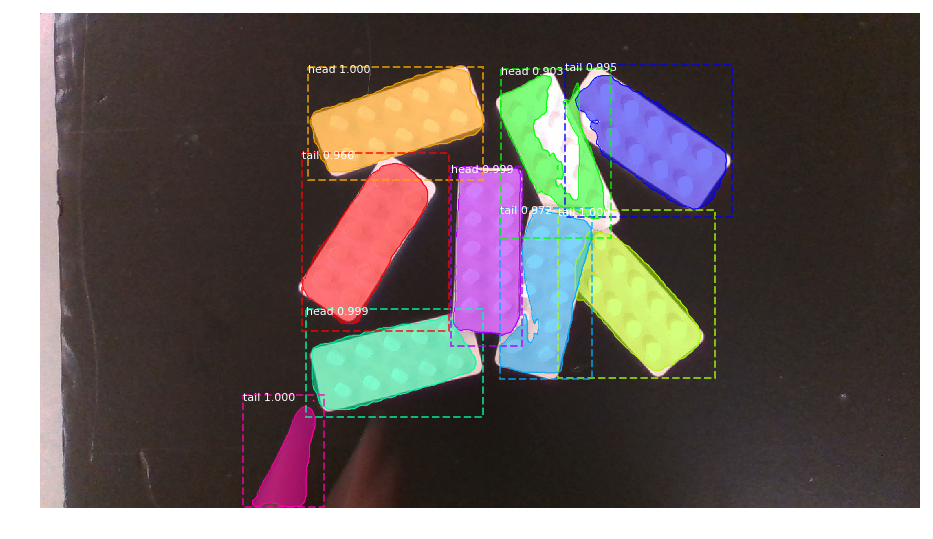

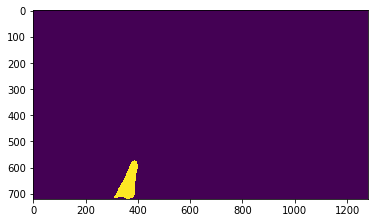

6801


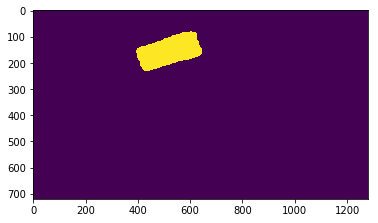

23514


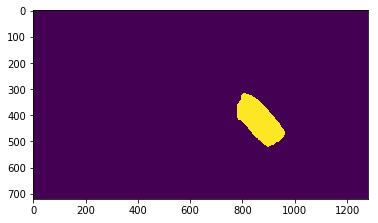

20591


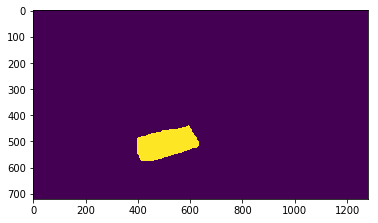

21529


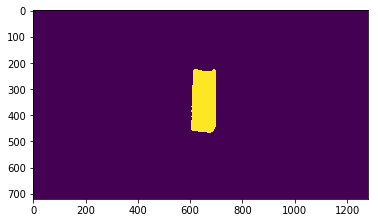

21548


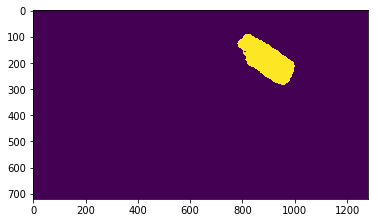

22458


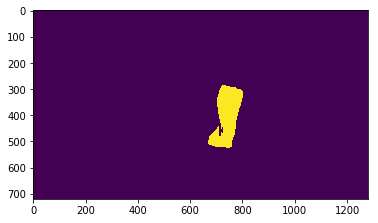

18392


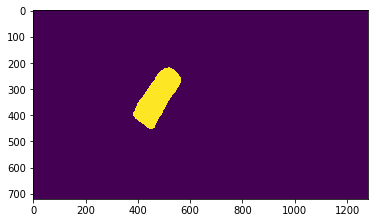

21696


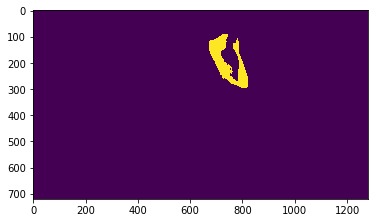

13031


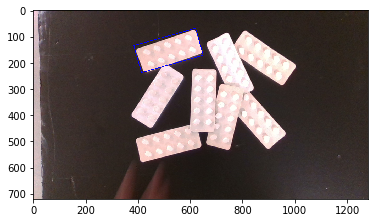

[[414 238]
 [385 135]
 [621  69]
 [650 172]]


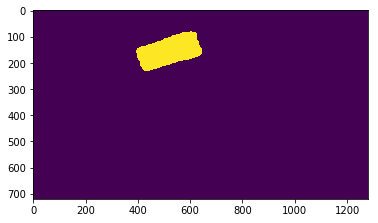

rotation 222
pose_xy: 517.5 153.5
-105.72474572274741
-0.0318255   -0.2391459
12
Processing 1 images
image                    shape: (720, 1280, 3)        min:    2.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


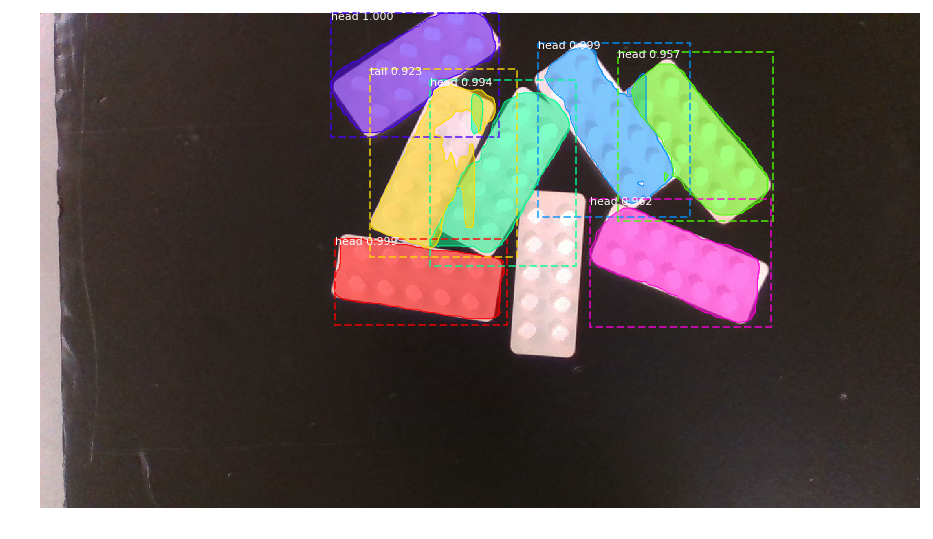

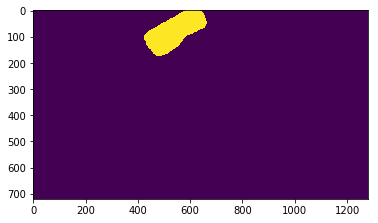

22915


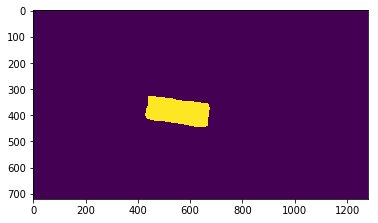

21679


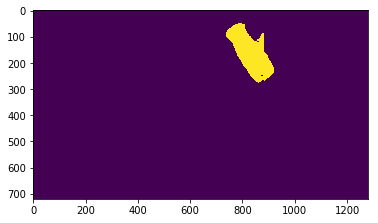

21094


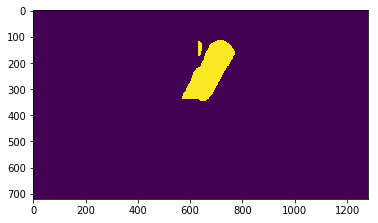

24373


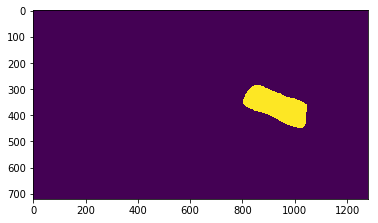

23055


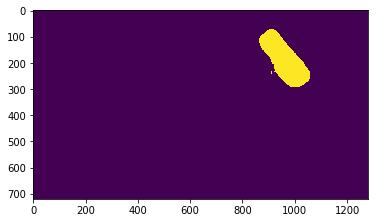

22165


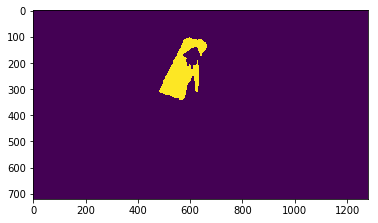

19704


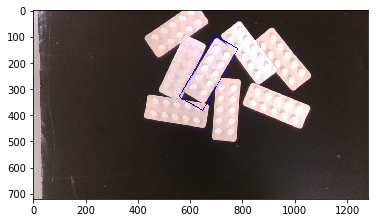

[[648 382]
 [558 330]
 [694  95]
 [783 147]]


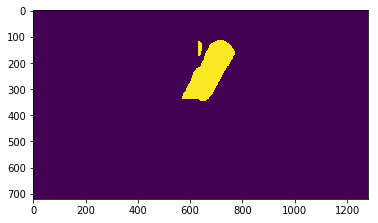

rotation 222
pose_xy: 671.0 238.5
-149.9816325723909
0.0080538   -0.2170629
13
Processing 1 images
image                    shape: (720, 1280, 3)        min:    5.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


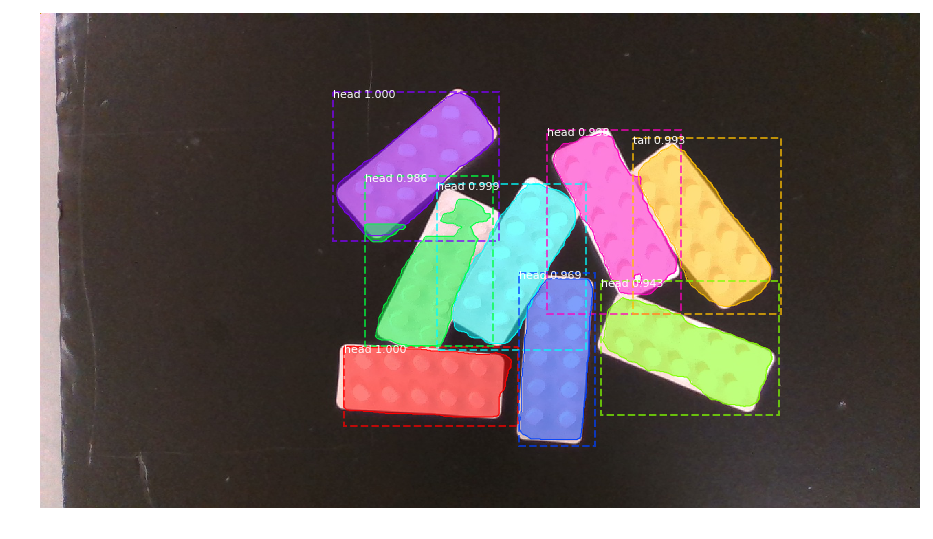

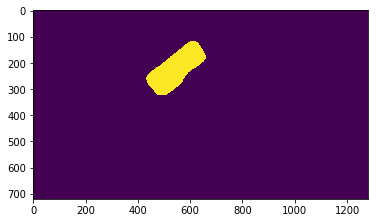

23464


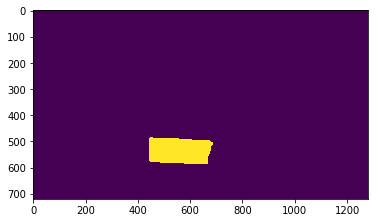

21814


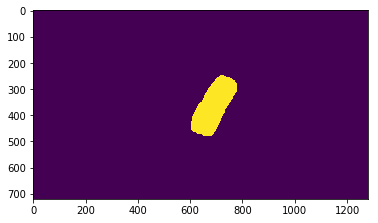

23043


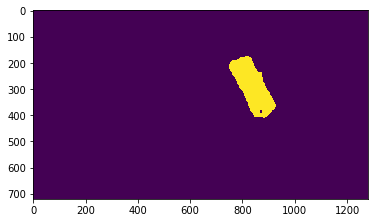

21601


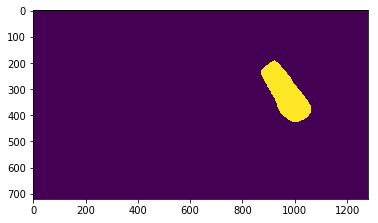

23133


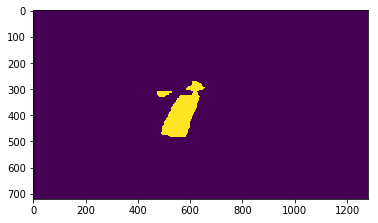

17968


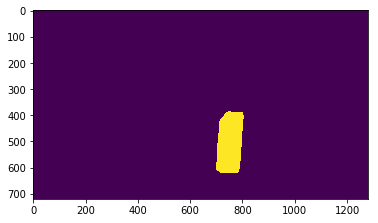

20958


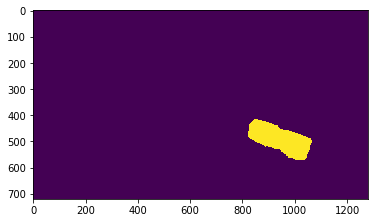

20985


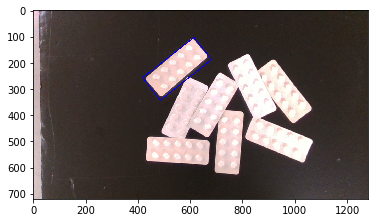

[[486 343]
 [419 257]
 [615 104]
 [682 189]]


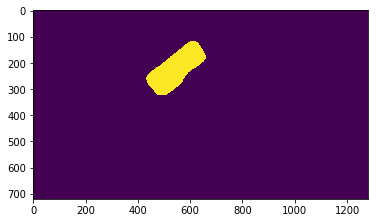

rotation 222
pose_xy: 550.5 223.5
-127.92107839538778
-0.023252099999999998   -0.2209599
14
Processing 1 images
image                    shape: (720, 1280, 3)        min:    1.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


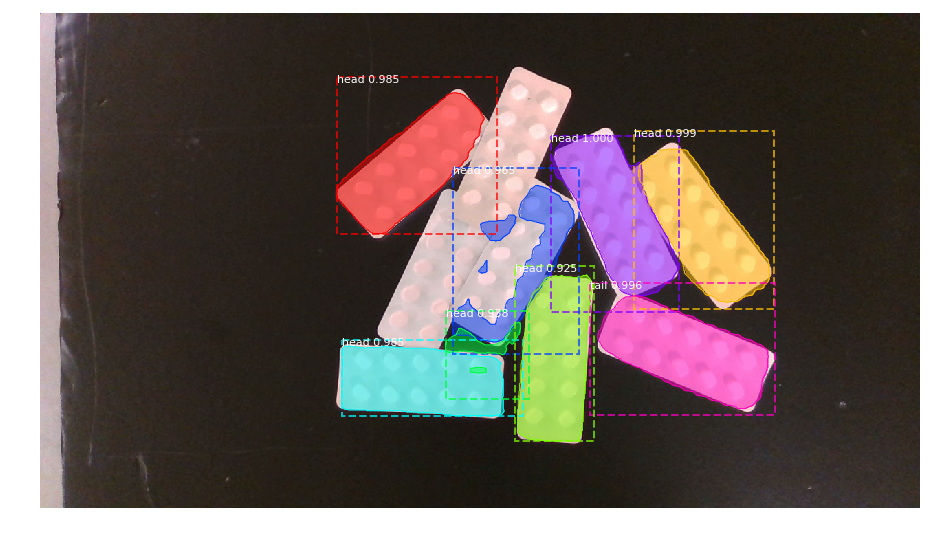

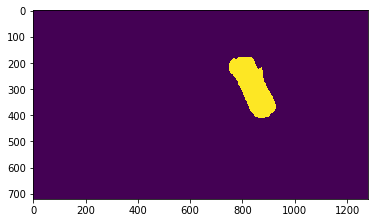

23319


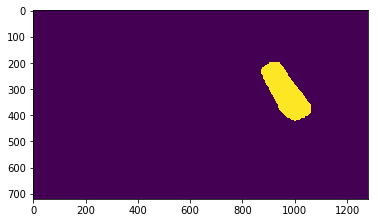

22470


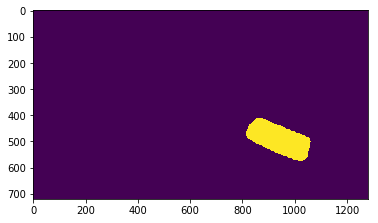

23570


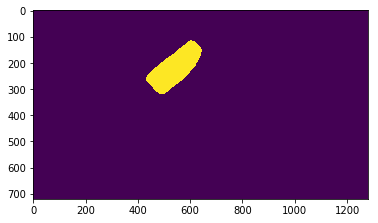

21779


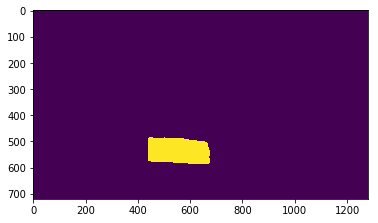

21143


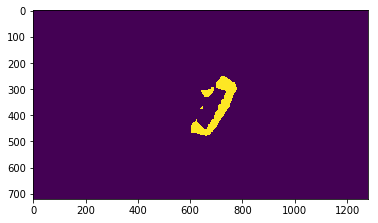

12457


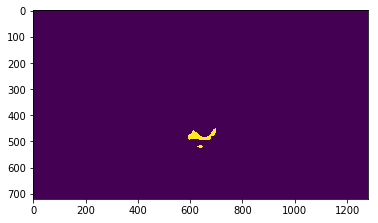

2351


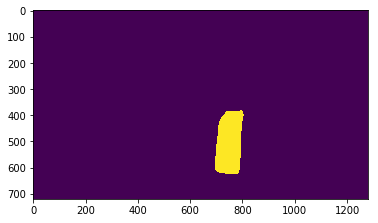

21449


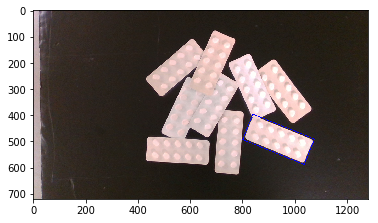

[[1036  588]
 [ 801  493]
 [ 840  396]
 [1075  491]]


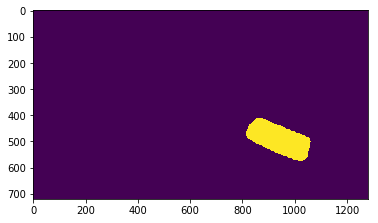

rotation 111
pose_xy: 938.0 492.0
-68.09682191816084
0.07742039999999999   -0.1512036
15
Processing 1 images
image                    shape: (720, 1280, 3)        min:    3.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


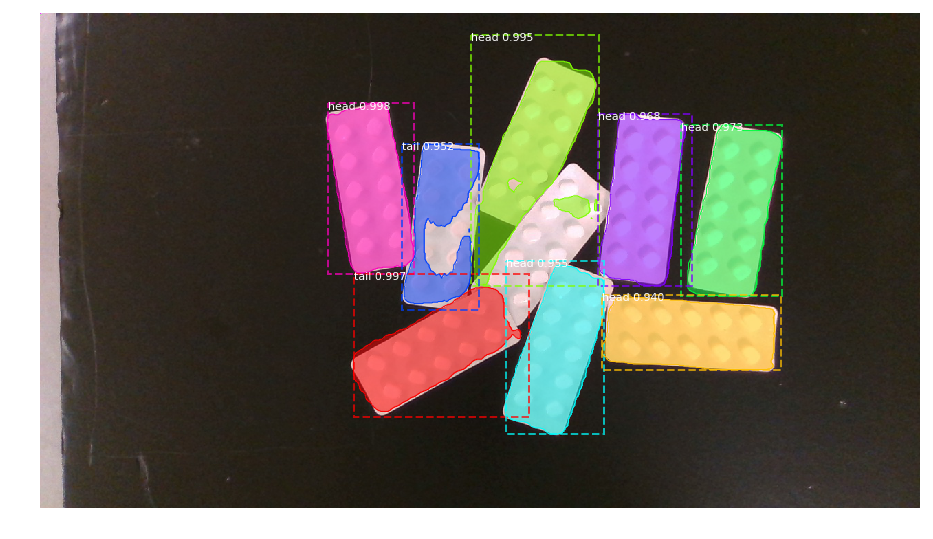

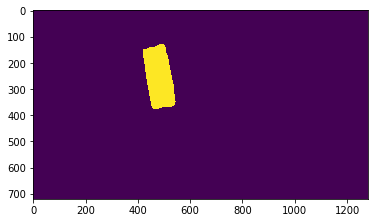

22135


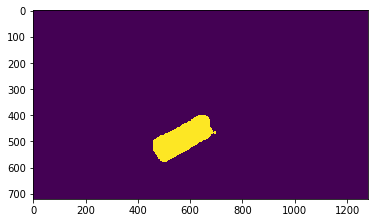

22030


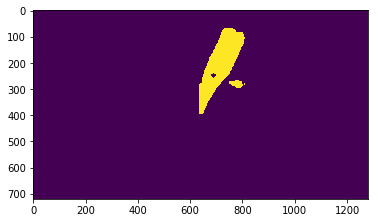

26047


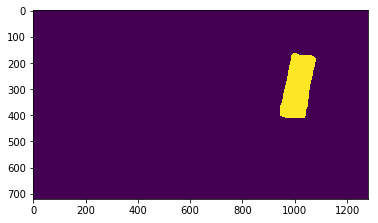

23394


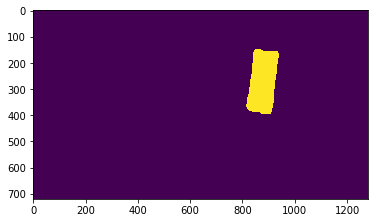

23094


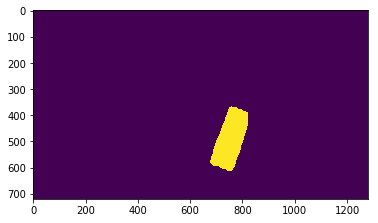

21560


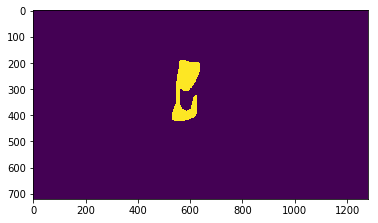

14165


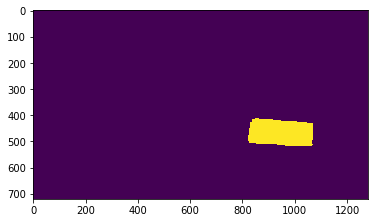

22790


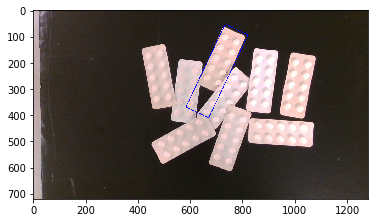

[[671 410]
 [584 369]
 [734  53]
 [821  95]]


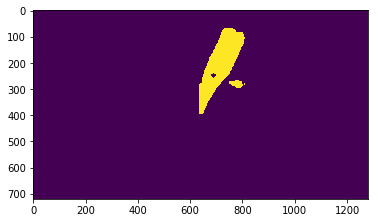

rotation 222
pose_xy: 702.5 231.5
-154.76716867679164
0.0162375   -0.2188815
16
Processing 1 images
image                    shape: (720, 1280, 3)        min:    3.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


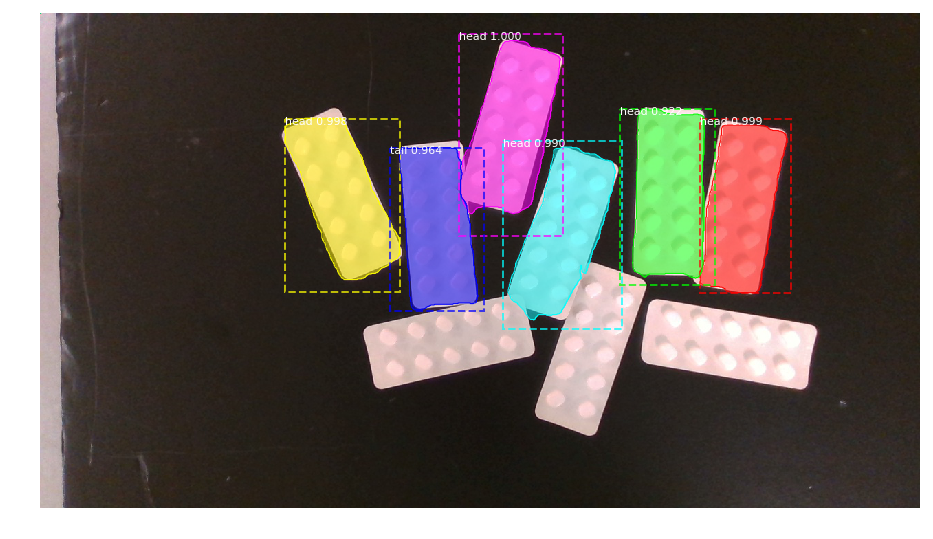

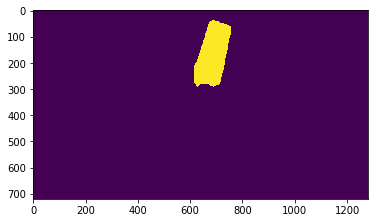

24204


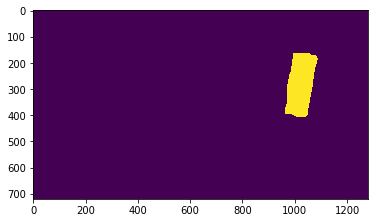

21970


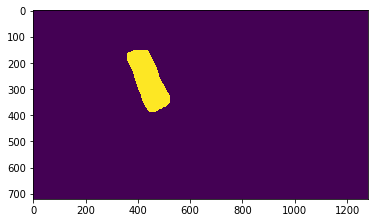

22209


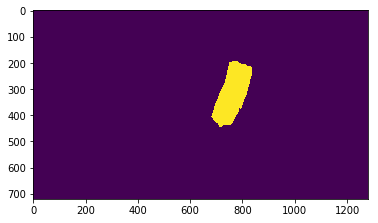

22472


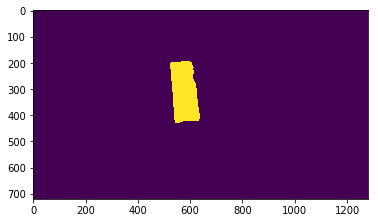

21002


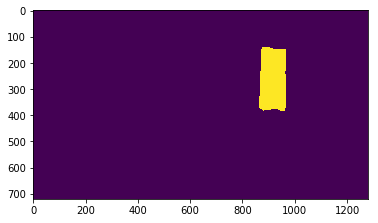

22998


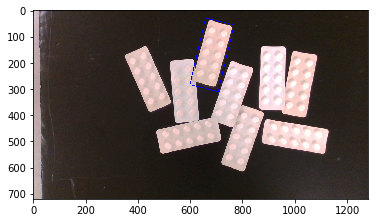

[[707 310]
 [599 284]
 [659  30]
 [768  56]]


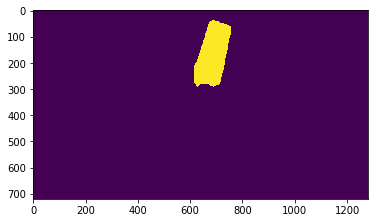

rotation 222
pose_xy: 683.0 170.0
-166.46414363086578
0.011171399999999998   -0.2348592
17
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


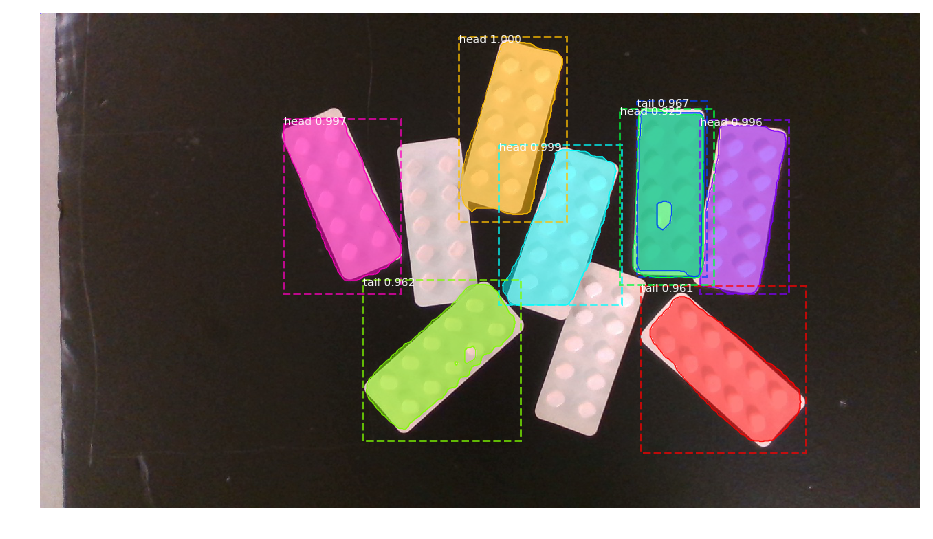

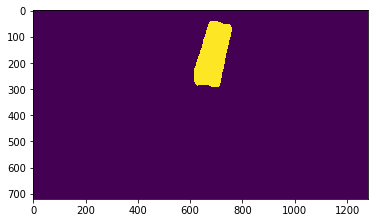

24512


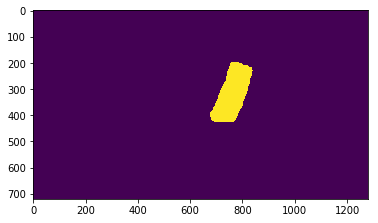

21863


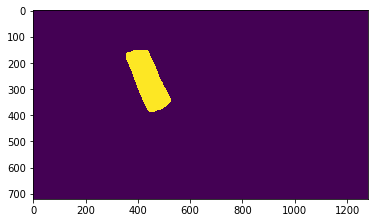

22407


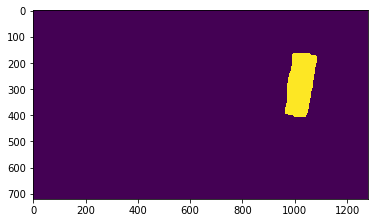

22125


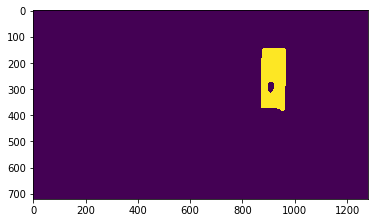

20888


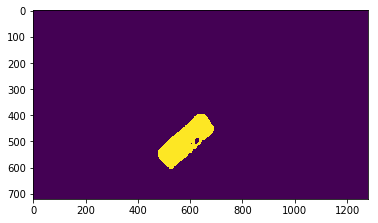

20872


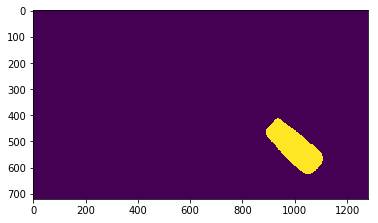

23069


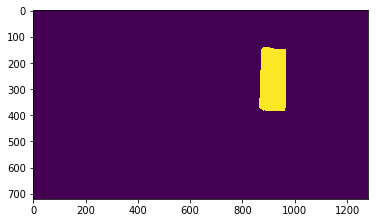

23123


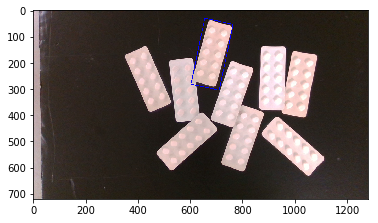

[[711 305]
 [603 282]
 [656  31]
 [764  54]]


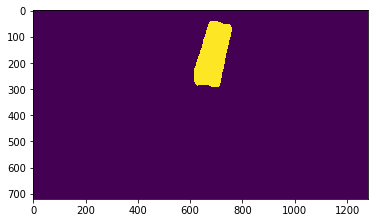

rotation 222
pose_xy: 683.5 168.0
-167.97772331381648
0.0113013   -0.2353788
18
Processing 1 images
image                    shape: (720, 1280, 3)        min:    1.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


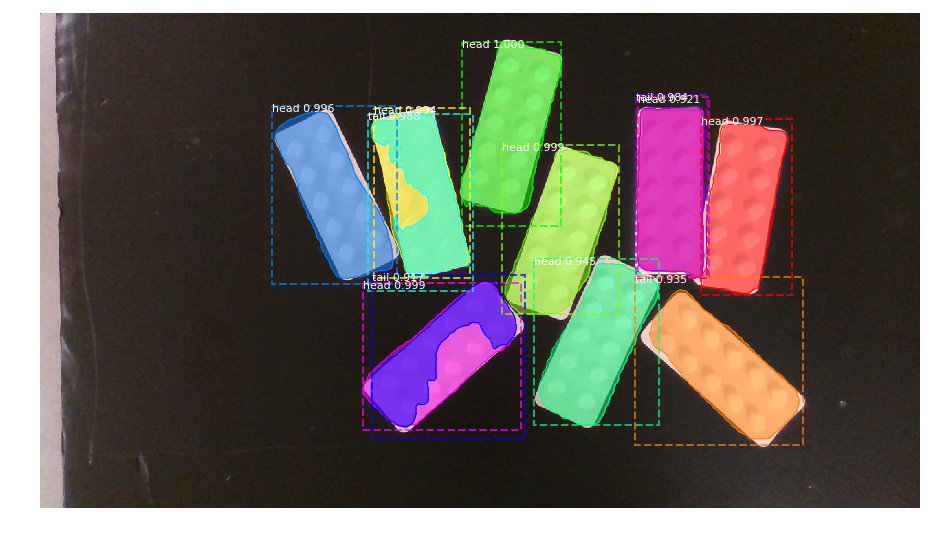

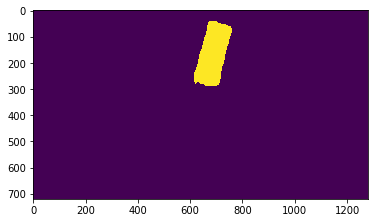

23096


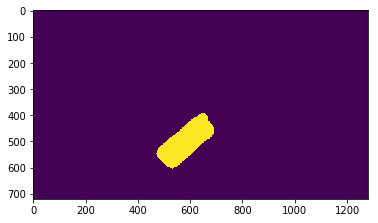

22690


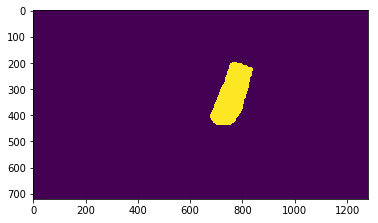

23222


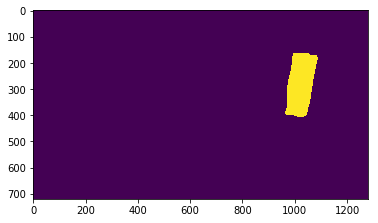

21825


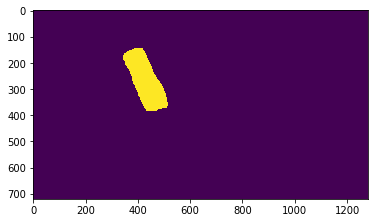

22057


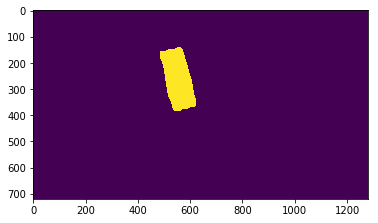

22068


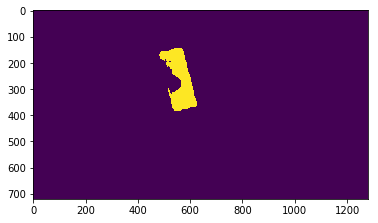

16912


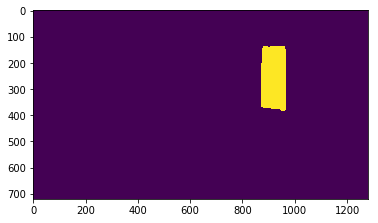

22295


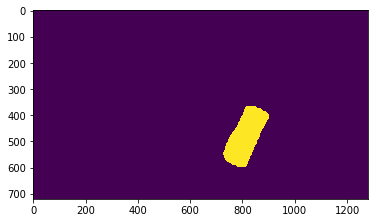

22748


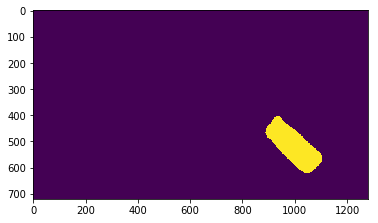

22703


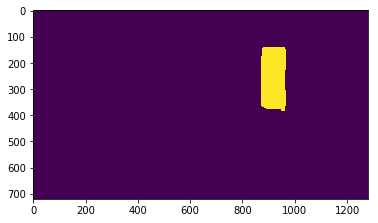

21886


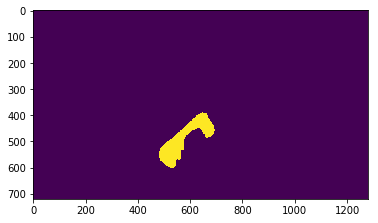

15149


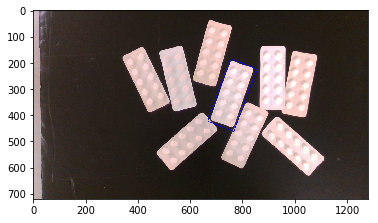

[[767 462]
 [667 423]
 [757 186]
 [857 225]]


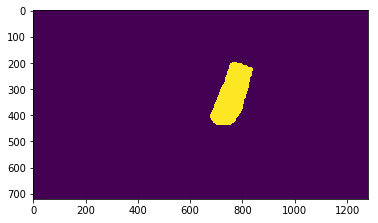

rotation 222
pose_xy: 762.0 324.0
-158.69421638217122
0.0316956   -0.19485
19
Processing 1 images
image                    shape: (720, 1280, 3)        min:    5.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


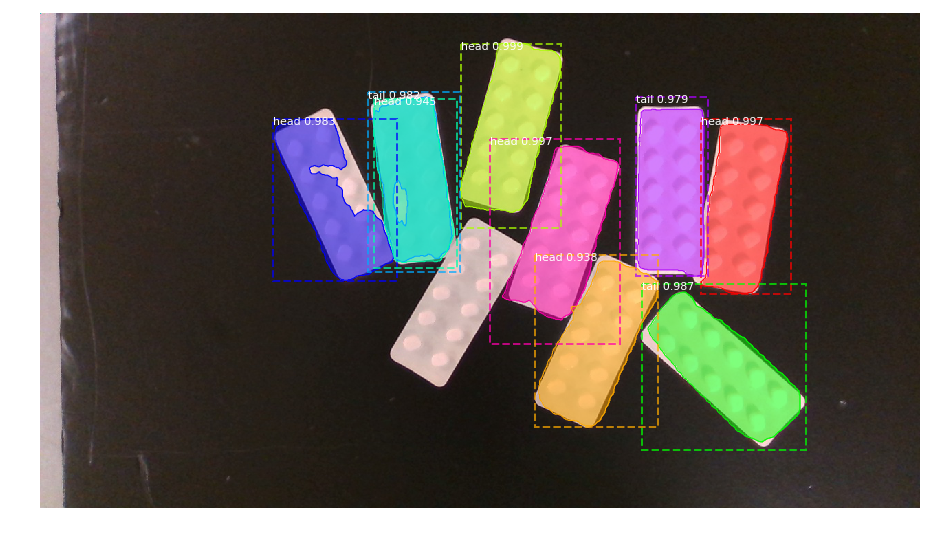

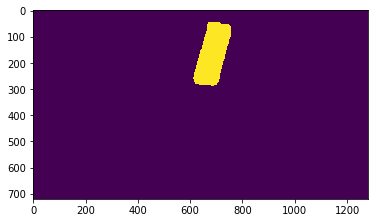

22942


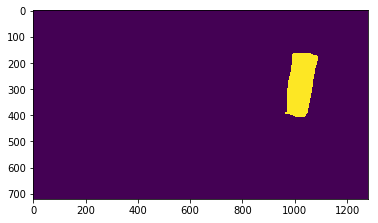

21896


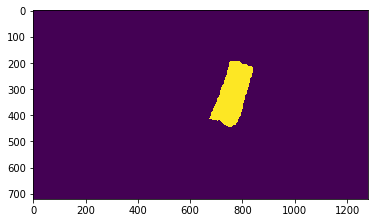

23614


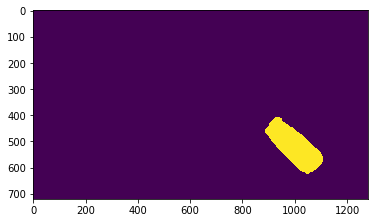

23329


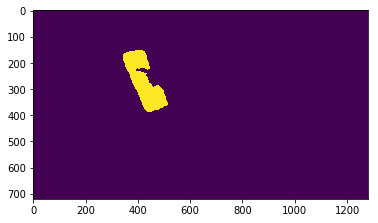

18883


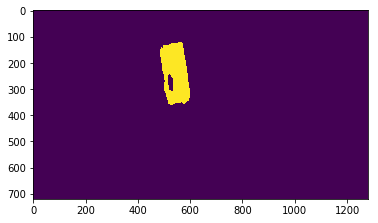

19734


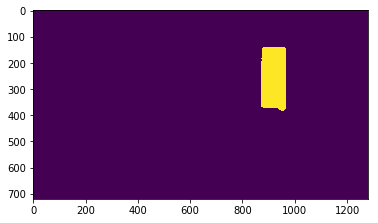

22158


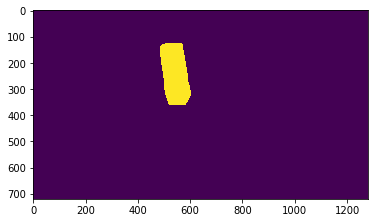

21579


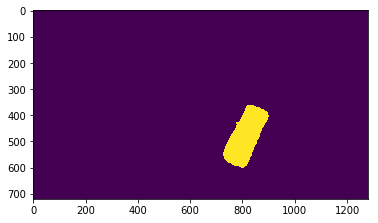

22986


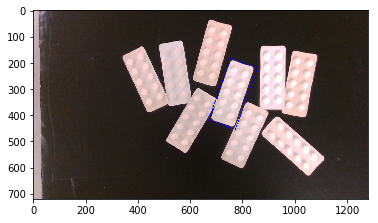

[[773 454]
 [671 417]
 [755 183]
 [858 220]]


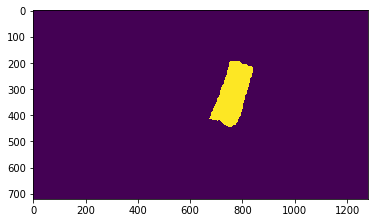

rotation 222
pose_xy: 764.0 318.5
-160.06200825579447
0.0322152   -0.1962789
20
Processing 1 images
image                    shape: (720, 1280, 3)        min:    4.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


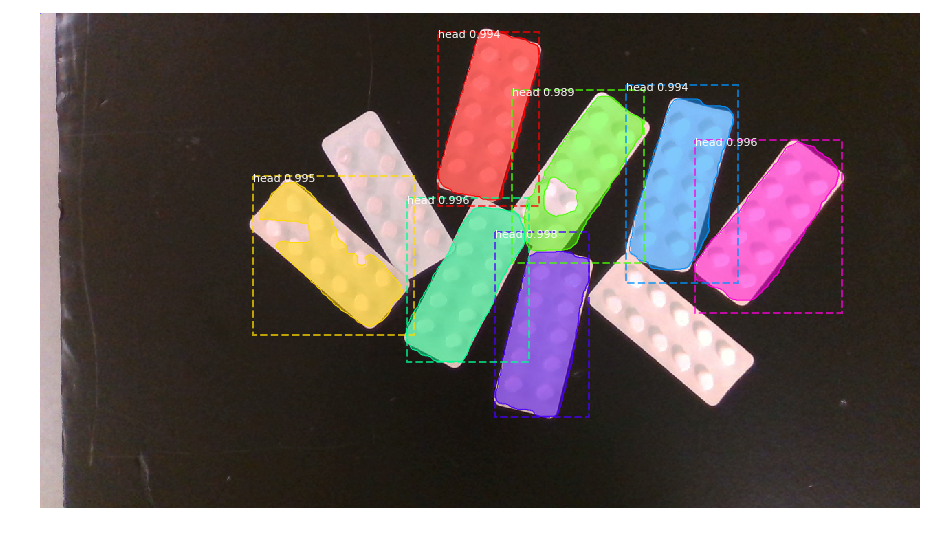

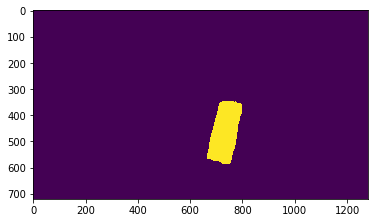

21970


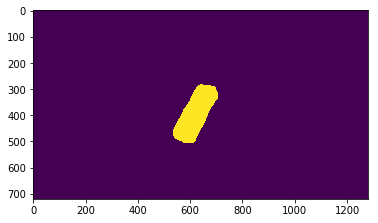

21098


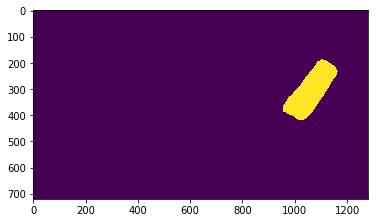

23337


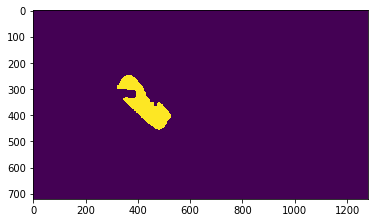

17087


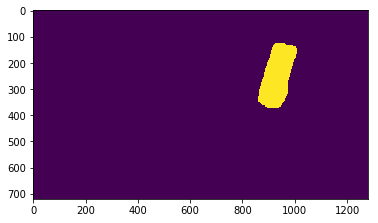

23811


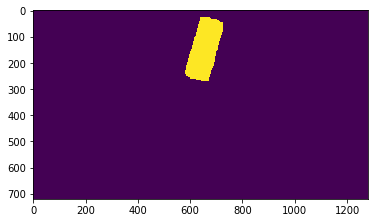

22755


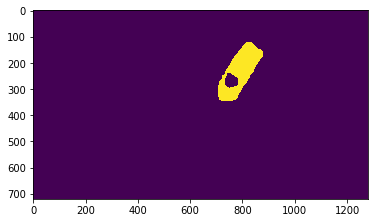

18246


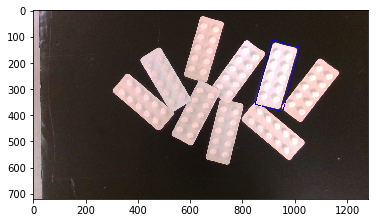

[[ 954  387]
 [ 848  358]
 [ 916  113]
 [1021  142]]


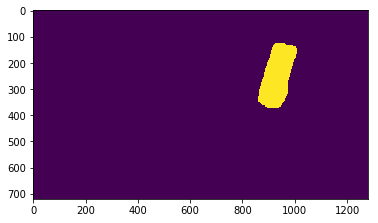

rotation 222
pose_xy: 935.0 250.0
-164.69915442754998
0.07664099999999999   -0.21407519999999997
21
Processing 1 images
image                    shape: (720, 1280, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


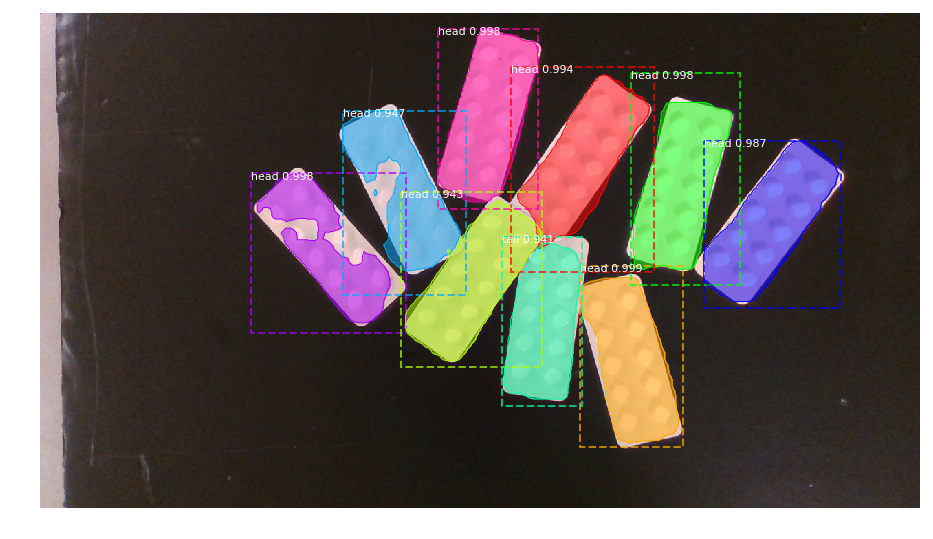

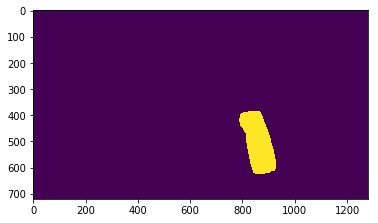

21934


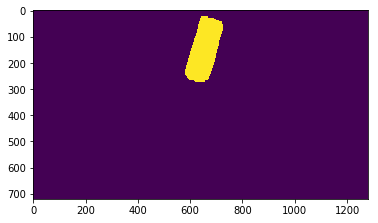

23161


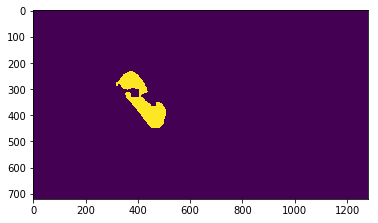

16025


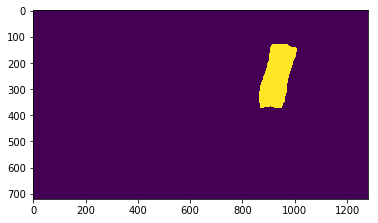

23472


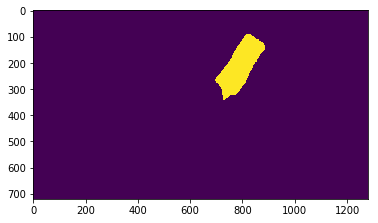

22224


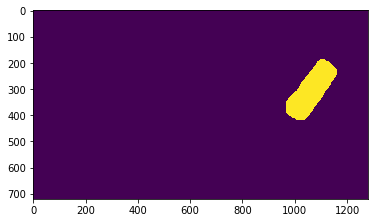

22990


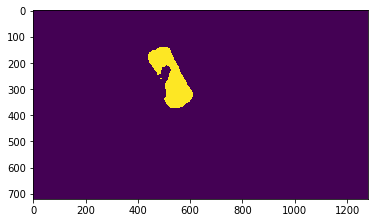

18920


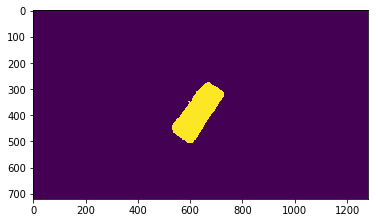

22512


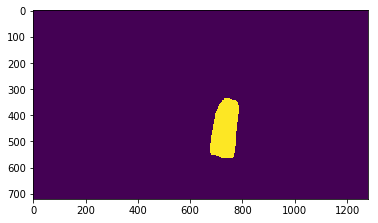

19359


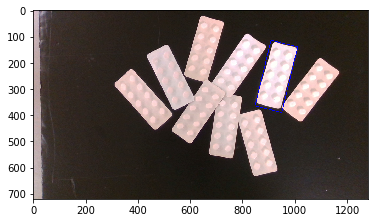

[[ 950  390]
 [ 848  365]
 [ 909  115]
 [1011  140]]


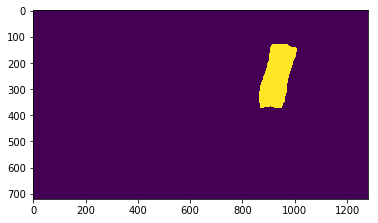

rotation 222
pose_xy: 929.5 252.5
-166.2284002829176
0.07521209999999999   -0.2134257
22
Processing 1 images
image                    shape: (720, 1280, 3)        min:    1.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


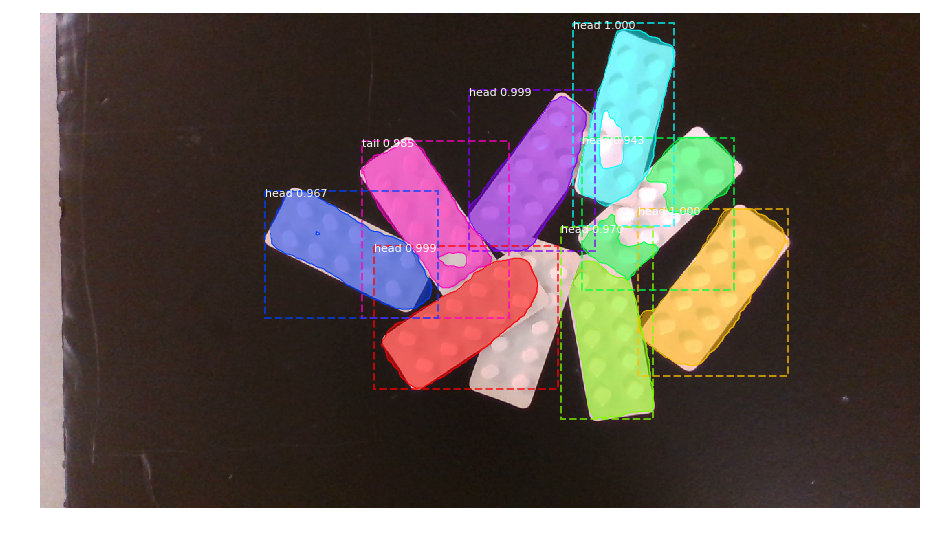

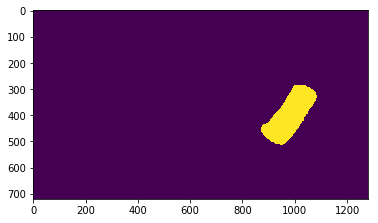

24543


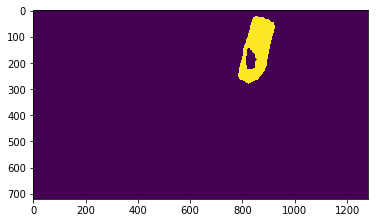

20255


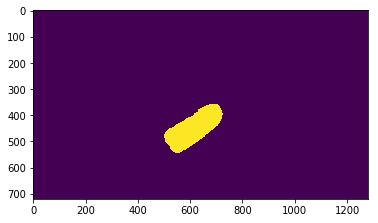

21741


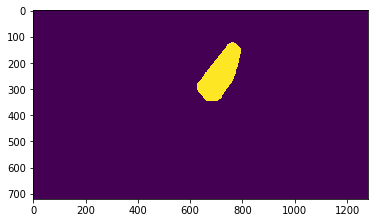

20677


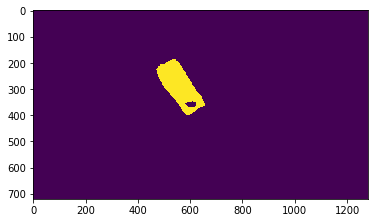

19008


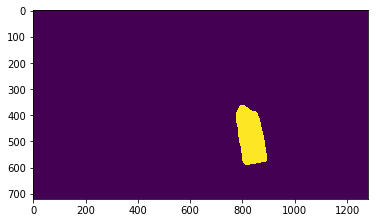

19478


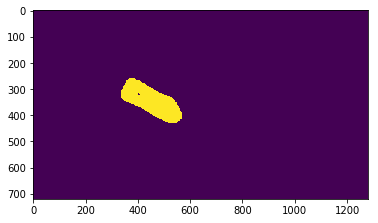

20895


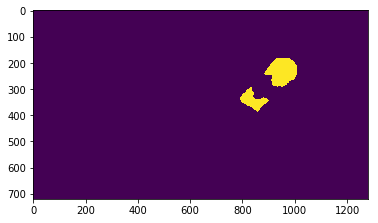

14305


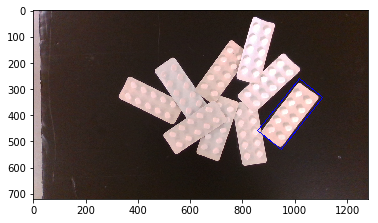

[[ 948  531]
 [ 858  459]
 [1018  261]
 [1107  333]]


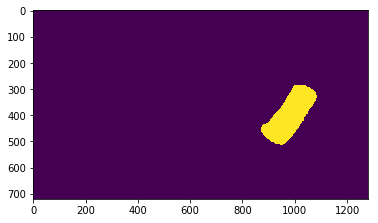

rotation 222
pose_xy: 983.0 396.0
-141.34019174590992
0.0891114   -0.1761444
23
Processing 1 images
image                    shape: (720, 1280, 3)        min:    3.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


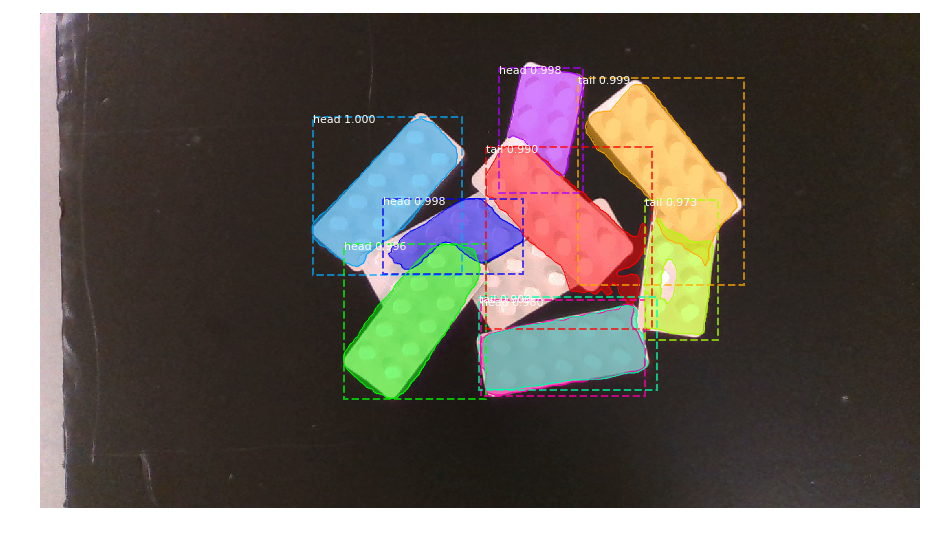

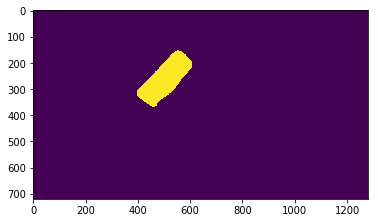

21543


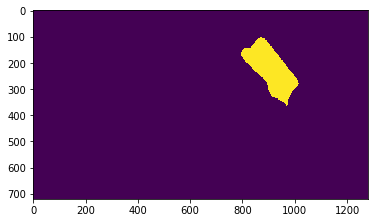

25966


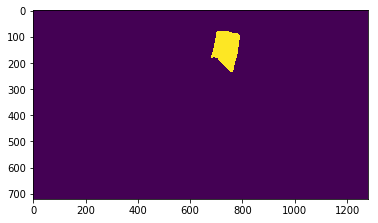

11631


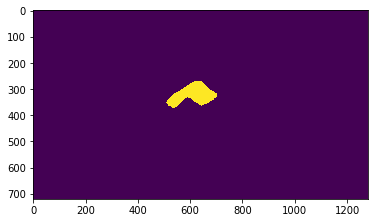

10566


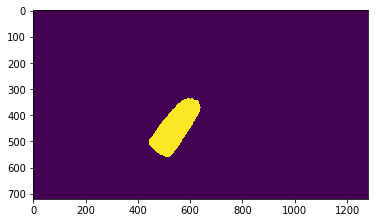

22974


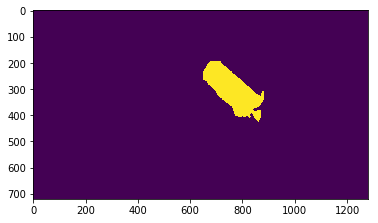

25755


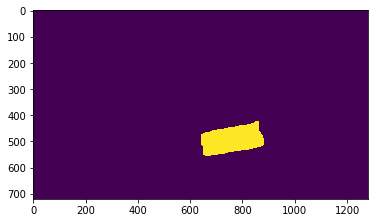

21514


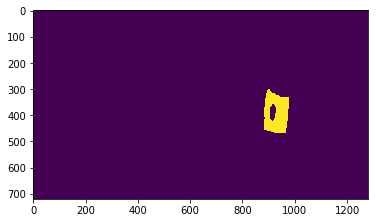

11766


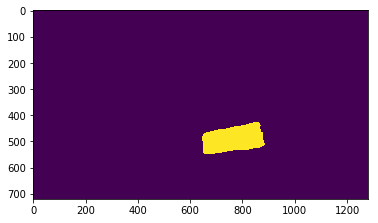

20803


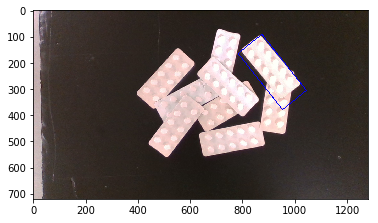

[[ 953  379]
 [ 783  165]
 [ 874   92]
 [1044  306]]


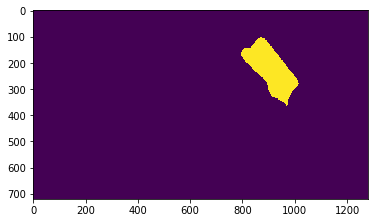

rotation 111
pose_xy: 913.5 235.5
-38.73650938566546
0.07105529999999999   -0.21784229999999996
24
Processing 1 images
image                    shape: (720, 1280, 3)        min:    5.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


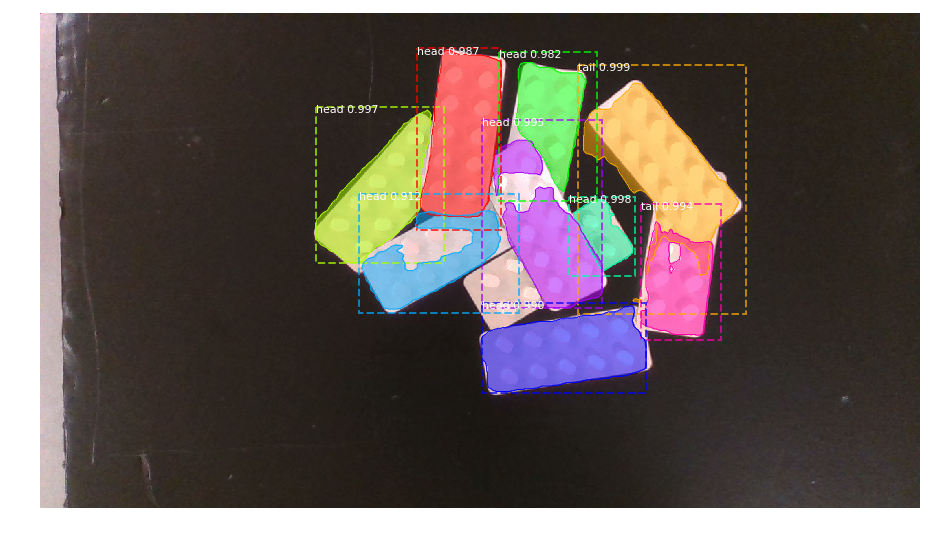

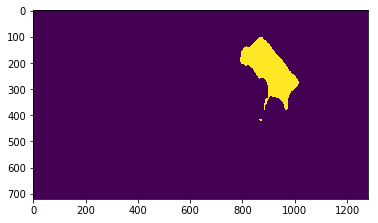

27634


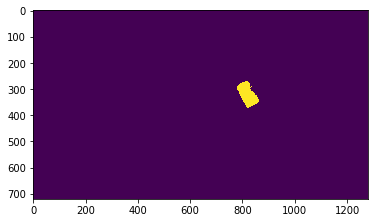

4855


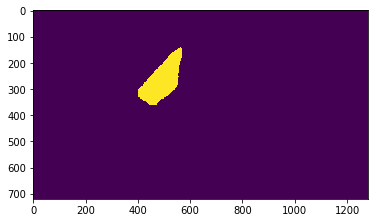

18643


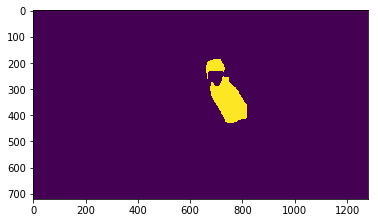

18392


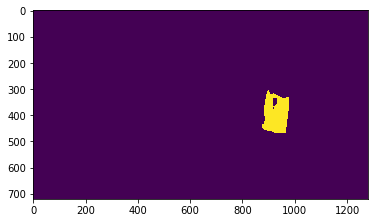

12257


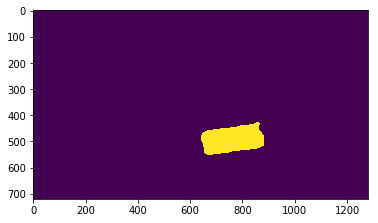

21411


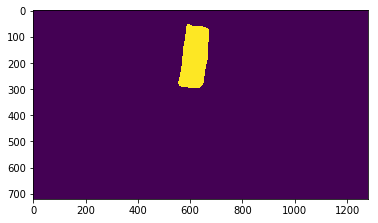

21749


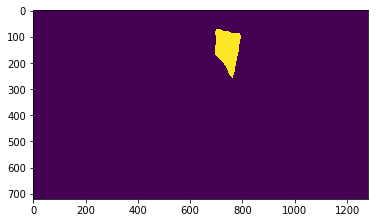

11946


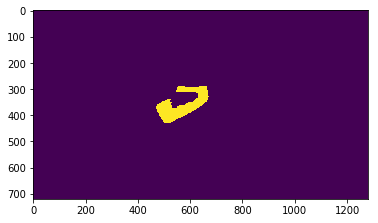

12756


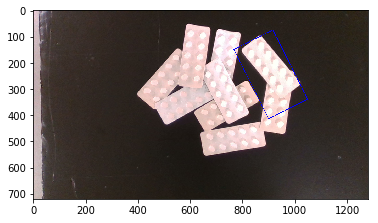

[[ 900  414]
 [ 767  150]
 [ 916   75]
 [1049  339]]


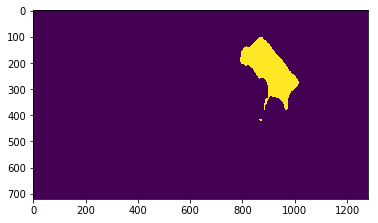

rotation 111
pose_xy: 908.0 244.5
-26.718658797027373
0.06962639999999999   -0.21550409999999998
25
Processing 1 images
image                    shape: (720, 1280, 3)        min:    3.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


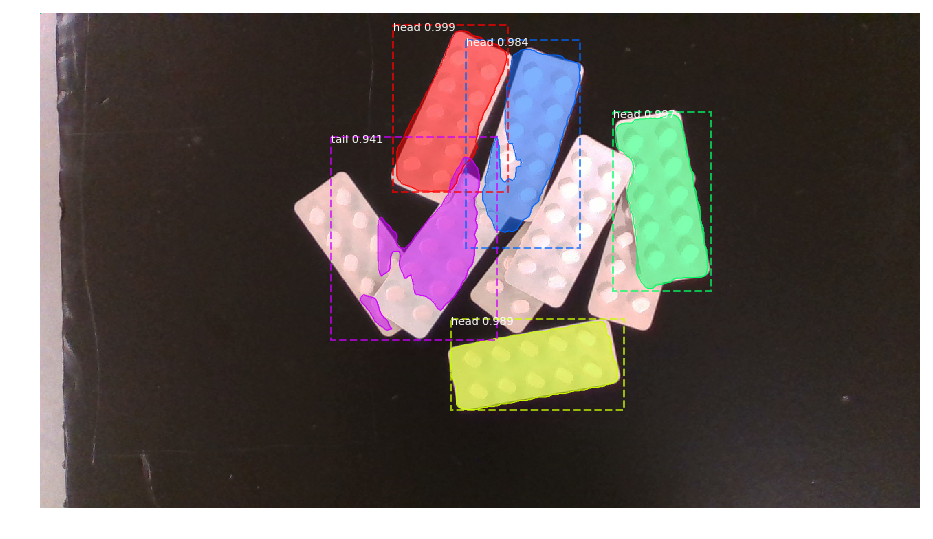

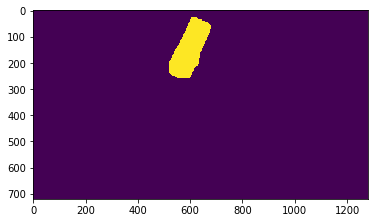

21244


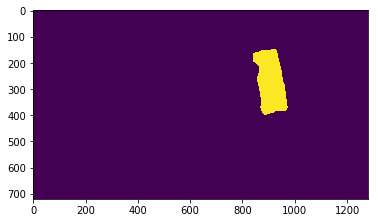

22747


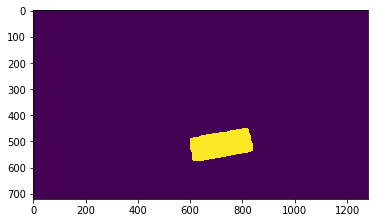

21975


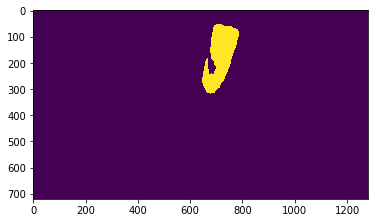

21025


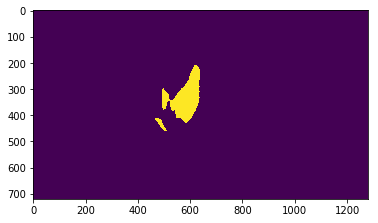

16290


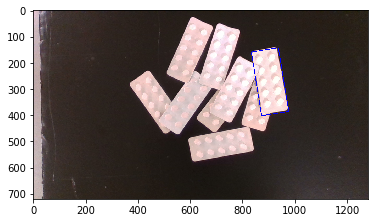

[[873 402]
 [834 160]
 [937 143]
 [977 386]]


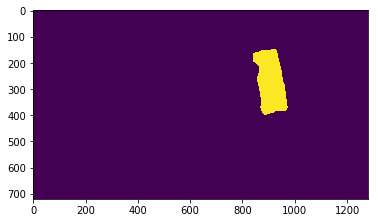

rotation 111
pose_xy: 905.0 272.5
-9.372092708579087
0.06884699999999999   -0.2082297
26
Processing 1 images
image                    shape: (720, 1280, 3)        min:    3.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 15)               min:    0.00000  max: 1280.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


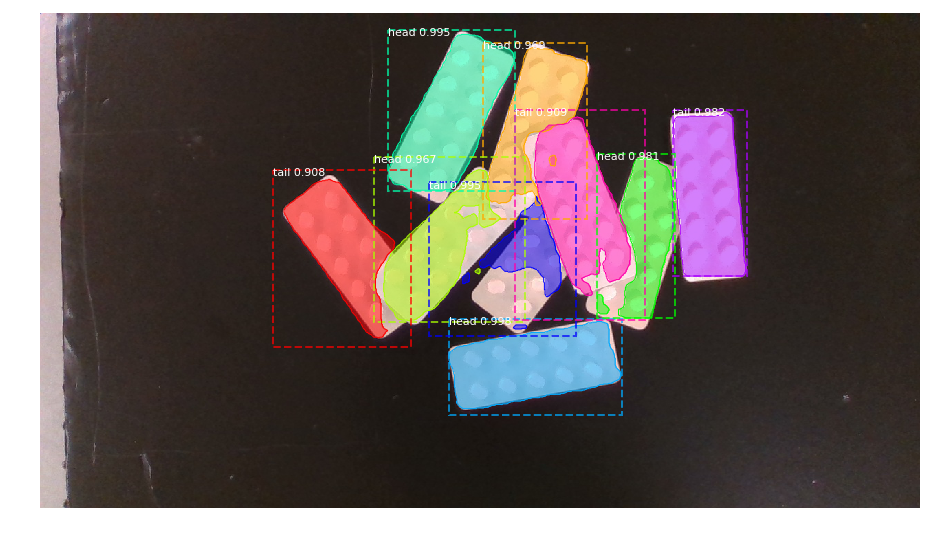

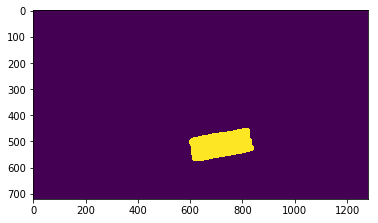

21820


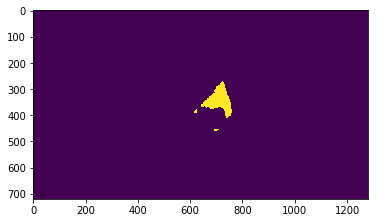

7586


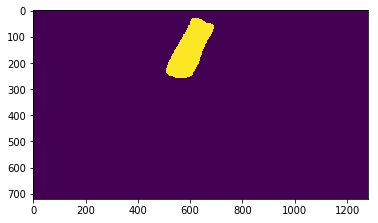

22655


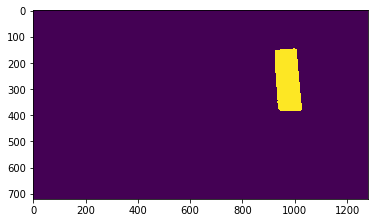

20807


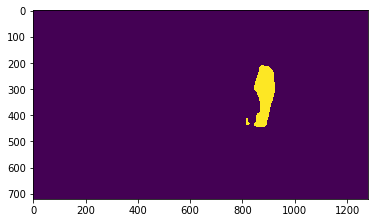

13058


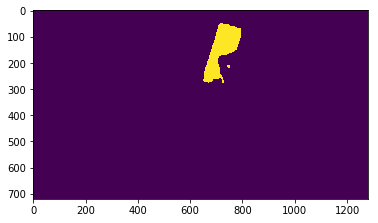

15941


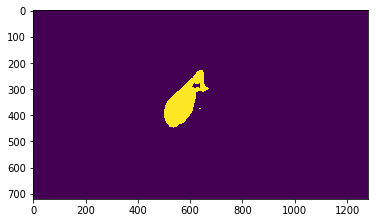

16769


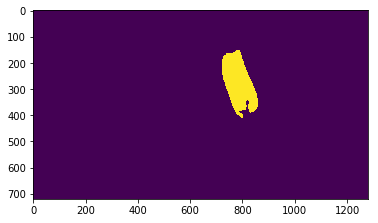

21431


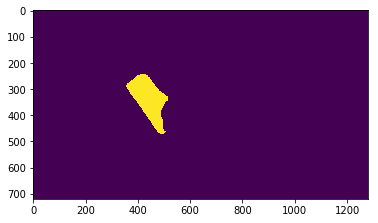

17743


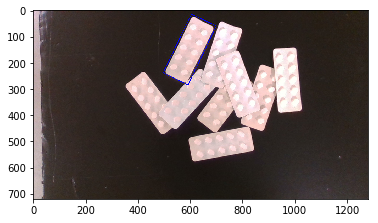

[[592 285]
 [497 239]
 [605  15]
 [700  60]]


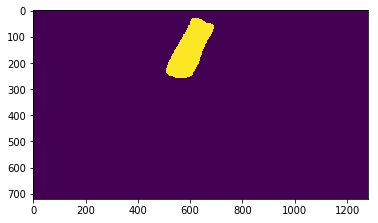

rotation 222
pose_xy: 598.5 150.0
-154.16324577599843
-0.0107817   -0.2400552


In [ ]:
# from camera calibration
cx = 640#1280
cy = 714.0+360#720

while(True):
    
    if(is_detect == 1):
        pose_pub = rospy.Publisher('/blister_pose', blister_pose, queue_size=10)
        # Load a the image
        #image = scipy.misc.imread('IMG_0393.JPG')
        image = scipy.misc.imread('/home/qxuaj/Desktop/carton_erecting/image/blister_img/'+ img_index +'.jpeg')

        # Run detection
        results = model.detect([image], verbose=1)
        
        # Visualize results
        r = results[0]
        visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], 
                            class_names, r['scores'])
        
        #img = cv2.imread('IMG_0393.JPG',0)
        img = cv2.imread('/home/qxuaj/Desktop/carton_perception/Mask_RCNN/tmp/blister_img/'+ img_index +'.jpeg',0)
        #print(mask_rank(img, r['masks']))
        mask_max, box_max = mask_rank(image, r['masks'])

        plt.imshow(mask_max)
        plt.show()
        
        pose = get_mask_pose(box_max)
        print('pose_xy:', pose['x'], pose['y'])
        print(pose['rz']*180/math.pi)
        
        blister_pose_msg = blister_pose()
        #blister_pose_msg.x = (pose['x'] - cx) / fx # transfer pixel position to camera frame coordinates
        #blister_pose_msg.y = (pose['y'] - cy) / fy
        blister_pose_msg.x = (pose['x'] - cx) * 0.2598 * 0.001 # 0.2423
        blister_pose_msg.y = (pose['y'] - cy) * 0.2598 * 0.001 #0.2423
        blister_pose_msg.angle = pose['rz']*180/math.pi
        pose_pub.publish(blister_pose_msg)
        print(blister_pose_msg.x, " ", blister_pose_msg.y)
        
        is_detect = 0

In [ ]:
is_detect = 0

In [ ]:
pose_xy: 647.5 137.5 
x: 640.1 631.9  -8.2

pose_xy: 632.0 365.5
x: 582.9 574.8 -8.0
    


In [18]:
1027 - 640 +7

387

In [19]:
174 - 640 -7

-466

In [15]:
1045 - 640 1.0

405

0


In [20]:
7.0 / 400

0.0175

In [24]:
 0.2423 + 0.0175

0.2598